In [34]:
from prepyto import *
import matplotlib.pyplot as plt
from tqdm import tqdm
from matplotlib.patches import ConnectionPatch
plt.rcParams.update({'font.size': 20})

In [2]:
pl = Pipeline('115')

Prepyto Pipeline: the pipeline is created for /Users/bzuber/microscopic_anatomy Dropbox/Benoit Zuber/temp_only_copies/115


In [3]:
pl.set_array('image')
pl.set_array('deep_labels')

'deep_labels'

In [4]:
vesicle_regions = pd.DataFrame(skimage.measure.regionprops_table(pl.deep_labels,properties=('centroid', 'label', 'bbox')))
bboxes = get_bboxes_from_regions(vesicle_regions)
centroids = get_centroids_from_regions(vesicle_regions)
labels = get_labels_from_regions(vesicle_regions)
thicknesses, densities, radii, centers, kept_labels = [],[],[],[],[]

In [44]:
shifts = []
delta_radii = []
for i in tqdm(range(len(labels))):
    label = labels[i]
    rounded_centroid = np.round(centroids[i]).astype(np.int)
    radius = get_label_largest_radius(bboxes[i])
    margin = 3
    _, _, new_centroid, new_optimal_radius, _ = get_sphere_parameters(pl.image, label, margin, radius, rounded_centroid)
    shift = new_centroid - rounded_centroid
    delta_radius = new_optimal_radius - radius
    shifts.append(shift)
    delta_radii.append(delta_radius)
shifts = np.array(shifts)
delta_radii = np.array(delta_radii)
distances = np.linalg.norm(shifts, axis=1)


100%|██████████| 181/181 [00:13<00:00, 13.10it/s]


distance: 6.09 ± 7.53
distance median : 3.16


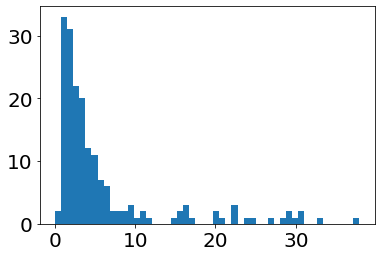

radial change: 3.17 ± 7.07
absoliute radial change media: 4.00


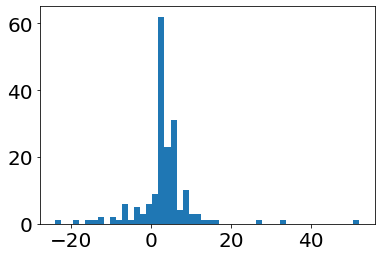

In [61]:
print(f"distance: {distances.mean():.2f} ± {distances.std():.2f}")
print(f"distance median : {np.median(distances):.2f}")
_= plt.hist(distances, bins=50)
plt.show()
print(f"radial change: {delta_radii.mean():.2f} ± {delta_radii.std():.2f}")
print(f"absoliute radial change media: {np.median(np.abs(delta_radii)):.2f}")
_ = plt.hist(delta_radii, bins=50)

In [52]:
def make_figure(i, savefig=False):
    fontsize = 32
    margin = 3
    radius = get_label_largest_radius(bboxes[i])  #this is an integer
    rounded_centroid = np.round(centroids[i]).astype(np.int) #this is an array of integers
    label = labels[i]
    image_box = extract_box_of_radius(pl.image, rounded_centroid, radius + margin)
    origin = None
    radial_profile = get_radial_profile(image_box, origin)
    i_membrane_center, _ = get_sphere_membrane_center_and_density_from_radial_profile(radial_profile)
    i_upper_limit = get_radial_profile_i_upper_limit(radial_profile)
    i_membrane_outer_halo = i_membrane_center + radial_profile[i_membrane_center:i_upper_limit].argmax()
    derivative2 = np.diff(radial_profile,2)
    filtered_derivative2 = ndimage.gaussian_filter1d(derivative2,1)
    optimal_radius = -1 + i_membrane_center + ndimage.gaussian_filter1d(derivative2[i_membrane_center:i_membrane_outer_halo+1],1).argmin()
    average_image = get_3d_radial_average(image_box, origin)
    _, _, new_centroid, new_optimal_radius, _ = get_sphere_parameters(pl.image, label, margin, radius, rounded_centroid)
    new_optimal_radius = new_optimal_radius - 1 
    shift = new_centroid - rounded_centroid
    new_image_box = extract_box_of_radius(pl.image, new_centroid, new_optimal_radius + margin+1)
    print(f"new image box shape is {new_image_box.shape}")
    print(f"new centroid is {new_centroid}")
    new_radial_profile = get_radial_profile(new_image_box,origin)
    new_average_image = get_3d_radial_average(new_image_box, origin)
    new_i_membrane_center, _ = get_sphere_membrane_center_and_density_from_radial_profile(new_radial_profile)
    new_i_upper_limit = get_radial_profile_i_upper_limit(new_radial_profile)
    new_i_membrane_outer_halo = new_i_membrane_center + new_radial_profile[new_i_membrane_center:new_i_upper_limit].argmax()
    new_derivative2 = np.diff(new_radial_profile,2)
    new_filtered_derivative2 = ndimage.gaussian_filter1d(new_derivative2,1)
    print(f"new_optimal_radius is {new_optimal_radius}")
    print(f"alternative calc: {-1 + new_i_membrane_center + new_filtered_derivative2[i_membrane_center:i_membrane_outer_halo+1].argmin()}")
    
    nx = 4
    ny = 2
    dxs = 8
    dys = 6
    theta = np.linspace(0, 2*np.pi, 100)
    xcircle = optimal_radius * np.cos(theta)
    ycircle = optimal_radius * np.sin(theta)
    new_xcircle = new_optimal_radius * np.cos(theta)
    new_ycircle = new_optimal_radius * np.sin(theta)
    
    fig, ax = plt.subplots(nrows=ny,ncols=nx, figsize=(nx*dxs,ny*dys), facecolor='white')
    #fig.subplots_adjust(hspace=0.5)
    #fig.suptitle(f"i = {i},   shift = {shift},  radius difference = {new_optimal_radius - optimal_radius}, avg min,max = {average_image.min():.2f}, {average_image.max():.2f} ,  new_avg min,max = {new_average_image.min():.2f}, {new_average_image.max():.2f}")
    
    ax[0,1].plot(radial_profile)
    ax[0,1].set_xlabel('radius [pixel]')
    ax[0,1].set_ylabel('intensity')
    ylim = ax[0,1].get_ylim()
    ax[0,1].fill_between((i_membrane_center,i_membrane_outer_halo), ylim[0], ylim[1], alpha=0.2)
    ax[0,1].vlines(optimal_radius, ylim[0], ylim[1],color='red')
    ax[0,1].set_ylim(ylim)
    
    ax[0,2].plot(filtered_derivative2)
    ax[0,2].set_xlabel('radius [pixel]')
    ax[0,2].set_ylabel(r'$\frac{\partial^2 intensity}{\partial radius^2}$', fontsize=28)
    ylim = ax[0,2].get_ylim()
    ax[0,2].fill_between((i_membrane_center,i_membrane_outer_halo), ylim[0], ylim[1], alpha=0.2)
    ax[0,2].vlines(optimal_radius, ylim[0], ylim[1],color='red')
    ax[0,2].set_ylim(ylim)
    ax[0,2].set_xlim(ax[0,1].get_xlim())
    
    ax[1,1].plot(new_radial_profile)
    ax[1,1].set_xlabel('radius [pixel]')
    ax[1,1].set_ylabel('intensity')
    ylim = ax[1,1].get_ylim()
    ax[1,1].fill_between((new_i_membrane_center,new_i_membrane_outer_halo), ylim[0], ylim[1], alpha=0.2)
    ax[1,1].vlines(new_optimal_radius,ylim[0], ylim[1],color='red')
    ax[1,1].set_ylim(ylim)
    ax[1,1].set_xlim(ax[0,1].get_xlim())
    
    ax[1,2].set_xlabel('radius [pixel]')
    ax[1,2].set_ylabel(r'$\frac{\partial^2 intensity}{\partial radius^2}$', fontsize=28)
    ax[1,2].plot(new_filtered_derivative2)
    ylim = ax[1,2].get_ylim()
    ax[1,2].fill_between((new_i_membrane_center,new_i_membrane_outer_halo), ylim[0], ylim[1], alpha=0.2)
    ax[1,2].vlines(new_optimal_radius, ylim[0], ylim[1],color='red')
    ax[1,2].set_ylim(ylim)
    ax[1,2].set_xlim(ax[0,1].get_xlim())

    imgplt00 = ax[0,0].imshow(image_box[image_box.shape[0]//2])
    ax[0,0].set_xlabel('x-coordinate [pixel]')
    ax[0,0].set_ylabel('y-coordinate [pixel]')
    imgplt00.set_cmap('gray')
    xlim, ylim = (ax[0,0].get_xlim(), ax[0,0].get_ylim())
    ax[0,0].plot(xcircle+image_box.shape[1]//2, ycircle+image_box.shape[2]//2, color='red')
    ax[0,0].set_xlim(xlim)
    ax[0,0].set_ylim(ylim)
    
    imgplt01 = ax[0,3].imshow(-average_image[image_box.shape[0]//2])
    ax[0,3].set_xlabel('x-coordinate [pixel]')
    ax[0,3].set_ylabel('y-coordinate [pixel]')
    imgplt01.set_cmap('copper')
    xlim, ylim = (ax[0,3].get_xlim(), ax[0,3].get_ylim())
    ax[0,3].plot(xcircle+image_box.shape[1]//2, ycircle+image_box.shape[2]//2, color='red')
    ax[0,3].set_xlim(xlim)
    ax[0,3].set_ylim(ylim)
    
    imgplt10 = ax[1,0].imshow(new_image_box[new_image_box.shape[0]//2])
    ax[1,0].set_xlabel('x-coordinate [pixel]')
    ax[1,0].set_ylabel('y-coordinate [pixel]')
    imgplt10.set_cmap('gray')
    xlim, ylim = (ax[1,0].get_xlim(), ax[1,0].get_ylim())
    ax[1,0].plot(new_xcircle+new_image_box.shape[1]//2, new_ycircle+new_image_box.shape[2]//2, color='red')
    ax[1,0].set_xlim(xlim)
    ax[1,0].set_ylim(ylim)

    imgplt11 = ax[1,3].imshow(-new_average_image[new_image_box.shape[0]//2])
    ax[1,3].set_xlabel('x-coordinate [pixel]')
    ax[1,3].set_ylabel('y-coordinate [pixel]')
    imgplt11.set_cmap('copper')
    xlim, ylim = (ax[1,3].get_xlim(), ax[1,0].get_ylim())
    ax[1,3].plot(new_xcircle+new_image_box.shape[1]//2, new_ycircle+new_image_box.shape[2]//2, color='red')
    ax[1,3].set_xlim(xlim)
    ax[1,3].set_ylim(ylim)   

    ax[0,0].text(0.05, 0.95, "A", transform=ax[0,0].transAxes,fontsize=fontsize, fontweight='bold', va='top')
    ax[0,1].text(0.05, 0.95, "B", transform=ax[0,1].transAxes,fontsize=fontsize, fontweight='bold', va='top')
    ax[0,2].text(0.05, 0.95, "C", transform=ax[0,2].transAxes,fontsize=fontsize, fontweight='bold', va='top')
    ax[0,3].text(0.05, 0.95, "D", transform=ax[0,3].transAxes,fontsize=fontsize, fontweight='bold', va='top', color='white')
    ax[1,0].text(0.05, 0.95, "E", transform=ax[1,0].transAxes,fontsize=fontsize, fontweight='bold', va='top')
    ax[1,1].text(0.05, 0.95, "F", transform=ax[1,1].transAxes,fontsize=fontsize, fontweight='bold', va='top')
    ax[1,2].text(0.05, 0.95, "G", transform=ax[1,2].transAxes,fontsize=fontsize, fontweight='bold', va='top')
    ax[1,3].text(0.05, 0.95, "H", transform=ax[1,3].transAxes,fontsize=fontsize, fontweight='bold', va='top', color='white')
    
    fig.tight_layout(h_pad=7.5)
    
    ax[0,0].annotate(f"Initial radius = {radius}. Radius after inital radial profile = {optimal_radius}.\nShift [z x y] = {shift}\nFinal radius = {new_optimal_radius}", (1.1,-0.48), xycoords='axes fraction', annotation_clip=False, fontsize=24)
    
    xyA = (1, -.2)
    xyB = (1, 1.2)
    coordsA = "axes fraction"
    coordsB = "axes fraction"
    con = ConnectionPatch(xyA=xyA, xyB=xyB, coordsA=coordsA, coordsB=coordsB,
                      axesA=ax[0,0], axesB=ax[1,0],
                      arrowstyle="Simple, head_length=2, head_width=2",
                    facecolor="white", linewidth=3)
    ax[0,0].add_artist(con)
    print(f"i is {i}")
    if savefig:
        plt.savefig(f'fig{i:03d}.svg')
    else:
        plt.show()
          
          

new image box shape is (42, 42, 42)
new centroid is [ 31 379 458]
new_optimal_radius is 17
alternative calc: 17
i is 13


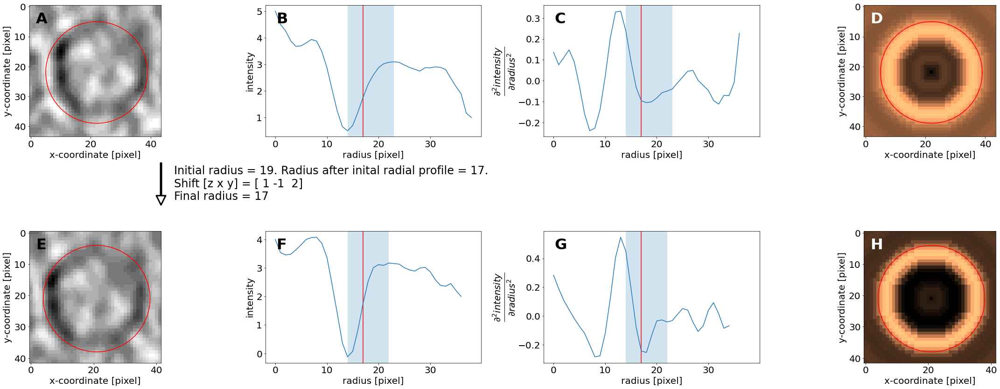

In [30]:
#i = next(i_s)
#print(f"i = {i}")
make_figure(13, False)

new image box shape is (46, 46, 46)
new centroid is [192 337 530]
new_optimal_radius is 19
alternative calc: 20
i is 162
new image box shape is (44, 44, 44)
new centroid is [182 204 610]
new_optimal_radius is 18
alternative calc: 17
i is 152
new image box shape is (50, 50, 50)
new centroid is [169 479 518]
new_optimal_radius is 21
alternative calc: 23
i is 144
new image box shape is (46, 46, 46)
new centroid is [158 362 574]
new_optimal_radius is 19
alternative calc: 18
i is 139
new image box shape is (46, 46, 46)
new centroid is [139 367 492]
new_optimal_radius is 19
alternative calc: 19
i is 118
new image box shape is (40, 40, 40)
new centroid is [120 462 295]
new_optimal_radius is 16
alternative calc: 16
i is 99


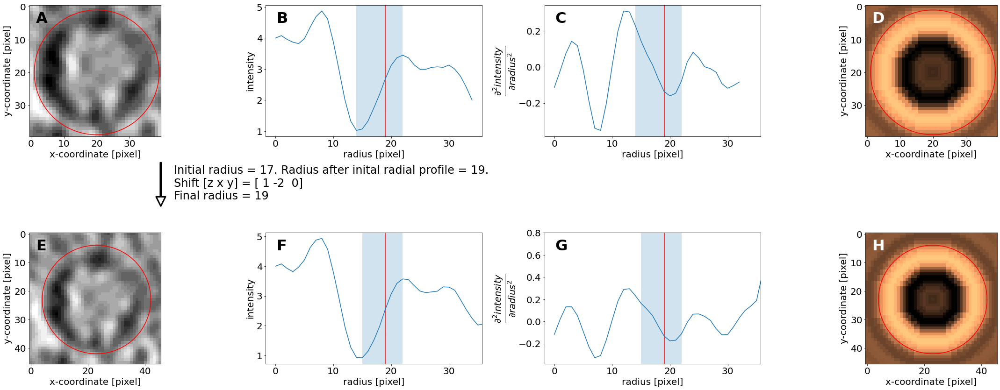

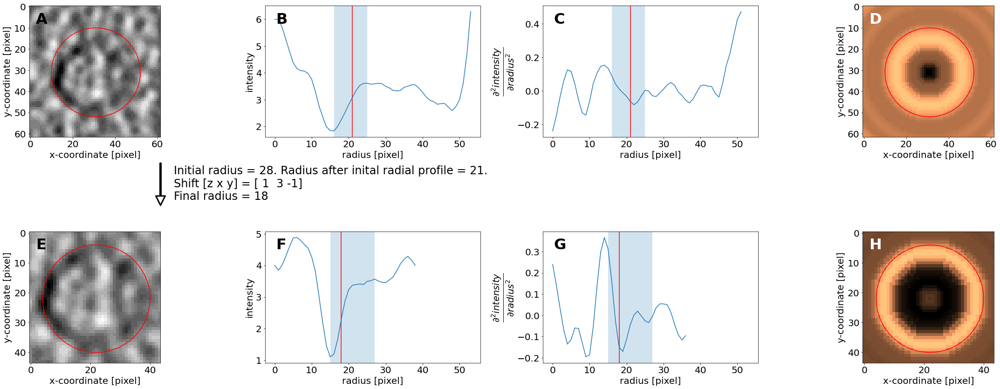

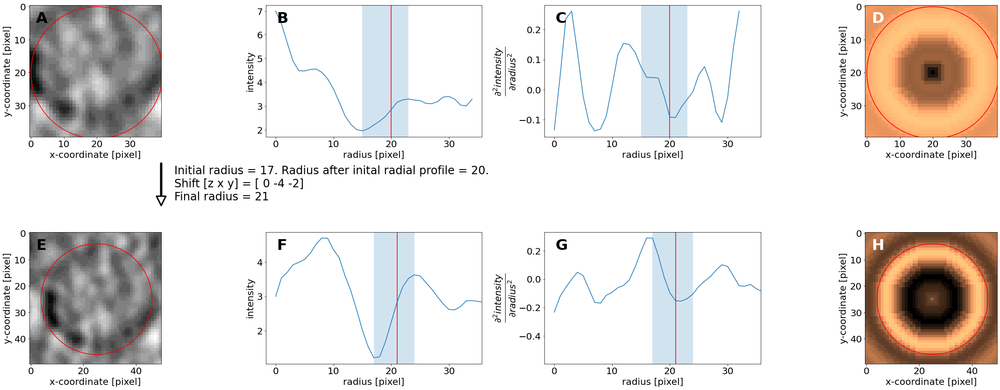

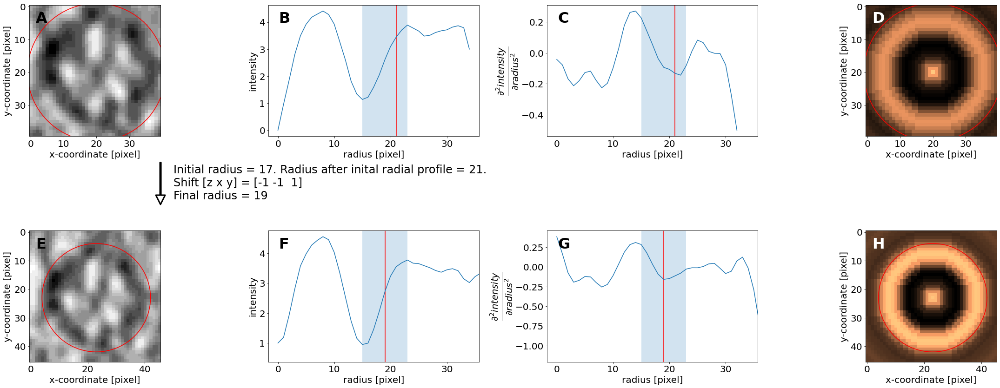

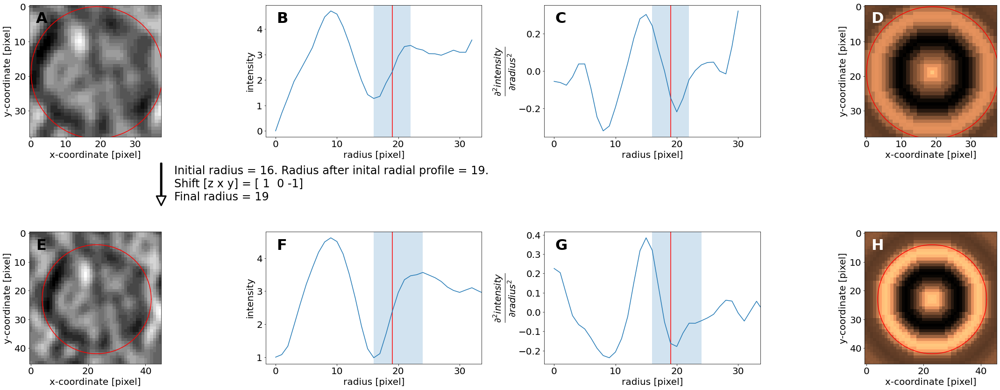

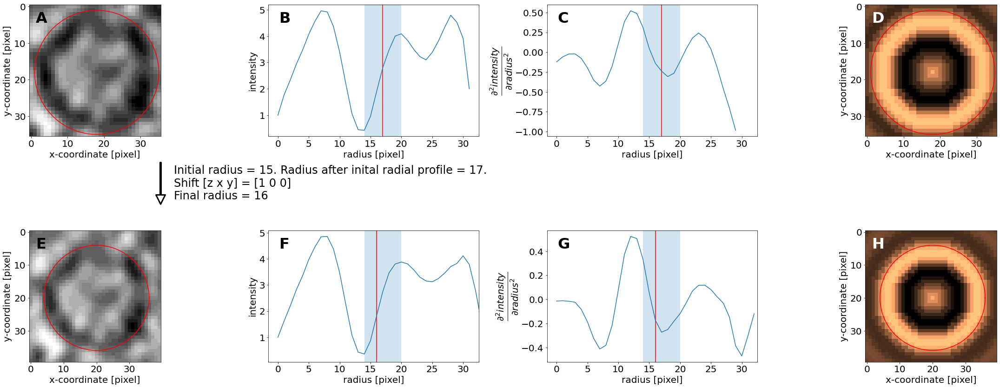

In [62]:
for i in (162,152,144,139,118,99):
    make_figure(i, savefig=True)

new image box shape is (44, 44, 44)
new centroid is [ 22  95 574]
new_optimal_radius is 24
alternative calc: 24
i is 0


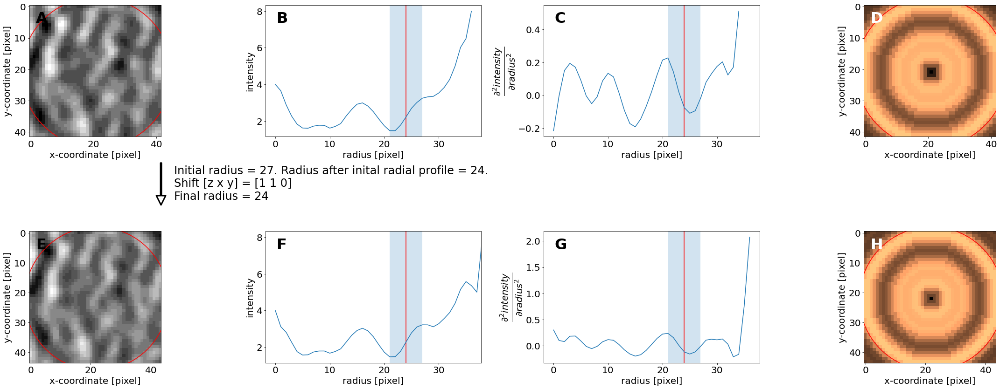

new image box shape is (32, 32, 32)
new centroid is [ 16 261 544]
new_optimal_radius is 18
alternative calc: 22
i is 1


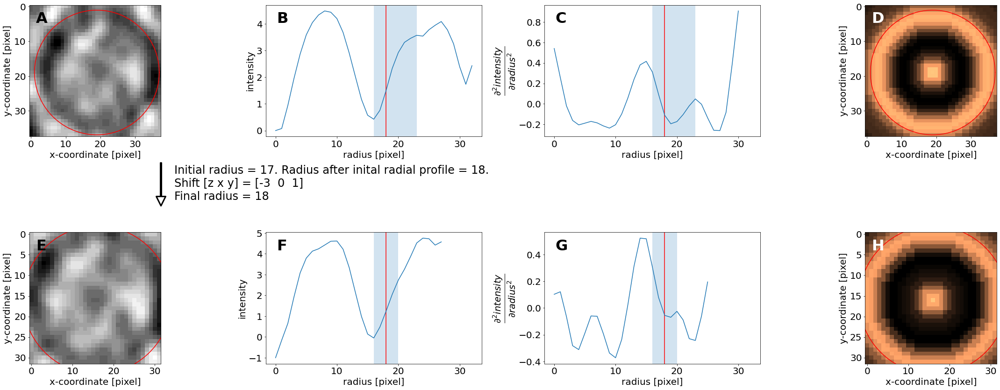

new image box shape is (32, 32, 32)
new centroid is [ 16 279 509]
new_optimal_radius is 18
alternative calc: 18
i is 2


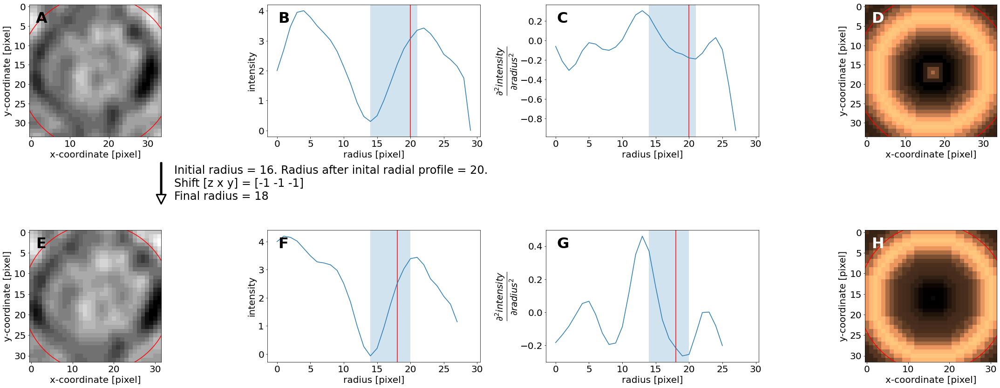

new image box shape is (46, 46, 46)
new centroid is [ 24 342 531]
new_optimal_radius is 19
alternative calc: 19
i is 3


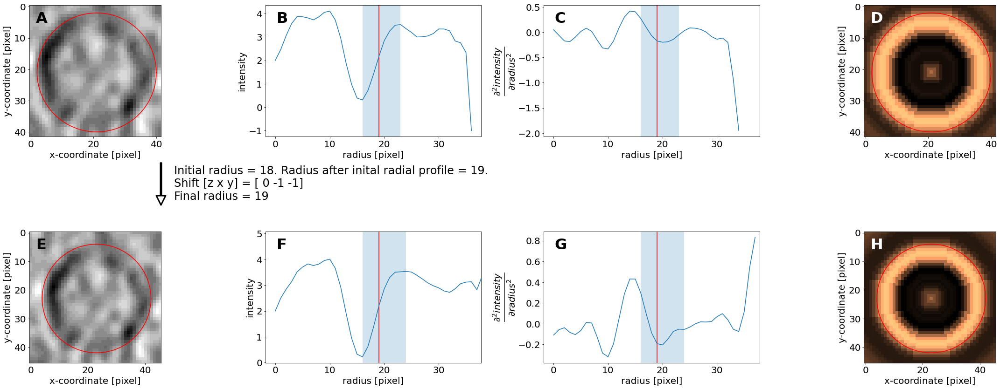

new image box shape is (30, 30, 30)
new centroid is [ 15 370 318]
new_optimal_radius is 16
alternative calc: 16
i is 4


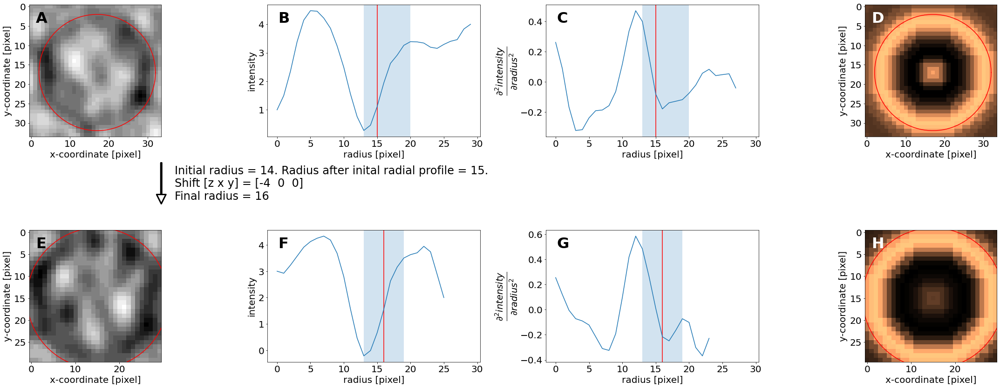

new image box shape is (66, 66, 66)
new centroid is [ 33 412 360]
new_optimal_radius is 35
alternative calc: 36
i is 5


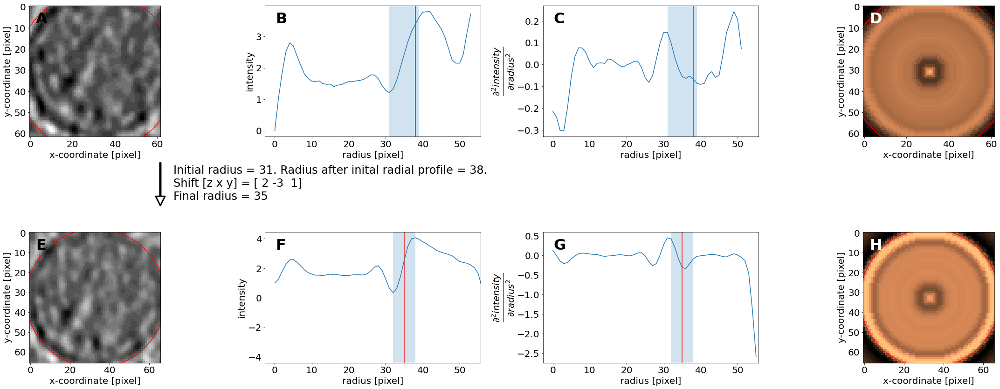

new image box shape is (14, 14, 14)
new centroid is [ 23 521 392]
new_optimal_radius is 3
alternative calc: 2
i is 6


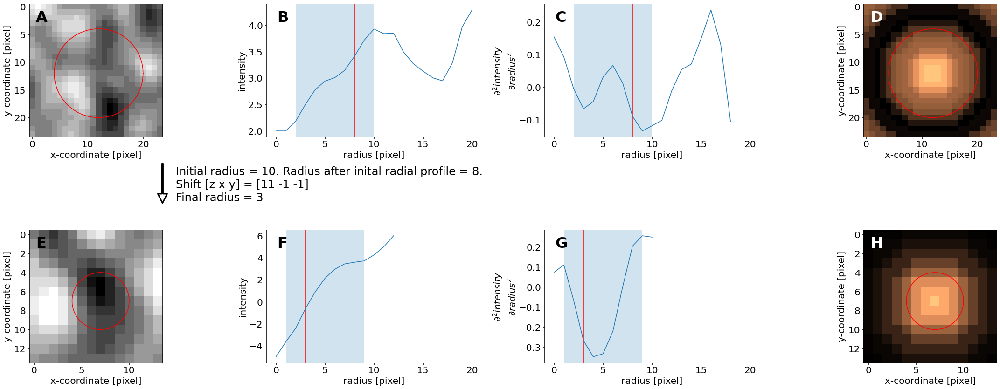

new image box shape is (60, 60, 60)
new centroid is [ 40 343 428]
new_optimal_radius is 26
alternative calc: 34
i is 7


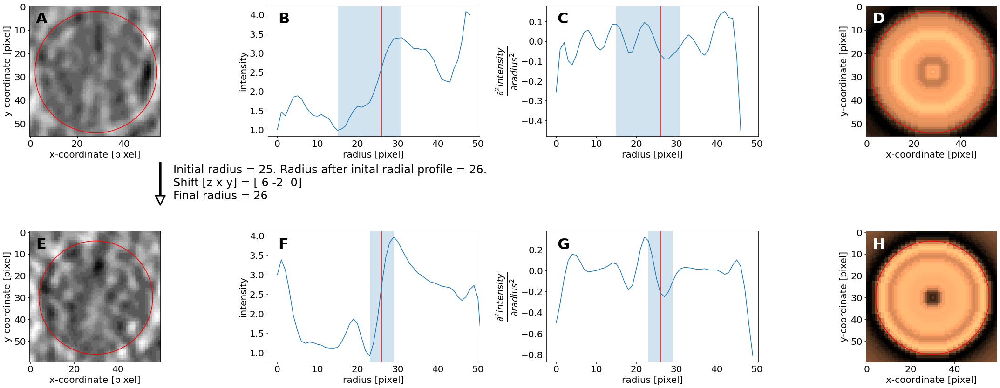

new image box shape is (30, 30, 30)
new centroid is [ 15 450 404]
new_optimal_radius is 18
alternative calc: 8
i is 8


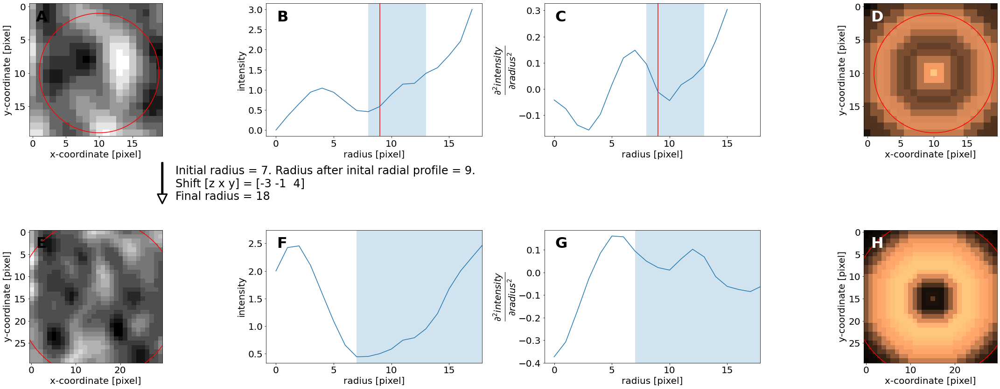

new image box shape is (46, 46, 46)
new centroid is [ 27 496 256]
new_optimal_radius is 19
alternative calc: 20
i is 9


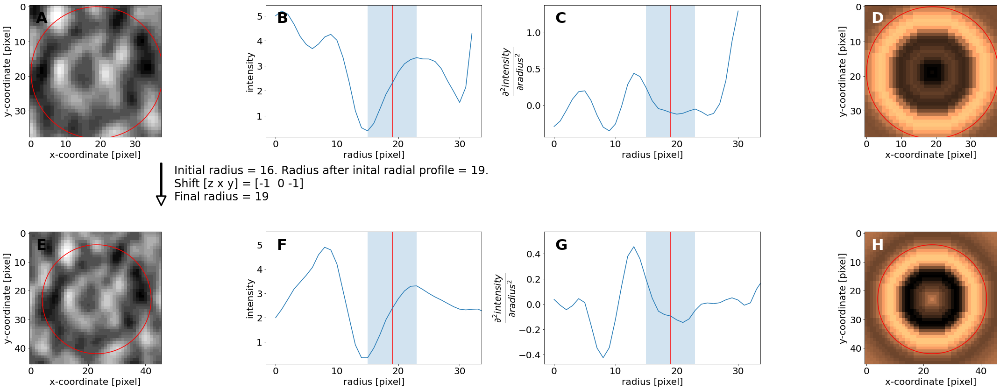

new image box shape is (16, 16, 16)
new centroid is [ 21 280 409]
new_optimal_radius is 4
missed 10
new image box shape is (42, 42, 42)
new centroid is [ 30 285 577]
new_optimal_radius is 17
alternative calc: 17
i is 11


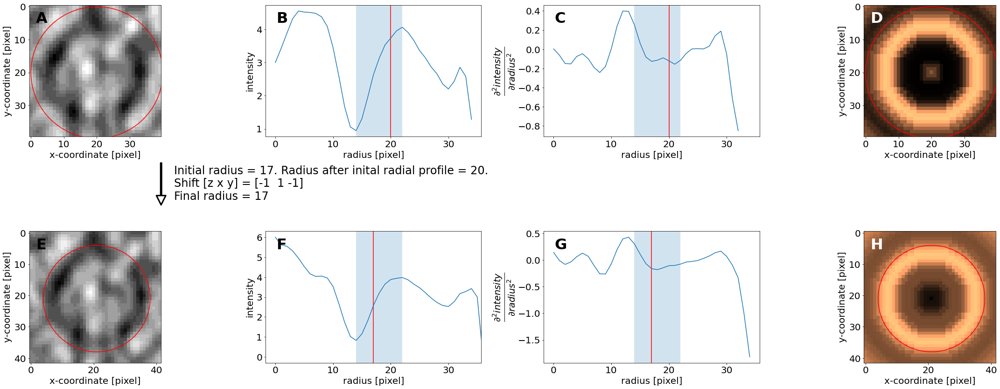

new image box shape is (40, 40, 40)
new centroid is [ 22 186 580]
new_optimal_radius is 16
alternative calc: 16
i is 12


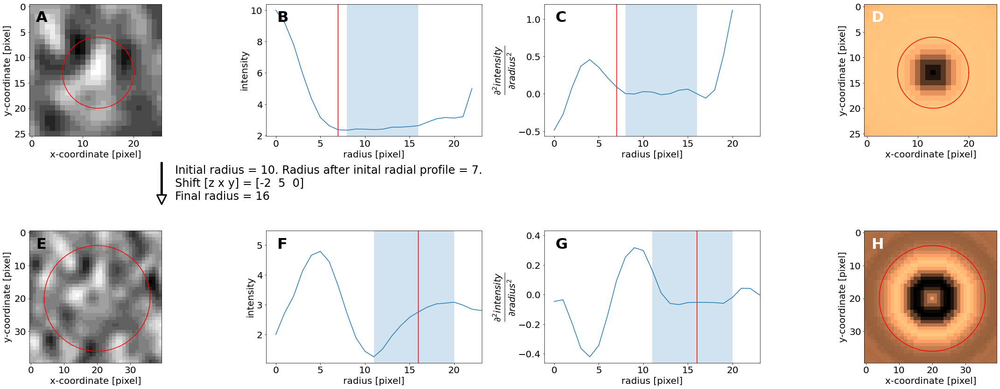

new image box shape is (42, 42, 42)
new centroid is [ 31 379 458]
new_optimal_radius is 17
alternative calc: 17
i is 13


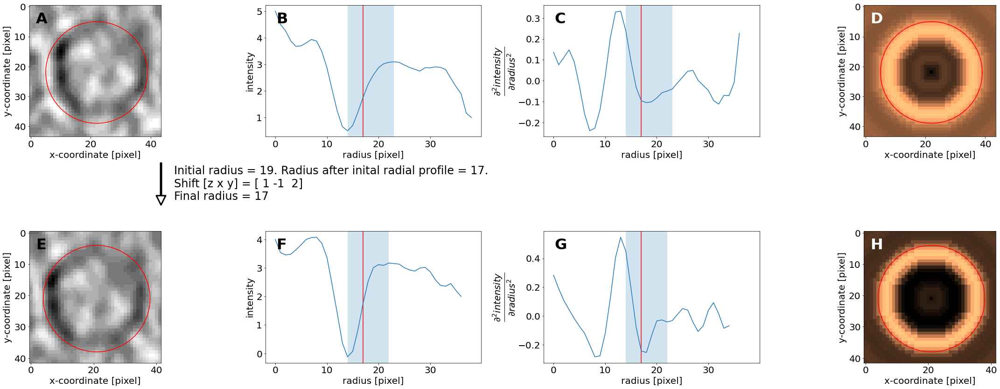

new image box shape is (34, 34, 34)
new centroid is [ 28 490 392]
new_optimal_radius is 13
alternative calc: 13
i is 14


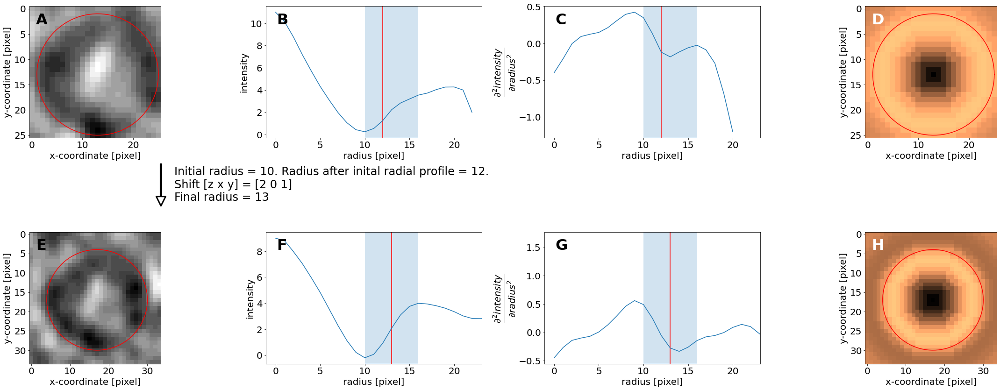

new image box shape is (106, 106, 106)
new centroid is [ 53 527 352]
new_optimal_radius is 50
alternative calc: 51
i is 15


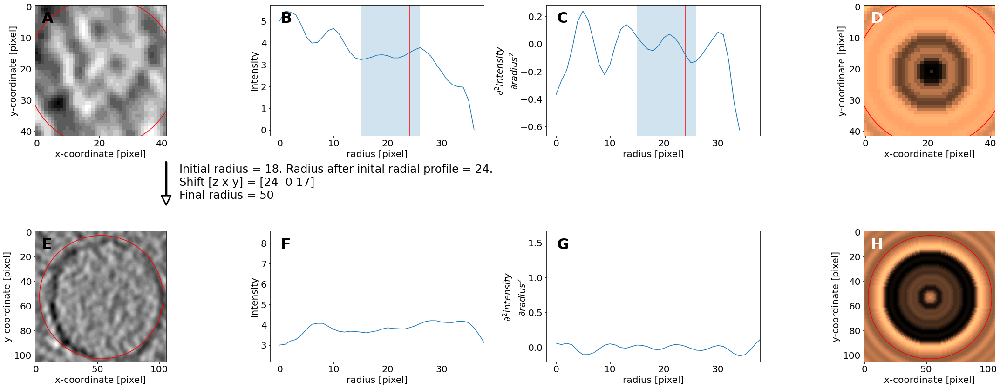

new image box shape is (40, 40, 40)
new centroid is [ 35 226 566]
new_optimal_radius is 16
alternative calc: 16
i is 16


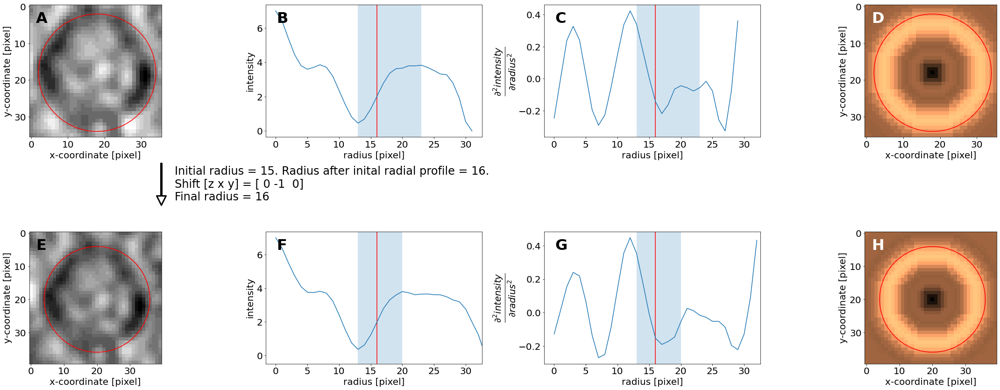

new image box shape is (62, 62, 62)
new centroid is [ 55 300 469]
new_optimal_radius is 27
alternative calc: 27
i is 17


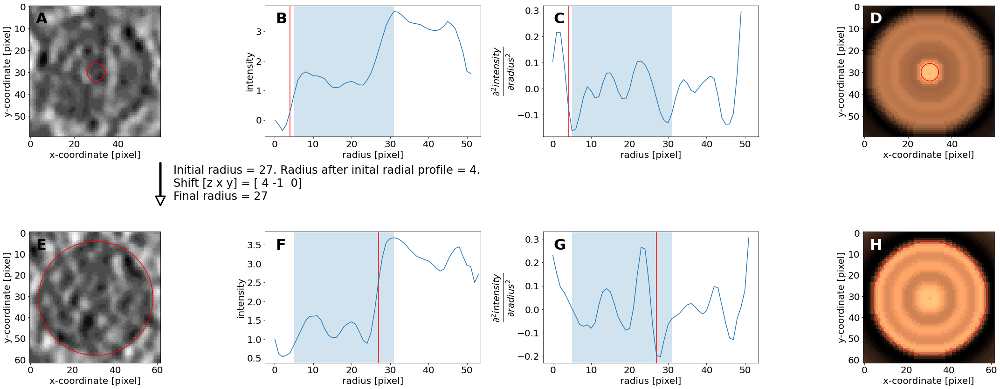

new image box shape is (40, 40, 40)
new centroid is [ 38 377 511]
new_optimal_radius is 16
alternative calc: 16
i is 18


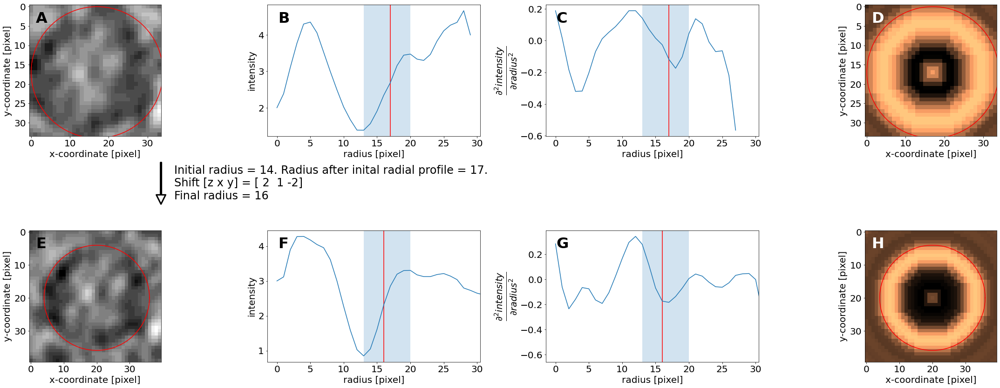

new image box shape is (44, 44, 44)
new centroid is [ 47 412 497]
new_optimal_radius is 18
alternative calc: 18
i is 19


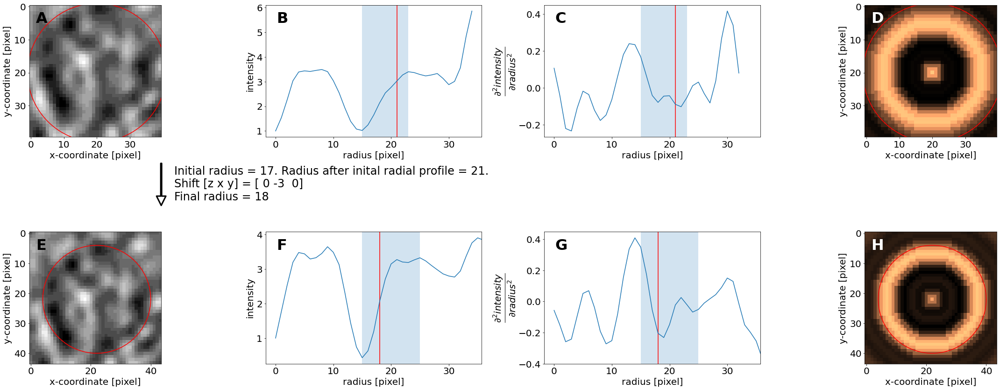

new image box shape is (20, 20, 20)
new centroid is [ 36 561 444]
new_optimal_radius is 6
alternative calc: 1
i is 20


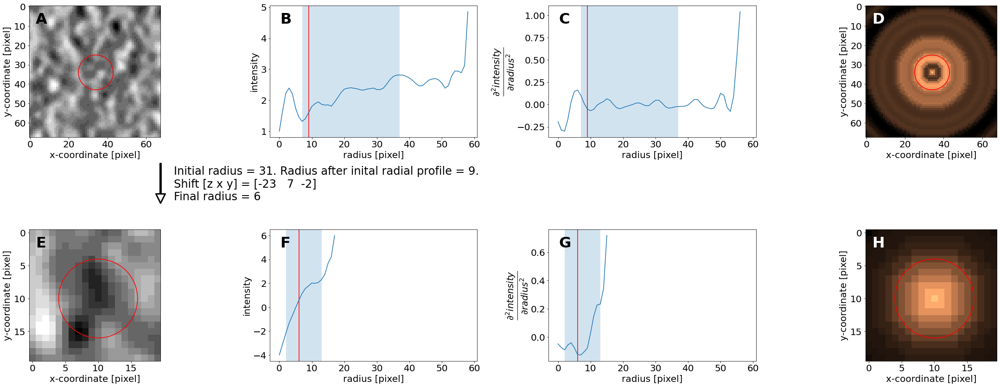

new image box shape is (42, 42, 42)
new centroid is [ 46 562 620]
new_optimal_radius is 17
alternative calc: 19
i is 21


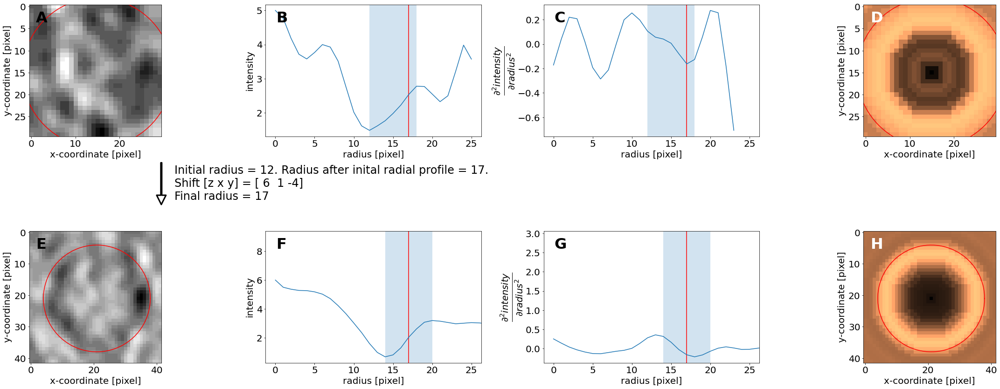

new image box shape is (44, 44, 44)
new centroid is [ 48 350 475]
new_optimal_radius is 18
alternative calc: 18
i is 22


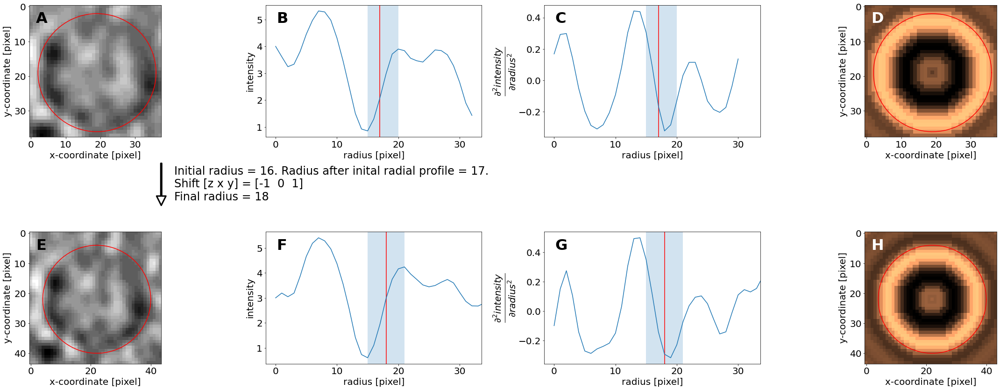

new image box shape is (46, 46, 46)
new centroid is [ 48 529 643]
new_optimal_radius is 19
alternative calc: 18
i is 23


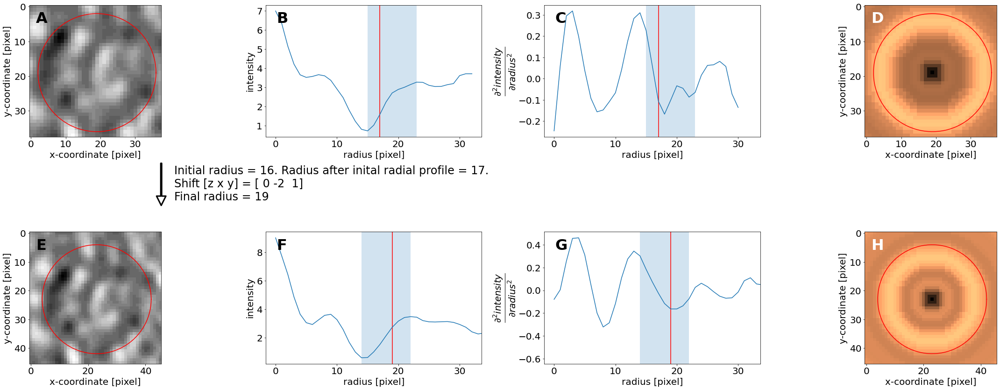

new image box shape is (48, 48, 48)
new centroid is [ 45 566 728]
new_optimal_radius is 20
alternative calc: 26
i is 24


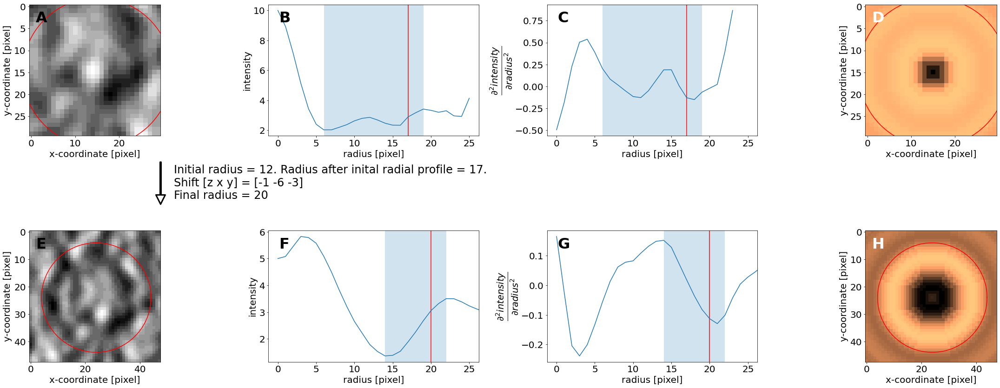

new image box shape is (44, 44, 44)
new centroid is [ 52 283 531]
new_optimal_radius is 18
alternative calc: 19
i is 25


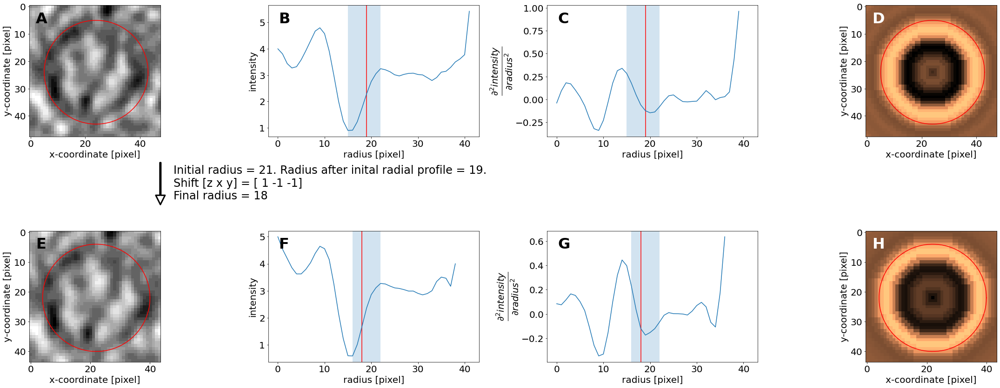

new image box shape is (60, 60, 60)
new centroid is [ 30 211 605]
new_optimal_radius is 37
alternative calc: 36
i is 26


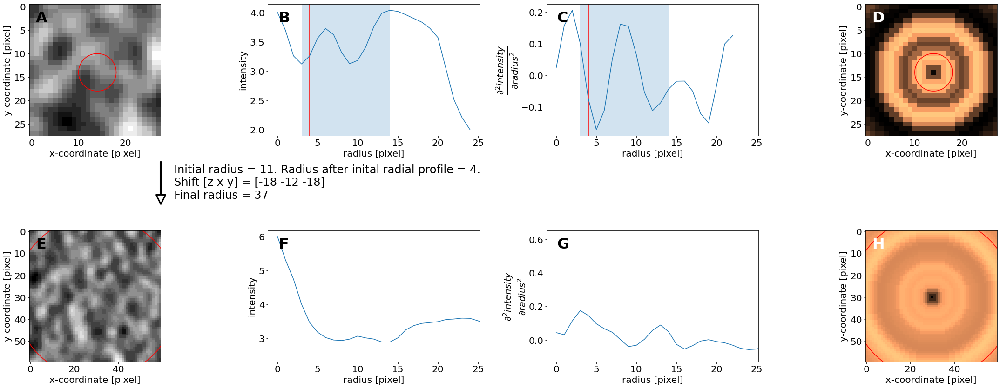

new image box shape is (46, 46, 46)
new centroid is [ 49 575 690]
new_optimal_radius is 19
alternative calc: 21
i is 27


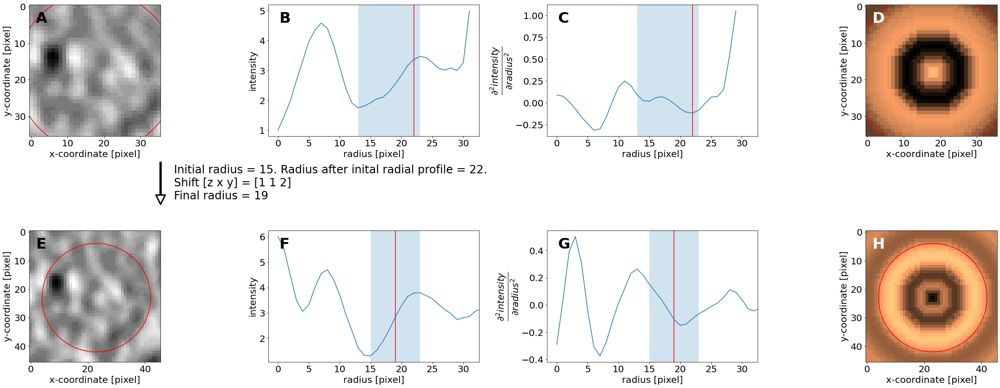

new image box shape is (46, 46, 46)
new centroid is [ 51 648 681]
new_optimal_radius is 19
alternative calc: 19
i is 28


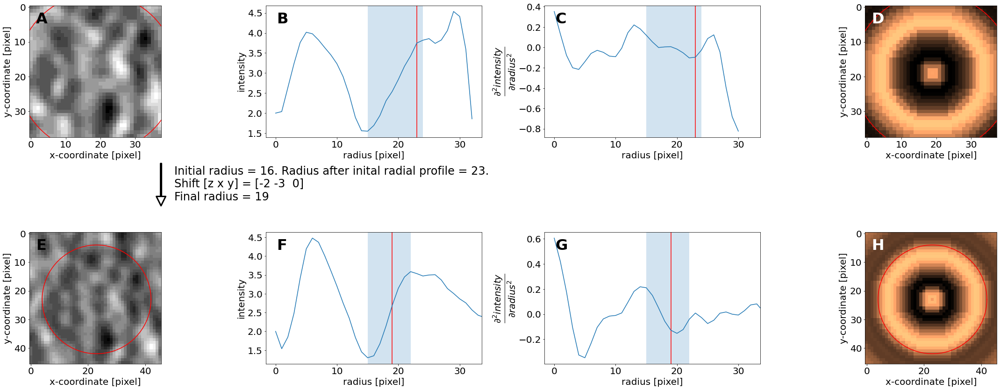

new image box shape is (52, 52, 52)
new centroid is [ 38 158 490]
new_optimal_radius is 22
alternative calc: 14
i is 29


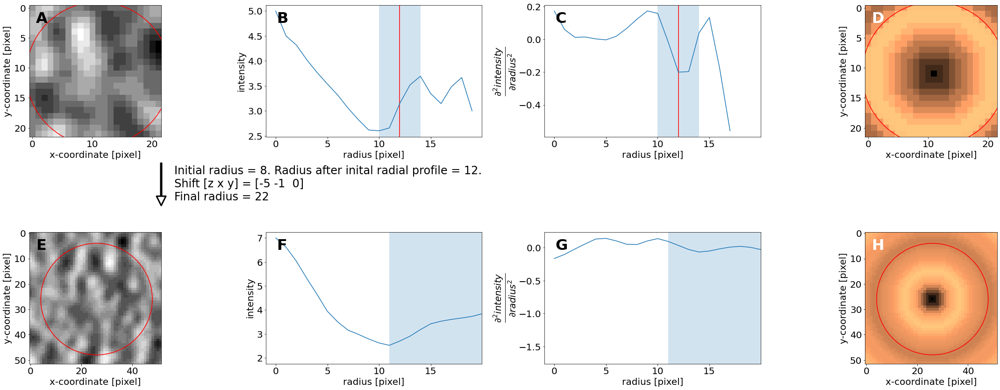

new image box shape is (50, 50, 50)
new centroid is [ 57 366 555]
new_optimal_radius is 21
alternative calc: 21
i is 30


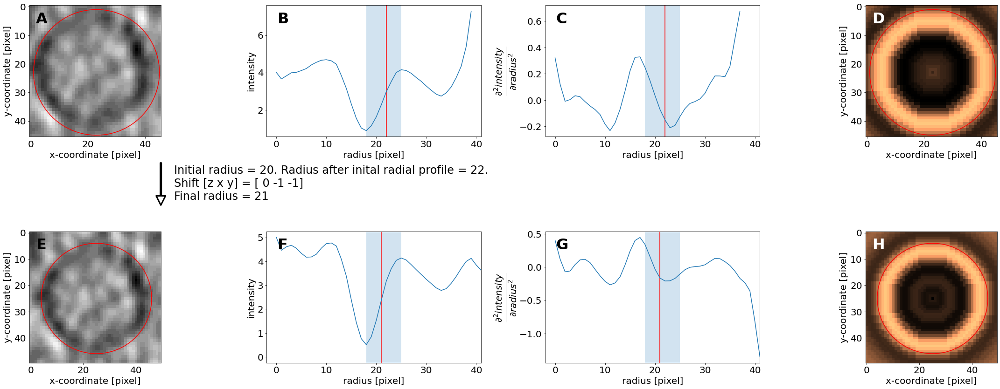

new image box shape is (18, 18, 18)
new centroid is [ 35 462 414]
new_optimal_radius is 5
alternative calc: 2
i is 31


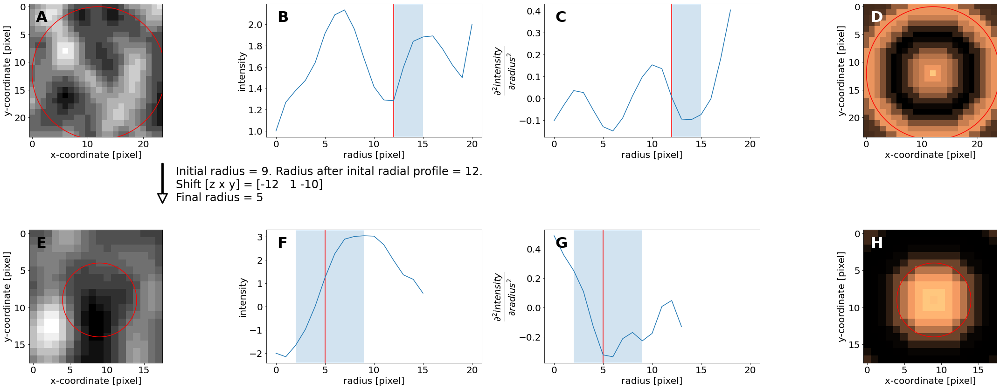

new image box shape is (14, 14, 14)
new centroid is [ 72 415 278]
new_optimal_radius is 3
alternative calc: 0
i is 32


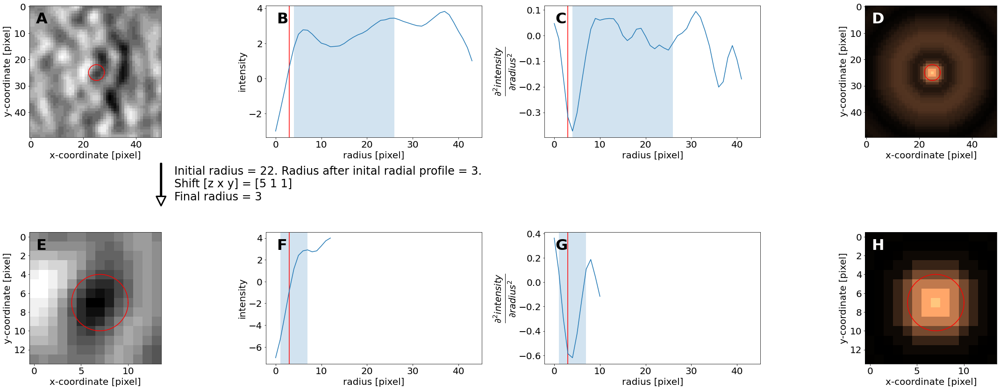

new image box shape is (46, 46, 46)
new centroid is [ 59 615 539]
new_optimal_radius is 19
alternative calc: 19
i is 33


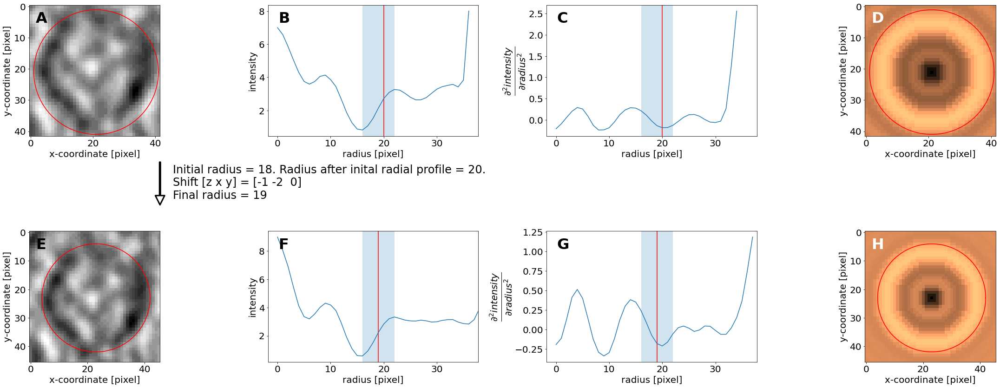

new image box shape is (40, 40, 40)
new centroid is [ 66 227 526]
new_optimal_radius is 16
alternative calc: 12
i is 34


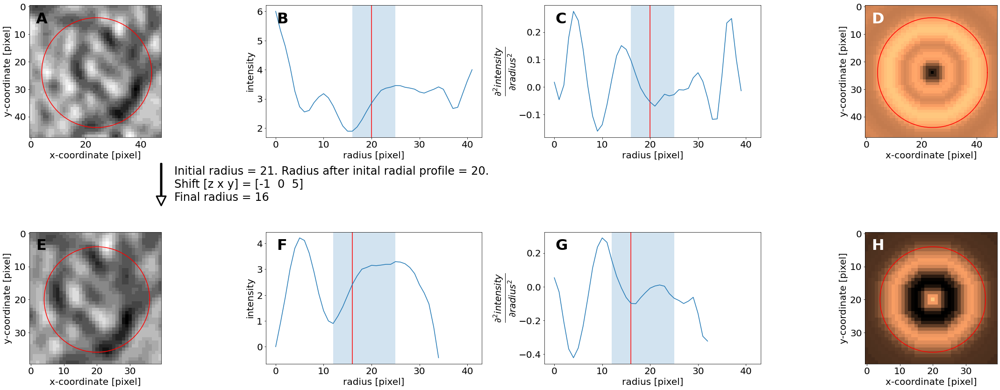

new image box shape is (48, 48, 48)
new centroid is [ 65 341 516]
new_optimal_radius is 20
alternative calc: 20
i is 35


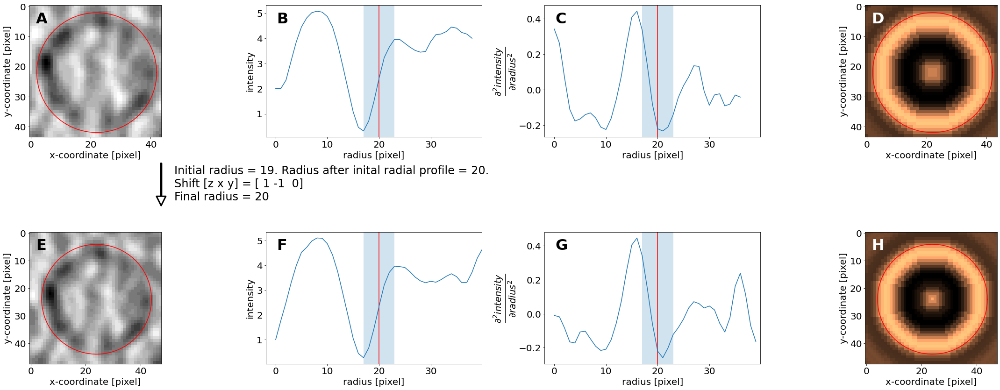

new image box shape is (40, 40, 40)
new centroid is [ 45 475 532]
new_optimal_radius is 16
alternative calc: 14
i is 36


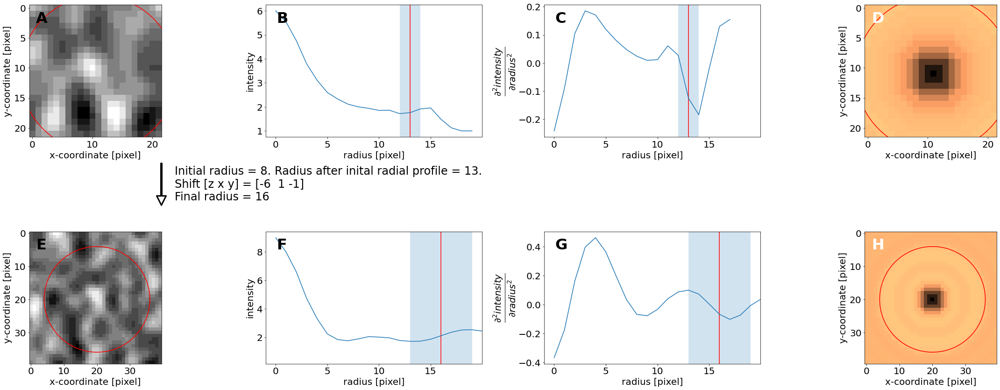

new image box shape is (50, 50, 50)
new centroid is [ 69 287 604]
new_optimal_radius is 21
alternative calc: 21
i is 37


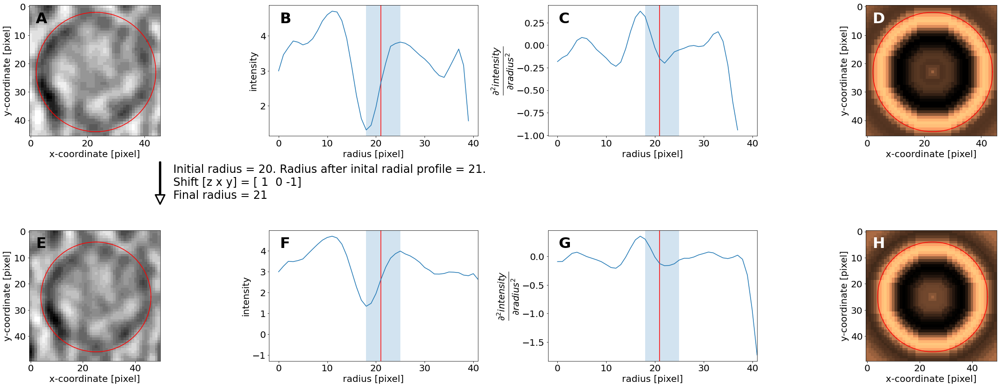

new image box shape is (44, 44, 44)
new centroid is [ 60 583 591]
new_optimal_radius is 18
alternative calc: 19
i is 38


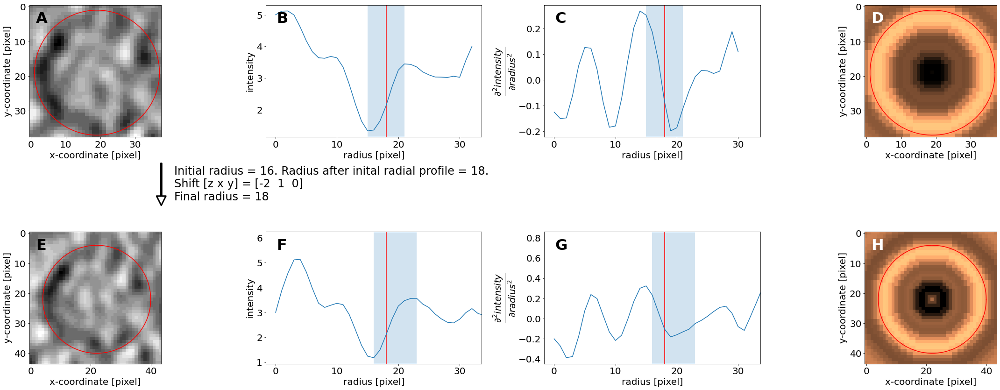

new image box shape is (20, 20, 20)
new centroid is [ 24  94 581]
new_optimal_radius is 6
alternative calc: 1
i is 39


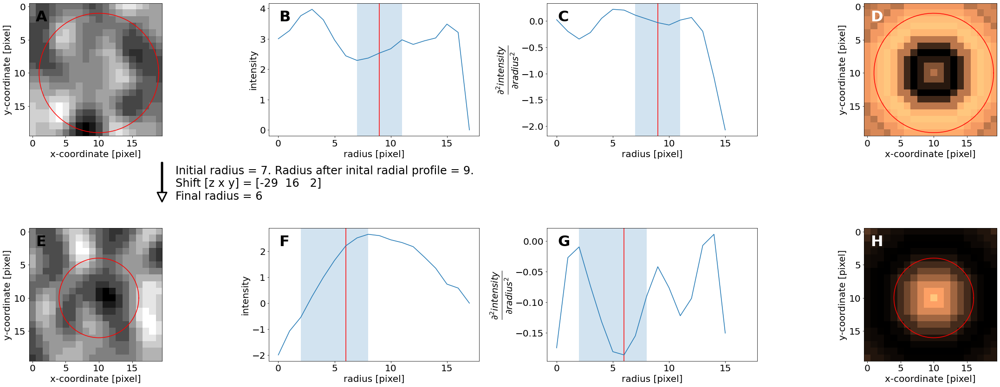

new image box shape is (34, 34, 34)
new centroid is [ 76 513 540]
new_optimal_radius is 13
alternative calc: 12
i is 40


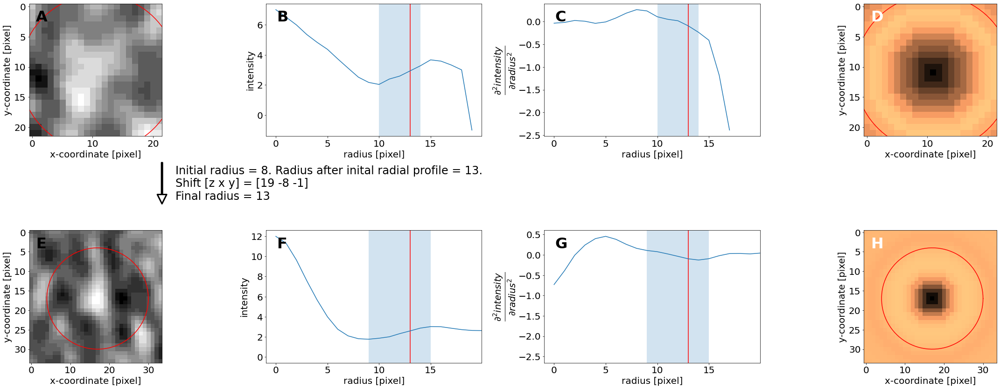

new image box shape is (46, 46, 46)
new centroid is [ 68 244 616]
new_optimal_radius is 19
alternative calc: 18
i is 41


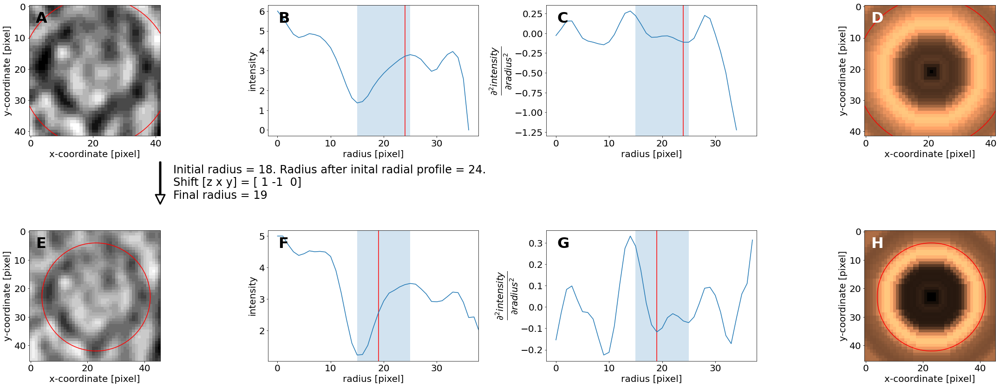

new image box shape is (40, 40, 40)
new centroid is [ 66 256 576]
new_optimal_radius is 16
alternative calc: 16
i is 42


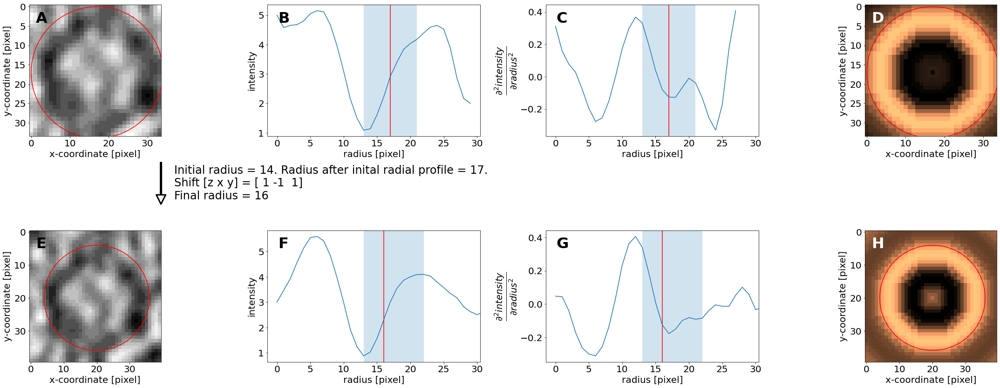

new image box shape is (46, 46, 46)
new centroid is [ 71 331 601]
new_optimal_radius is 19
alternative calc: 19
i is 43


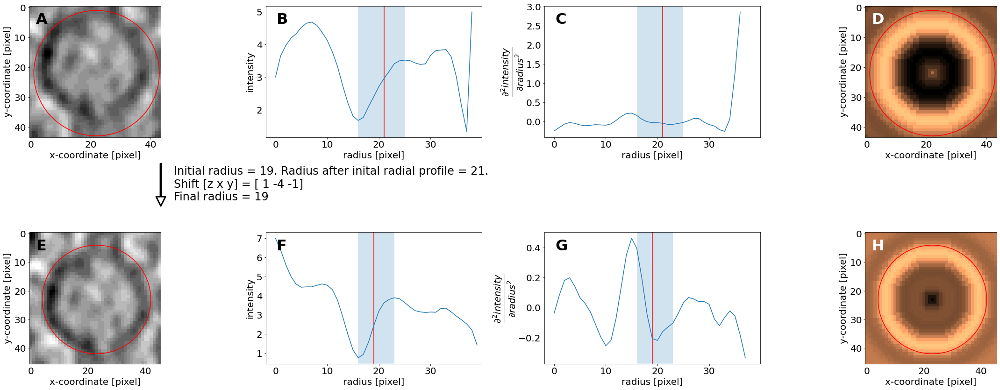

new image box shape is (42, 42, 42)
new centroid is [ 70 414 548]
new_optimal_radius is 17
alternative calc: 17
i is 44


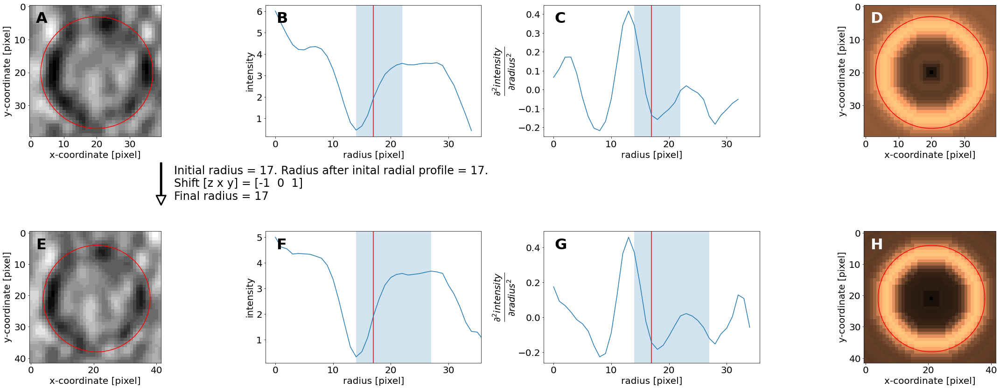

new image box shape is (34, 34, 34)
new centroid is [ 61 458 454]
new_optimal_radius is 13
alternative calc: 6
i is 45


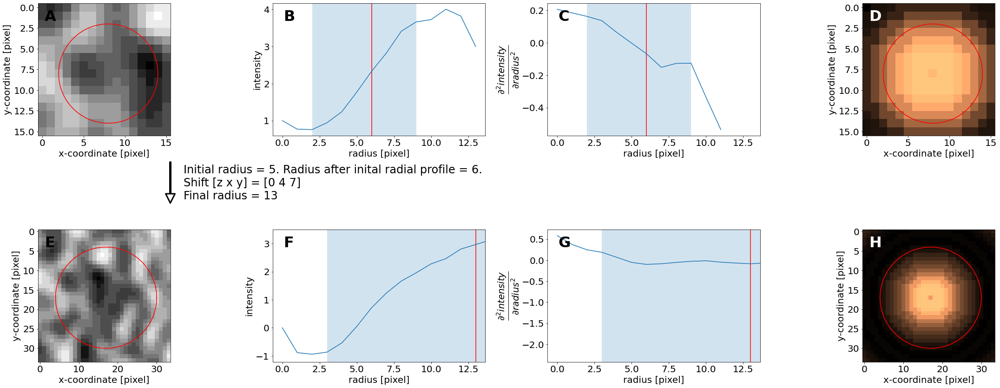

new image box shape is (58, 58, 58)
new centroid is [ 67 601 765]
new_optimal_radius is 25
alternative calc: 18
i is 46


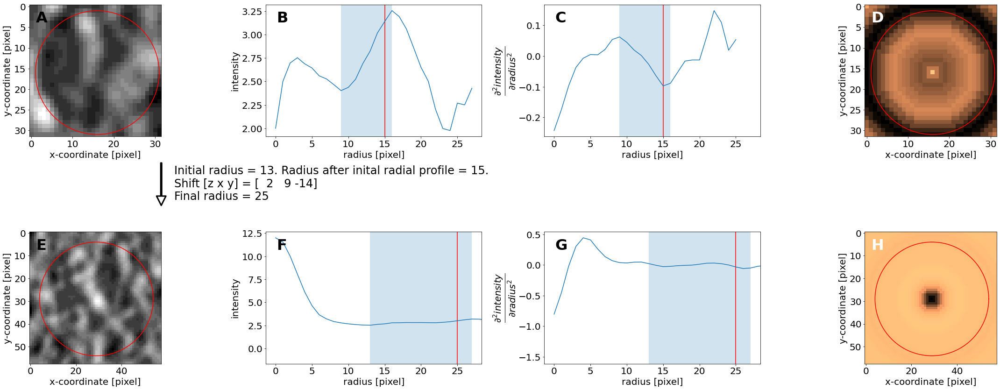

new image box shape is (46, 46, 46)
new centroid is [ 78 305 564]
new_optimal_radius is 19
alternative calc: 19
i is 47


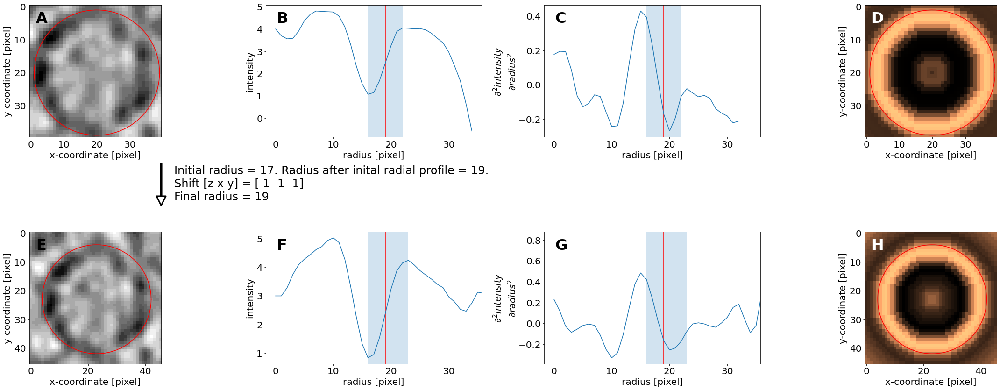

new image box shape is (44, 44, 44)
new centroid is [ 76 578 545]
new_optimal_radius is 18
alternative calc: 18
i is 48


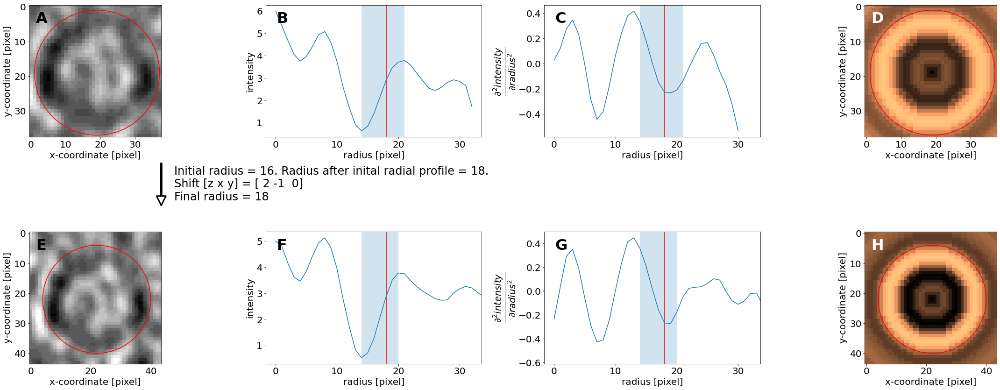

new image box shape is (20, 20, 20)
new centroid is [ 63 689 601]
new_optimal_radius is 6
alternative calc: 5
i is 49


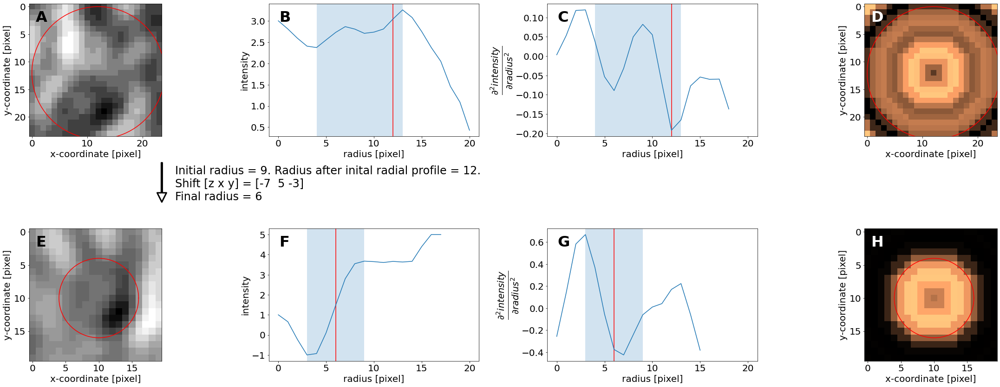

new image box shape is (40, 40, 40)
new centroid is [ 37 415 428]
new_optimal_radius is 16
alternative calc: 12
i is 50


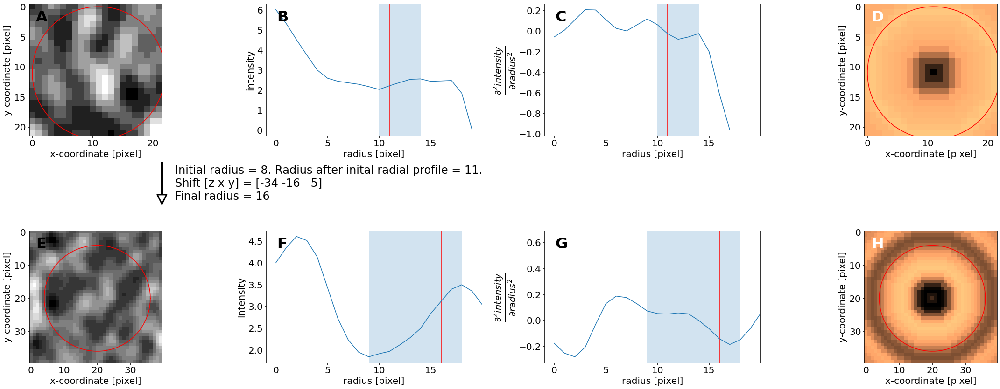

new image box shape is (46, 46, 46)
new centroid is [ 76 537 614]
new_optimal_radius is 19
alternative calc: 19
i is 51


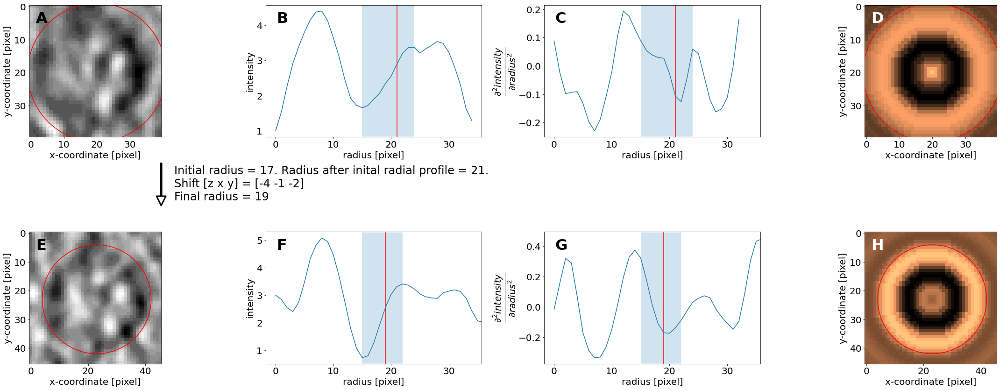

new image box shape is (42, 42, 42)
new centroid is [ 81 326 437]
new_optimal_radius is 17
alternative calc: 17
i is 52


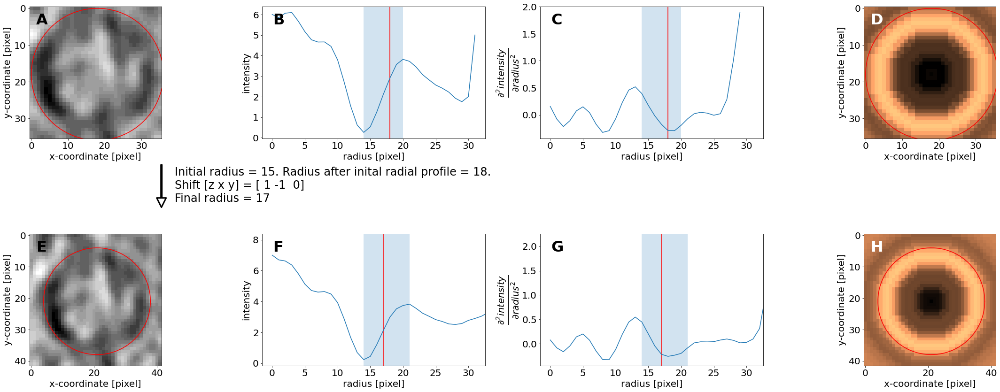

new image box shape is (44, 44, 44)
new centroid is [ 82 289 426]
new_optimal_radius is 18
alternative calc: 18
i is 53


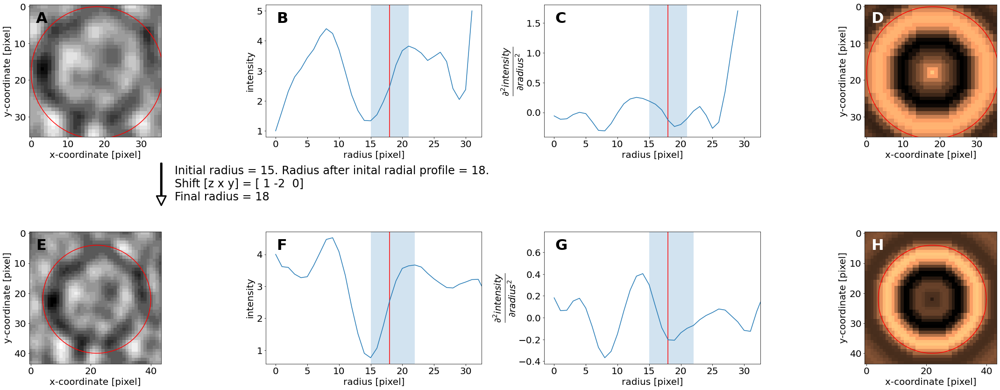

new image box shape is (40, 40, 40)
new centroid is [ 78 490 291]
new_optimal_radius is 16
alternative calc: 16
i is 54


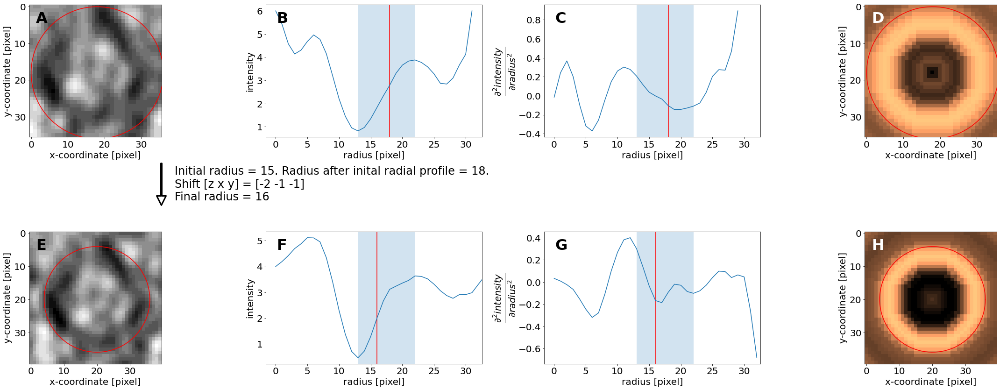

new image box shape is (20, 20, 20)
new centroid is [ 79 507 245]
new_optimal_radius is 6
alternative calc: 6
i is 55


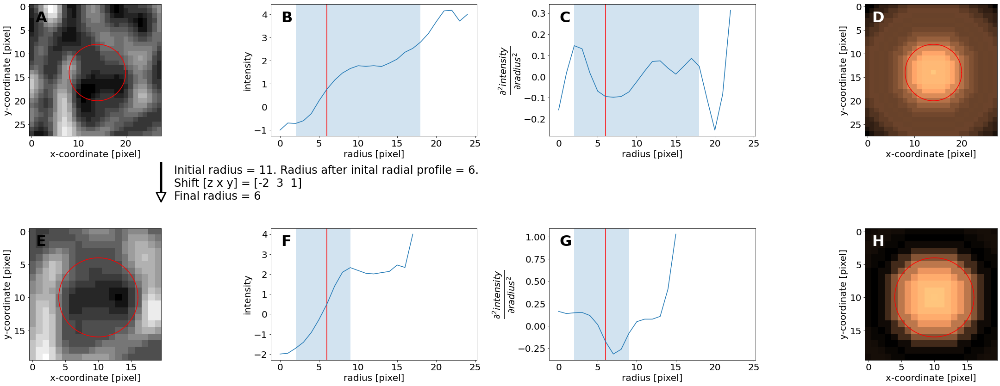

new image box shape is (46, 46, 46)
new centroid is [ 86 555 575]
new_optimal_radius is 19
alternative calc: 19
i is 56


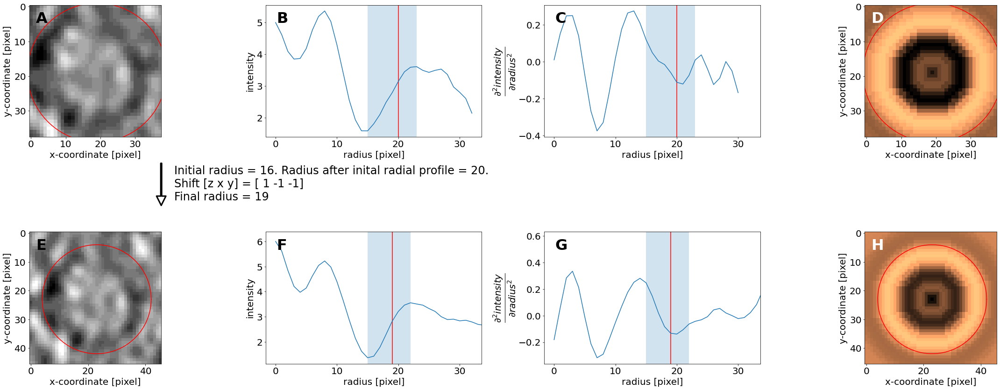

new image box shape is (44, 44, 44)
new centroid is [ 91 407 589]
new_optimal_radius is 18
alternative calc: 17
i is 57


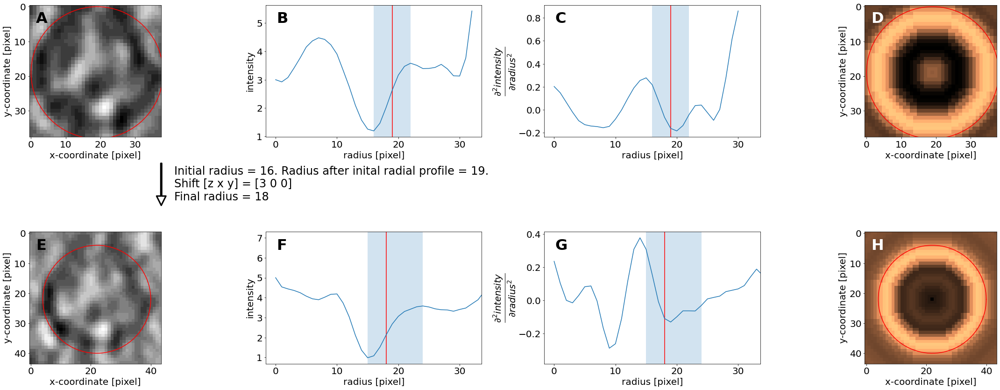

new image box shape is (44, 44, 44)
new centroid is [ 90 274 502]
new_optimal_radius is 18
alternative calc: 18
i is 58


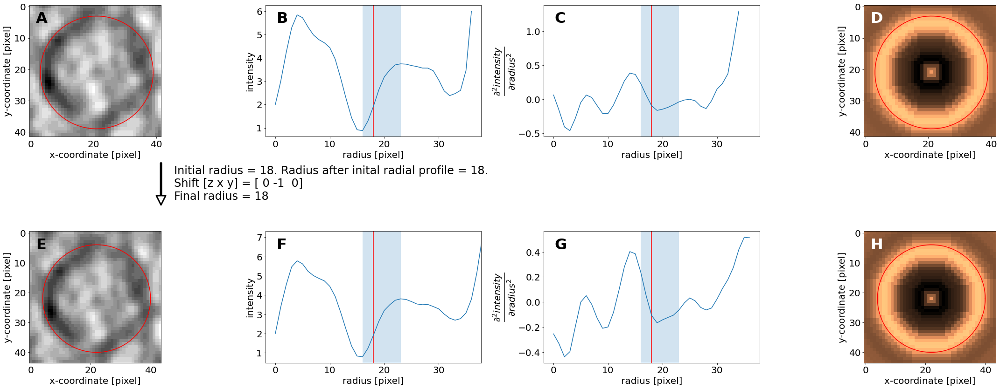

new image box shape is (62, 62, 62)
new centroid is [ 94 454 335]
new_optimal_radius is 27
alternative calc: 27
i is 59


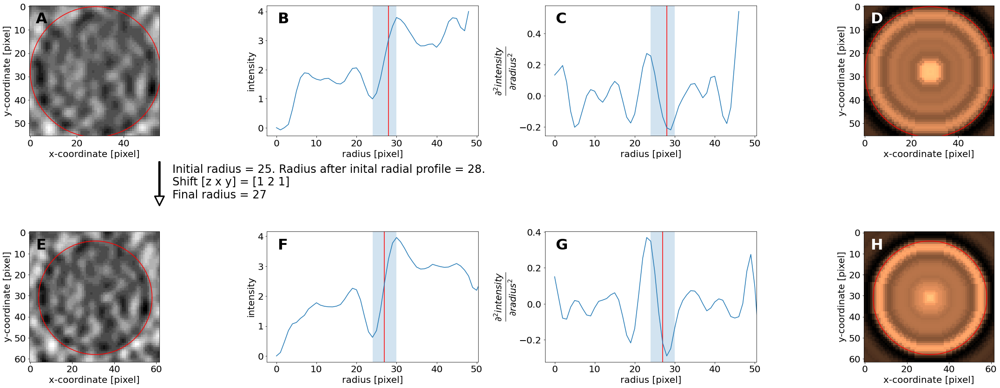

new image box shape is (40, 40, 40)
new centroid is [ 84 466 605]
new_optimal_radius is 16
alternative calc: 16
i is 60


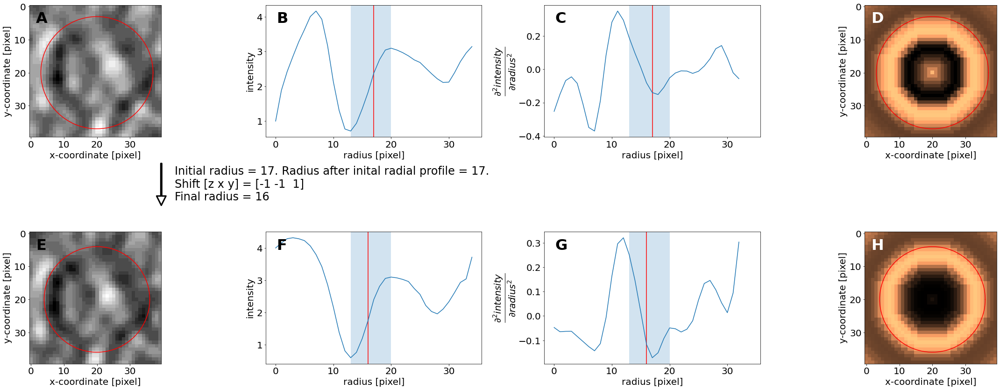

new image box shape is (46, 46, 46)
new centroid is [ 87 193 544]
new_optimal_radius is 19
alternative calc: 15
i is 61


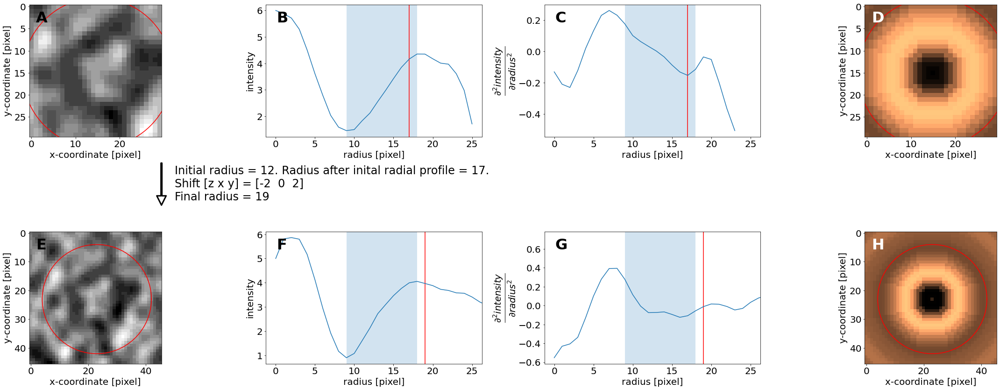

new image box shape is (44, 44, 44)
new centroid is [ 90 272 543]
new_optimal_radius is 18
alternative calc: 18
i is 62


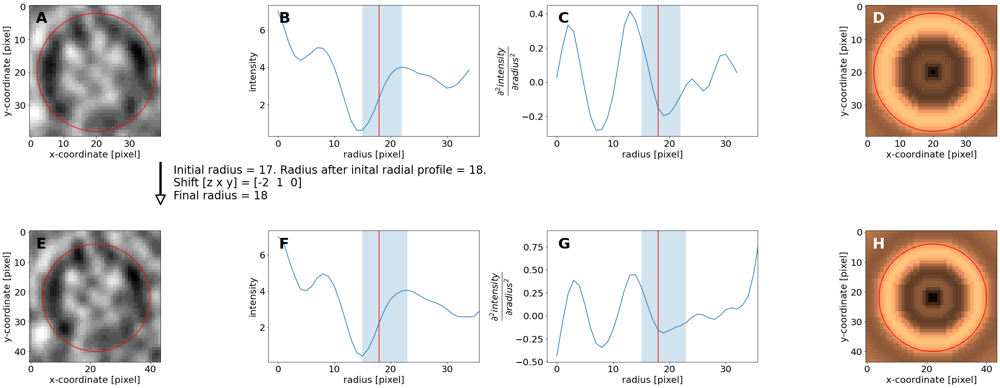

new image box shape is (46, 46, 46)
new centroid is [ 95 342 548]
new_optimal_radius is 19
alternative calc: 19
i is 63


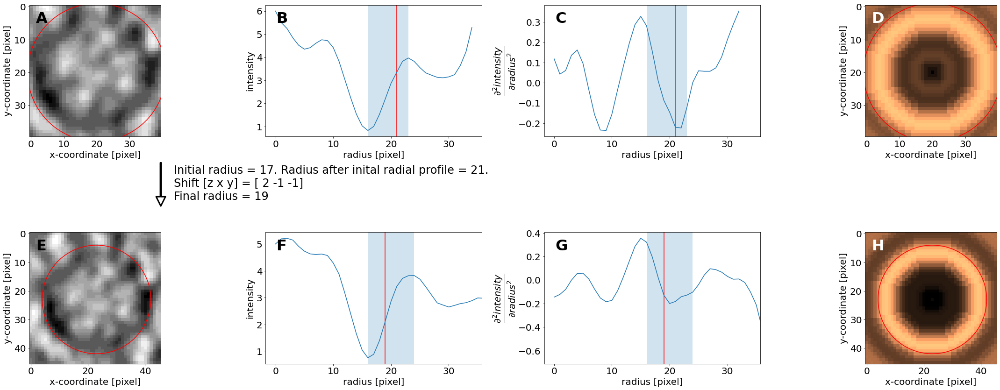

new image box shape is (46, 46, 46)
new centroid is [ 93 515 581]
new_optimal_radius is 19
alternative calc: 19
i is 64


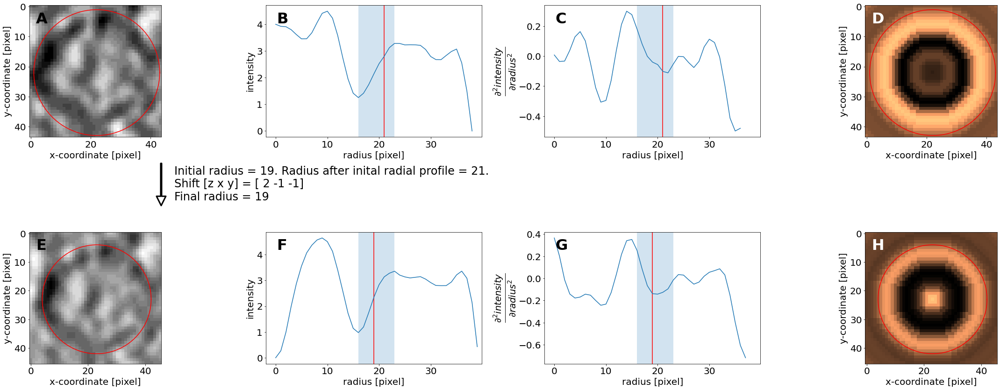

new image box shape is (14, 14, 14)
new centroid is [ 90 344 325]
new_optimal_radius is 3
alternative calc: 0
i is 65


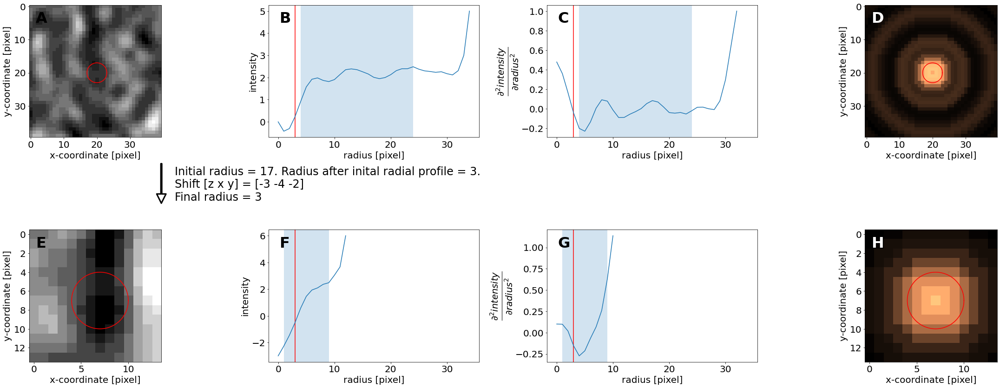

new image box shape is (44, 44, 44)
new centroid is [ 77 565 724]
new_optimal_radius is 18
alternative calc: 7
i is 66


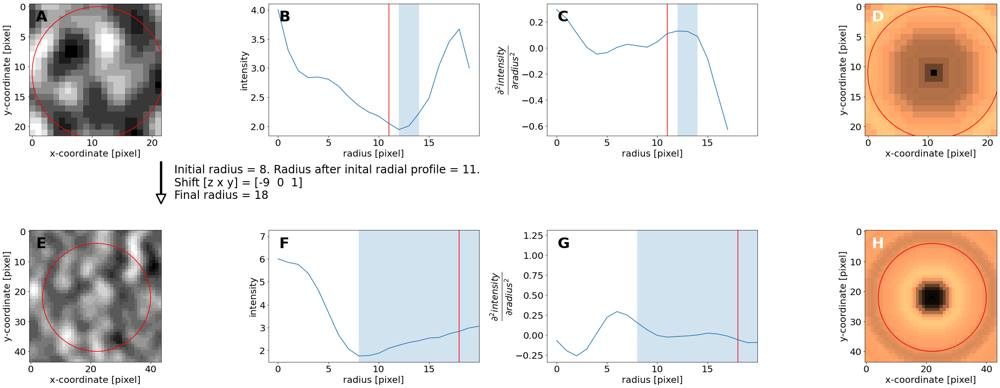

new image box shape is (46, 46, 46)
new centroid is [ 96 348 483]
new_optimal_radius is 19
alternative calc: 19
i is 67


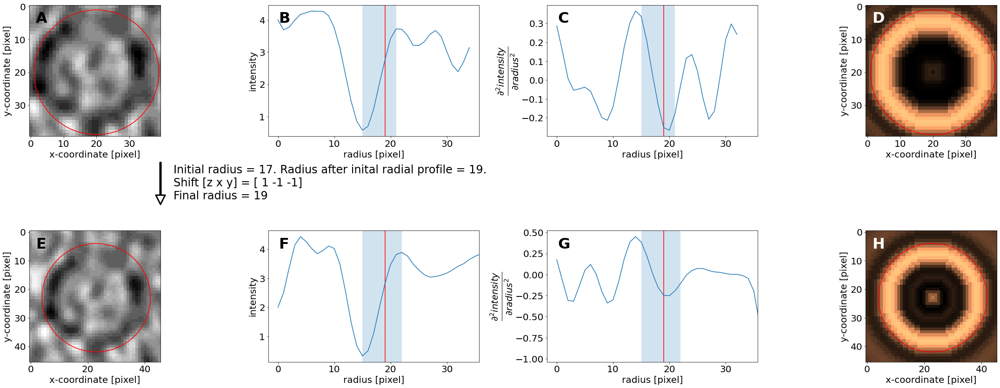

new image box shape is (50, 50, 50)
new centroid is [101 643 591]
new_optimal_radius is 21
alternative calc: 22
i is 68


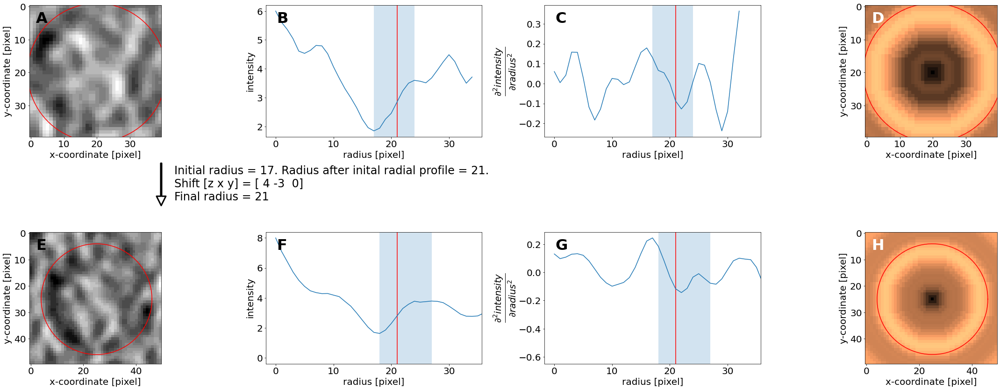

new image box shape is (38, 38, 38)
new centroid is [ 90 362 392]
new_optimal_radius is 15
alternative calc: 13
i is 69


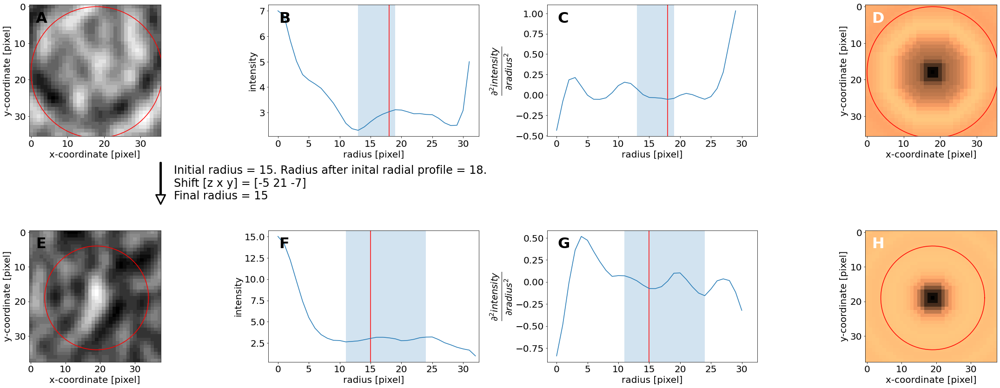

new image box shape is (44, 44, 44)
new centroid is [ 98 186 580]
new_optimal_radius is 18
alternative calc: 19
i is 70


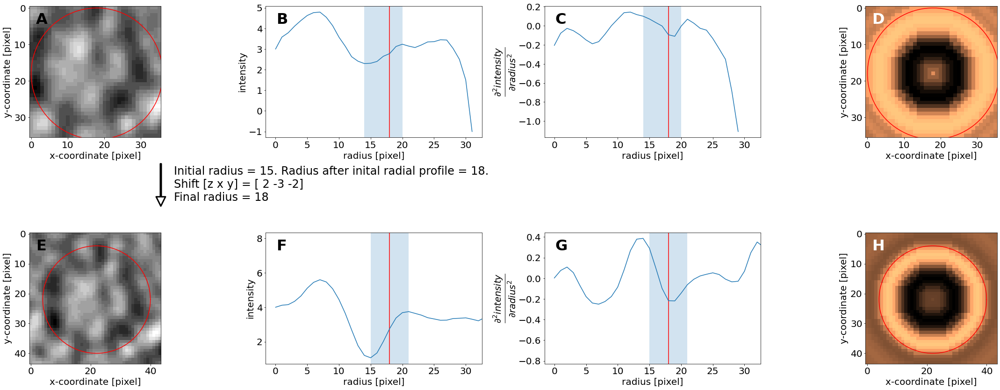

new image box shape is (52, 52, 52)
new centroid is [103 216 615]
new_optimal_radius is 22
alternative calc: 22
i is 71


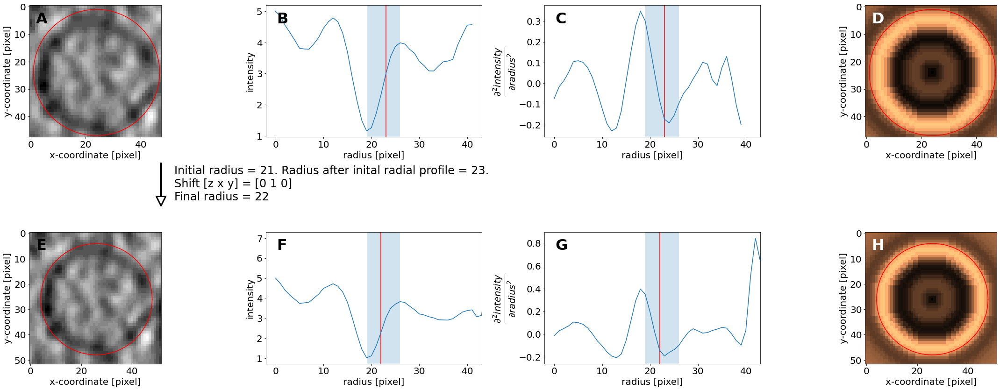

new image box shape is (50, 50, 50)
new centroid is [ 96 647 705]
new_optimal_radius is 21
alternative calc: 20
i is 72


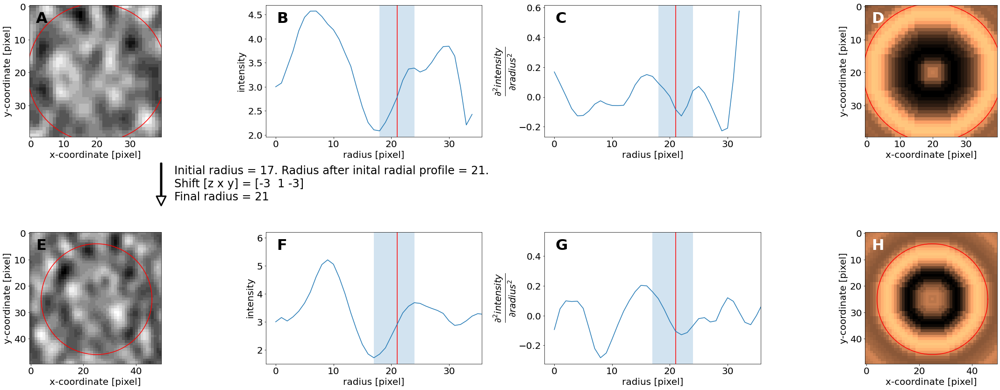

new image box shape is (42, 42, 42)
new centroid is [ 91 314 502]
new_optimal_radius is 17
alternative calc: 20
i is 73


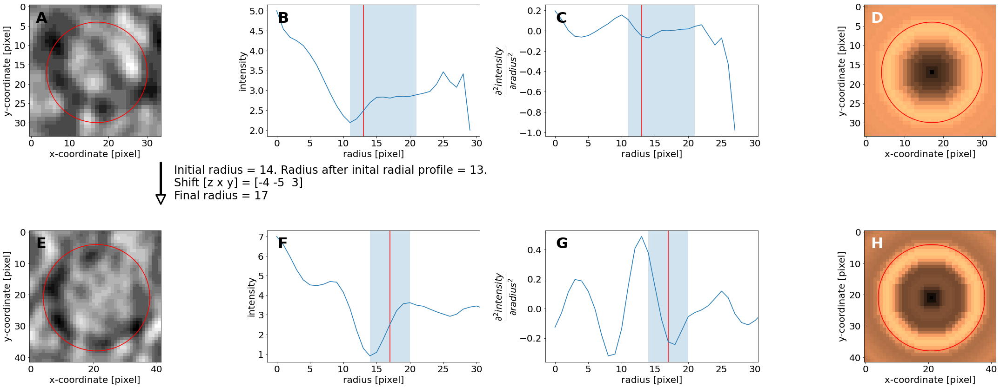

new image box shape is (38, 38, 38)
new centroid is [ 98  63 585]
new_optimal_radius is 15
alternative calc: 15
i is 74


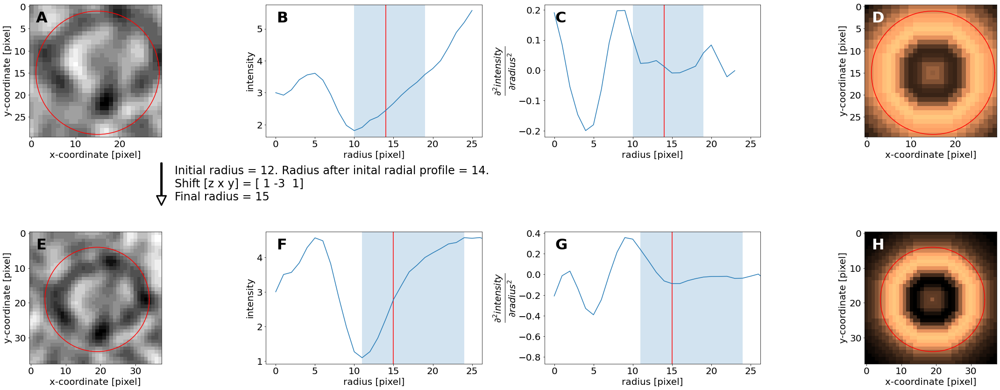

new image box shape is (46, 46, 46)
new centroid is [102 262 447]
new_optimal_radius is 19
alternative calc: 19
i is 75


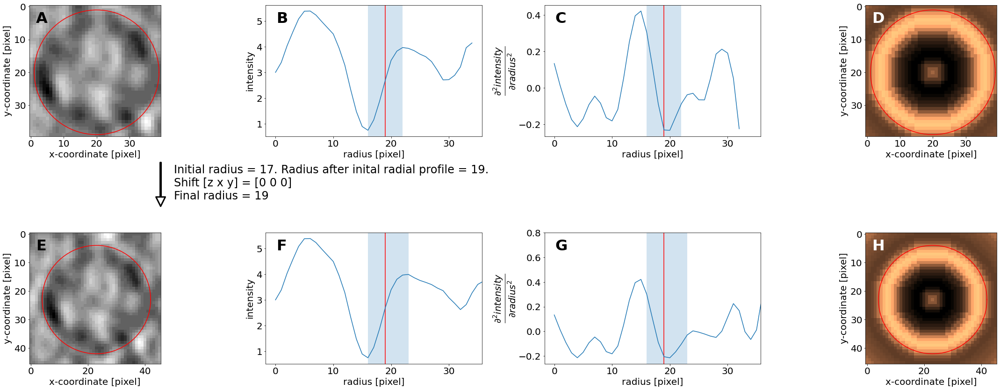

new image box shape is (44, 44, 44)
new centroid is [104 302 459]
new_optimal_radius is 18
alternative calc: 18
i is 76


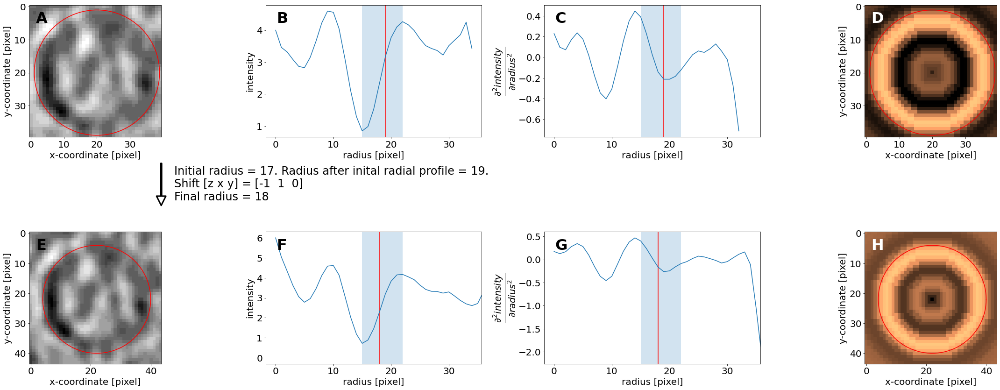

new image box shape is (18, 18, 18)
new centroid is [101 681 636]
new_optimal_radius is 5
alternative calc: 4
i is 77


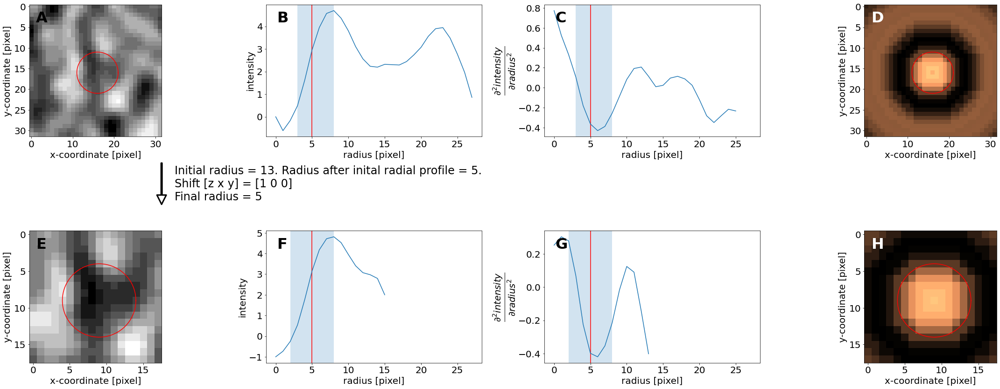

new image box shape is (48, 48, 48)
new centroid is [109 392 542]
new_optimal_radius is 20
alternative calc: 20
i is 78


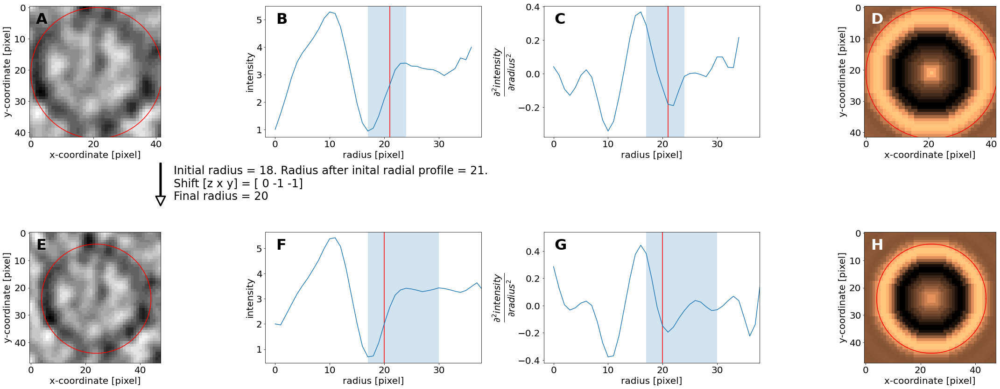

new image box shape is (48, 48, 48)
new centroid is [ 94 419 438]
new_optimal_radius is 20
alternative calc: 16
i is 79


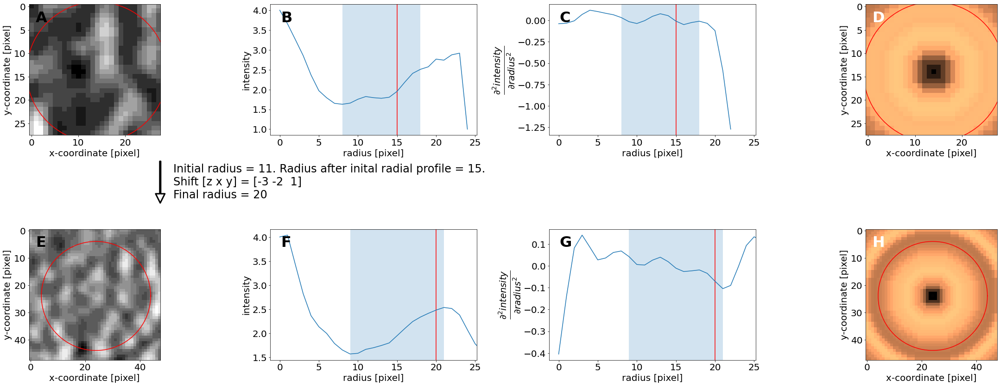

new image box shape is (42, 42, 42)
new centroid is [104 434 526]
new_optimal_radius is 17
alternative calc: 17
i is 80


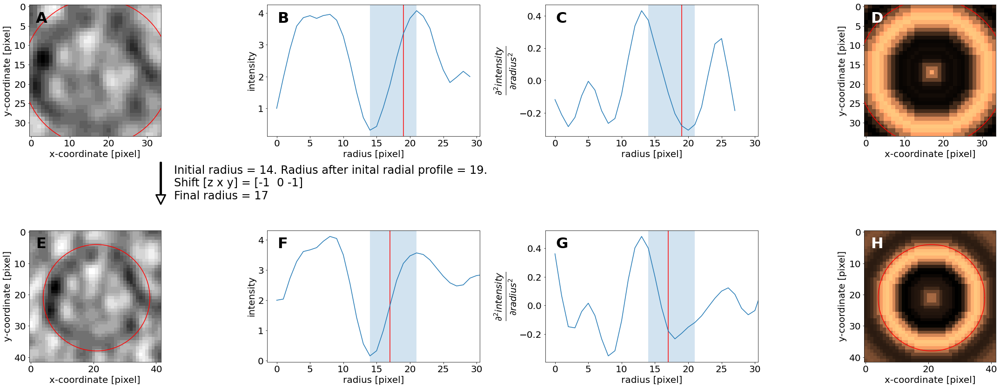

new image box shape is (42, 42, 42)
new centroid is [105 457 563]
new_optimal_radius is 17
alternative calc: 17
i is 81


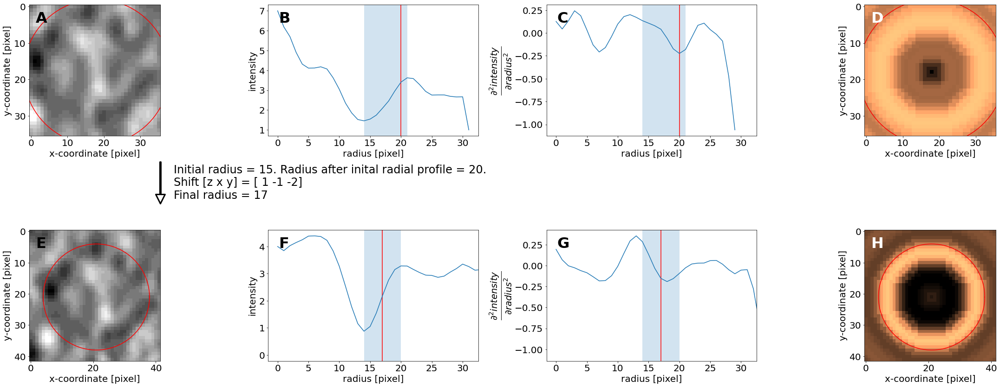

new image box shape is (56, 56, 56)
new centroid is [108 707 690]
new_optimal_radius is 24
alternative calc: 12
i is 82


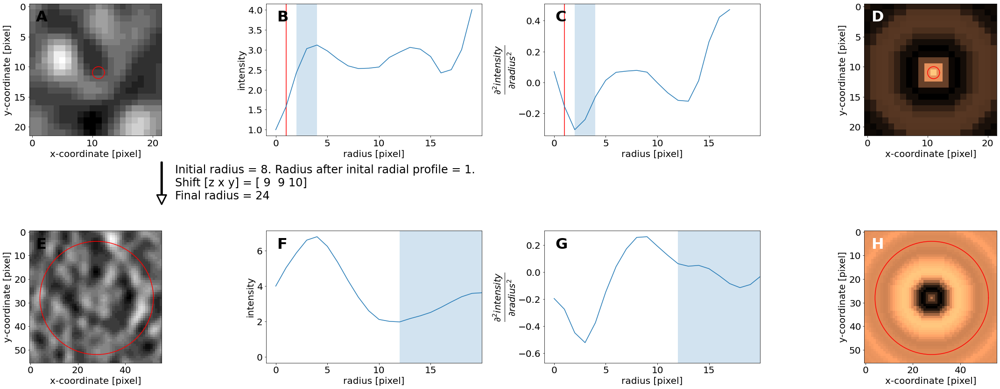

new image box shape is (34, 34, 34)
new centroid is [ 76 522 329]
new_optimal_radius is 13
alternative calc: 13
i is 83


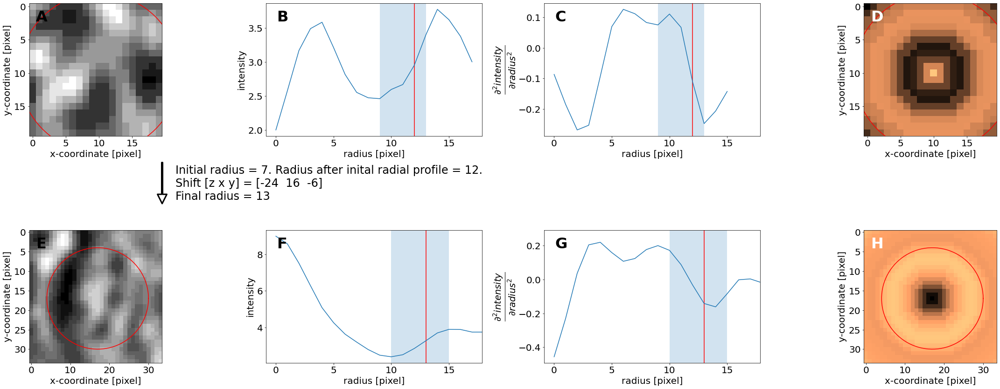

new image box shape is (128, 128, 128)
new centroid is [114 464 495]
new_optimal_radius is 60
alternative calc: 41
i is 84


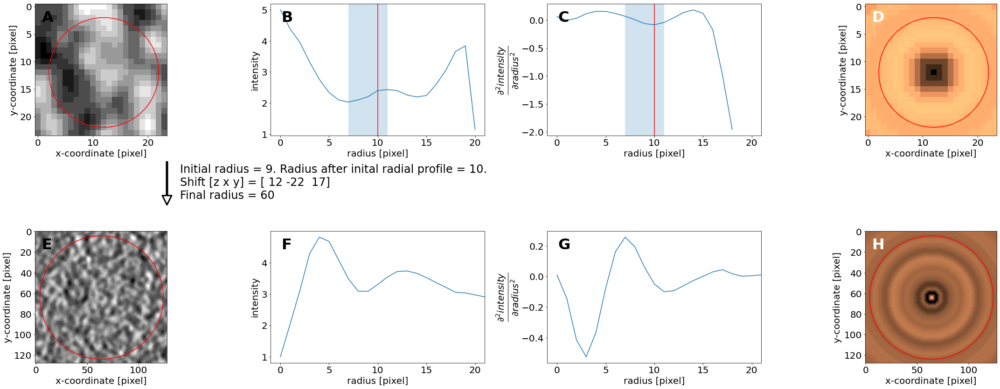

new image box shape is (42, 42, 42)
new centroid is [112 480 252]
new_optimal_radius is 17
alternative calc: 17
i is 85


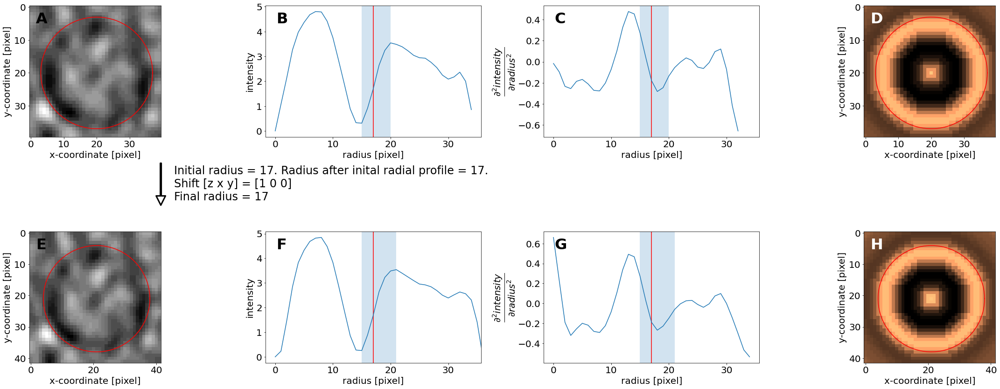

new image box shape is (42, 42, 42)
new centroid is [108 625 676]
new_optimal_radius is 17
alternative calc: 18
i is 86


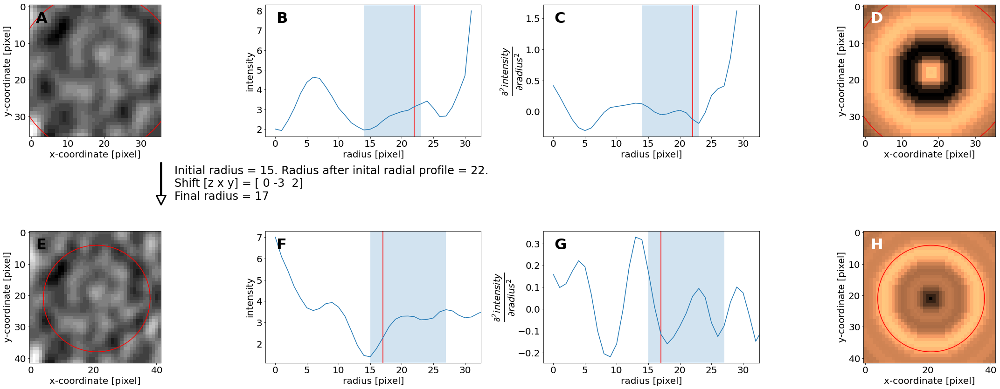

new image box shape is (36, 36, 36)
new centroid is [116 458 470]
new_optimal_radius is 14
alternative calc: 18
i is 87


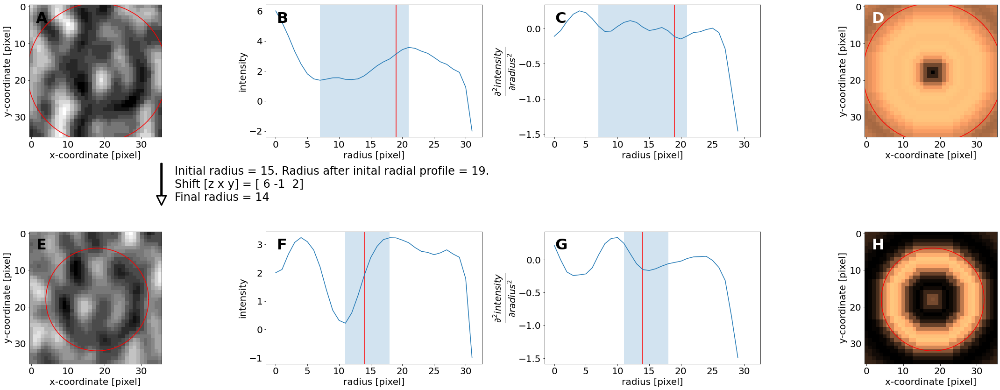

new image box shape is (50, 50, 50)
new centroid is [112 568 495]
new_optimal_radius is 21
alternative calc: 21
i is 88


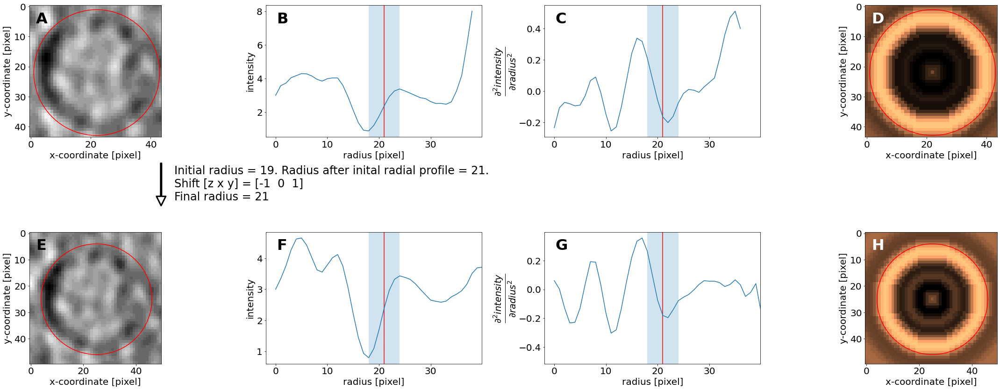

new image box shape is (46, 46, 46)
new centroid is [107 587 591]
new_optimal_radius is 19
alternative calc: 20
i is 89


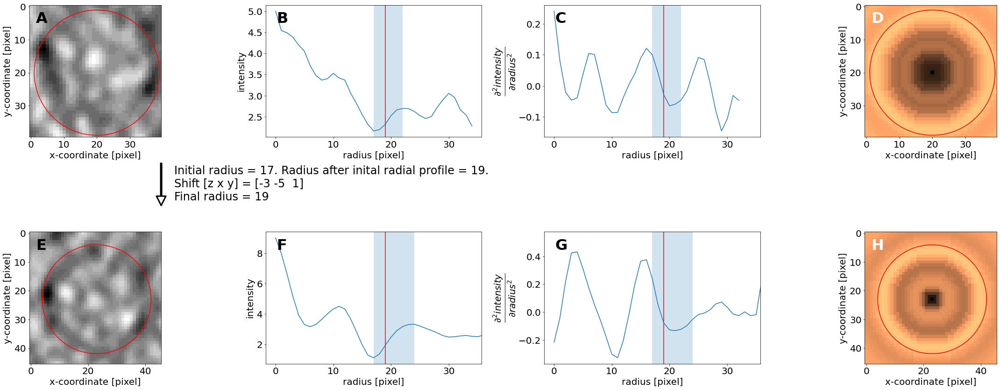

new image box shape is (48, 48, 48)
new centroid is [114 684 595]
new_optimal_radius is 20
alternative calc: 21
i is 90


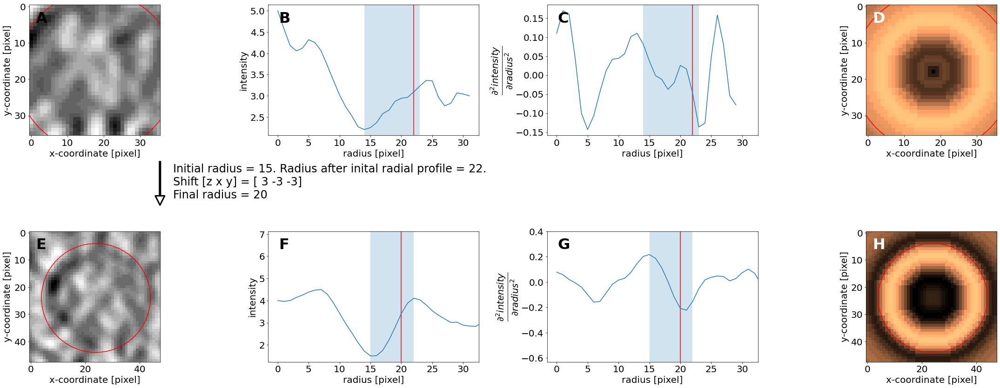

new image box shape is (46, 46, 46)
new centroid is [114 241 569]
new_optimal_radius is 19
alternative calc: 19
i is 91


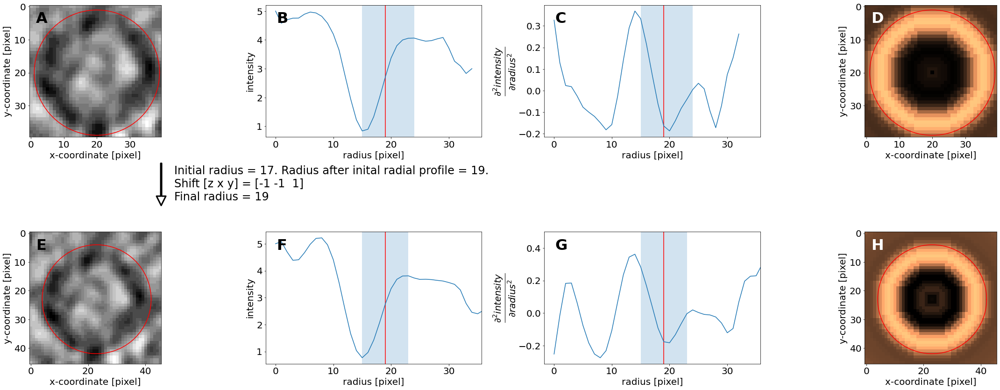

new image box shape is (46, 46, 46)
new centroid is [115 531 548]
new_optimal_radius is 19
alternative calc: 20
i is 92


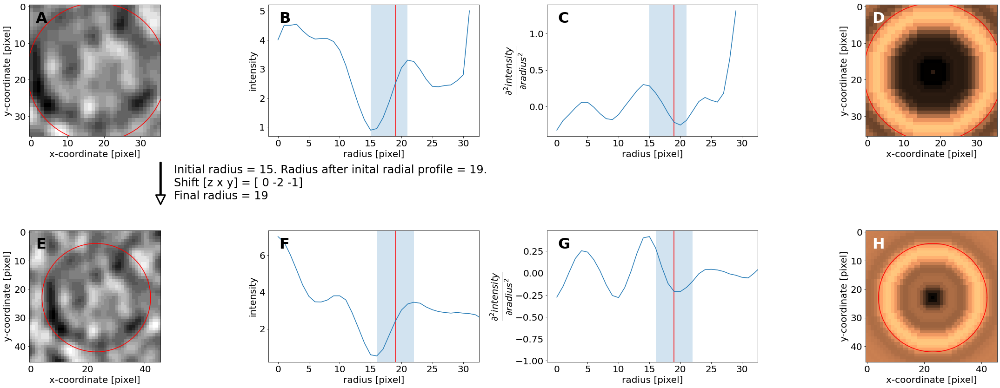

new image box shape is (42, 42, 42)
new centroid is [111 584 550]
new_optimal_radius is 17
alternative calc: 17
i is 93


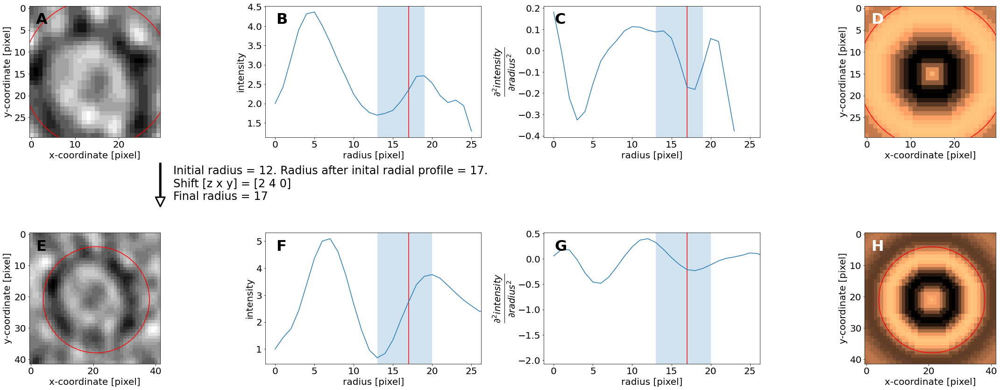

new image box shape is (46, 46, 46)
new centroid is [116 303 533]
new_optimal_radius is 19
alternative calc: 19
i is 94


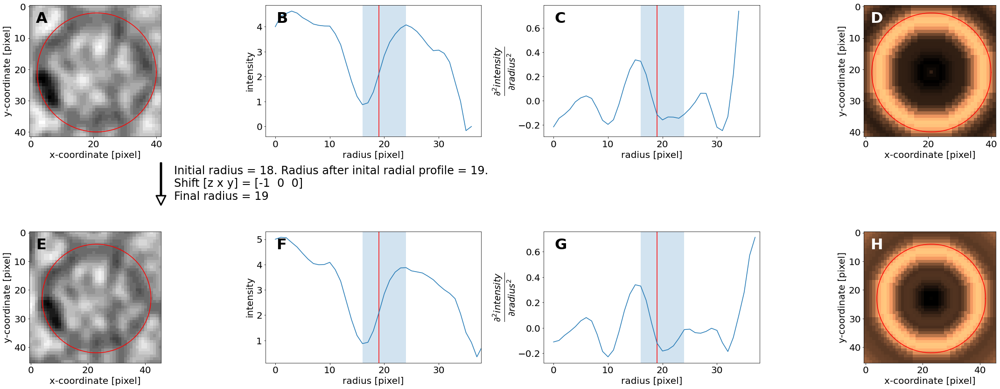

new image box shape is (52, 52, 52)
new centroid is [120 343 587]
new_optimal_radius is 22
alternative calc: 22
i is 95


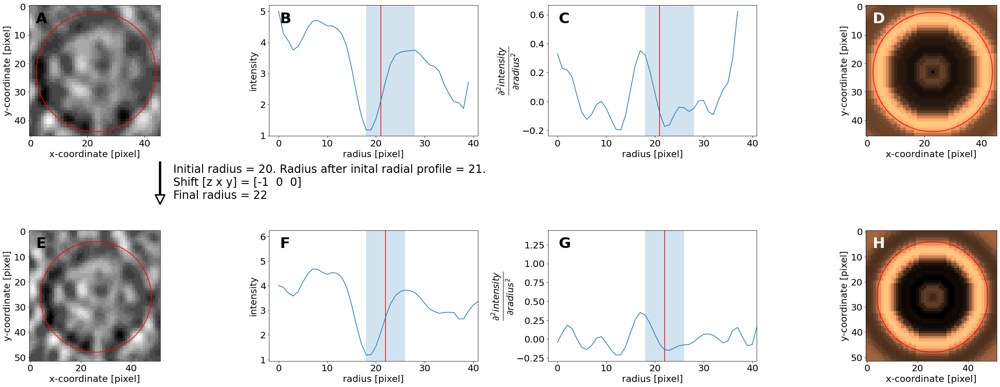

new image box shape is (40, 40, 40)
new centroid is [115 134 590]
new_optimal_radius is 16
alternative calc: 16
i is 96


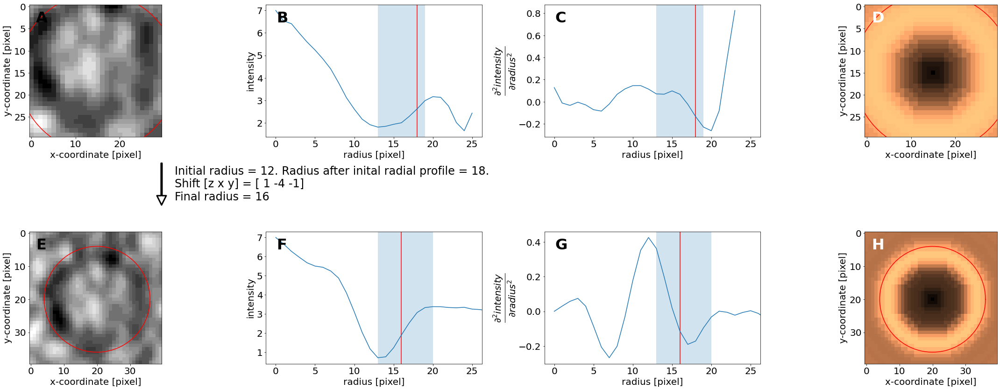

new image box shape is (44, 44, 44)
new centroid is [116 247 484]
new_optimal_radius is 18
alternative calc: 18
i is 97


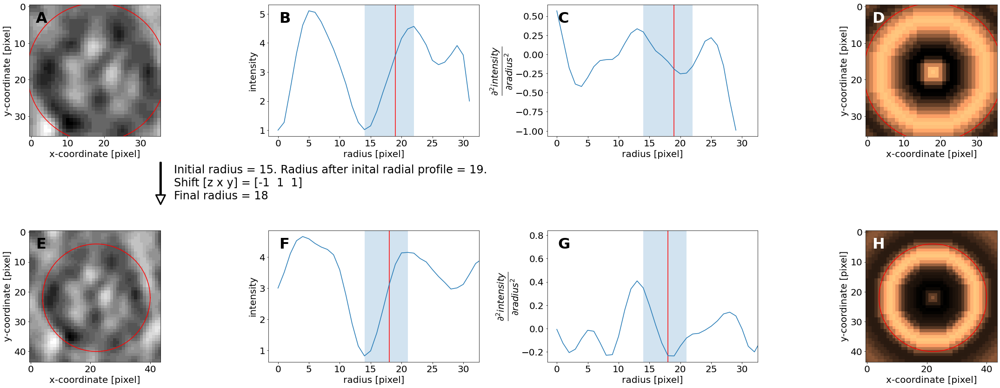

new image box shape is (46, 46, 46)
new centroid is [115 411 497]
new_optimal_radius is 19
alternative calc: 19
i is 98


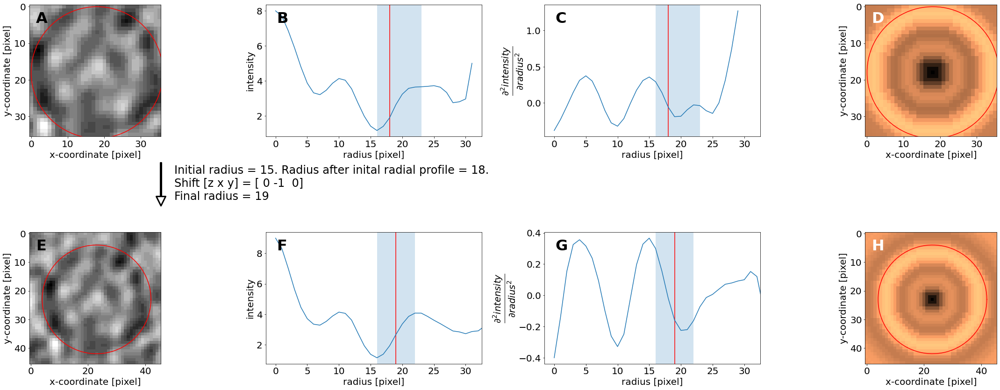

new image box shape is (40, 40, 40)
new centroid is [120 462 295]
new_optimal_radius is 16
alternative calc: 16
i is 99


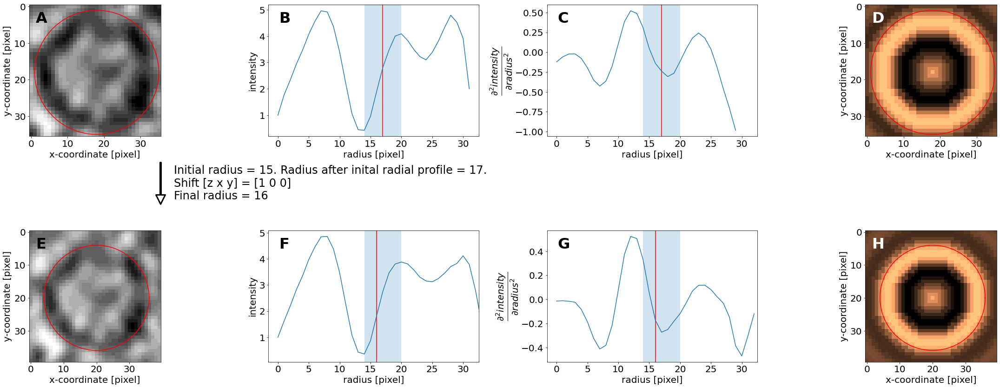

new image box shape is (18, 18, 18)
new centroid is [103 373 416]
new_optimal_radius is 5
alternative calc: 3
i is 100


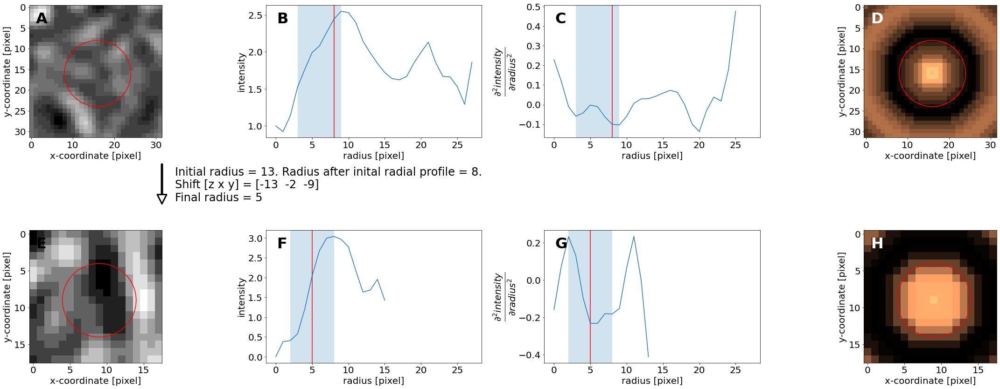

new image box shape is (44, 44, 44)
new centroid is [124 261 529]
new_optimal_radius is 18
alternative calc: 18
i is 101


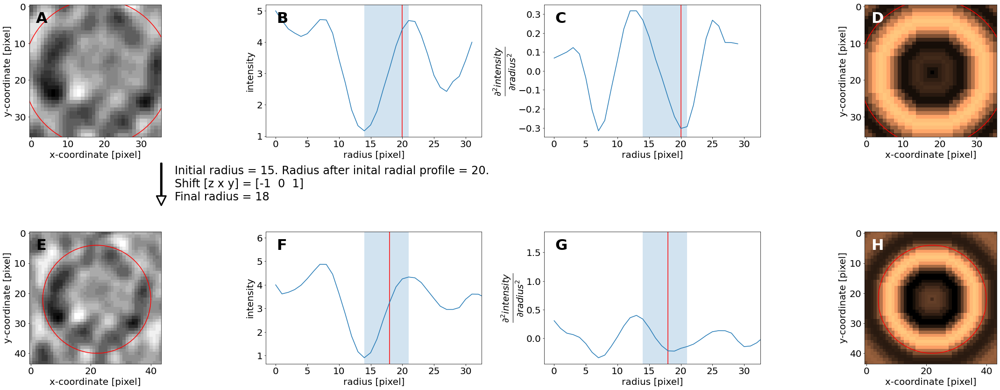

new image box shape is (62, 62, 62)
new centroid is [129 295 415]
new_optimal_radius is 27
alternative calc: 35
i is 102


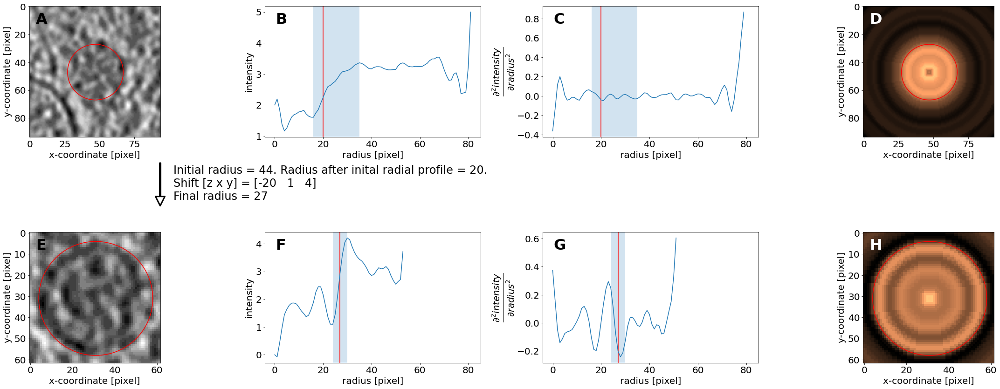

new image box shape is (44, 44, 44)
new centroid is [128 341 458]
new_optimal_radius is 18
alternative calc: 18
i is 103


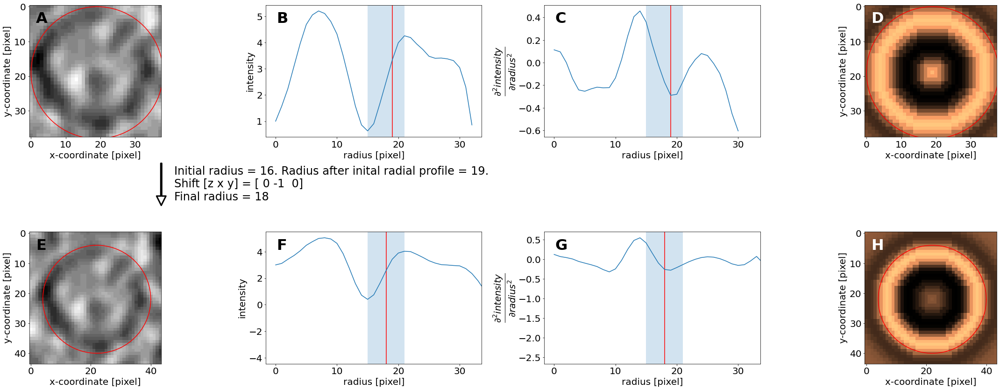

new image box shape is (42, 42, 42)
new centroid is [124 471 536]
new_optimal_radius is 17
alternative calc: 17
i is 104


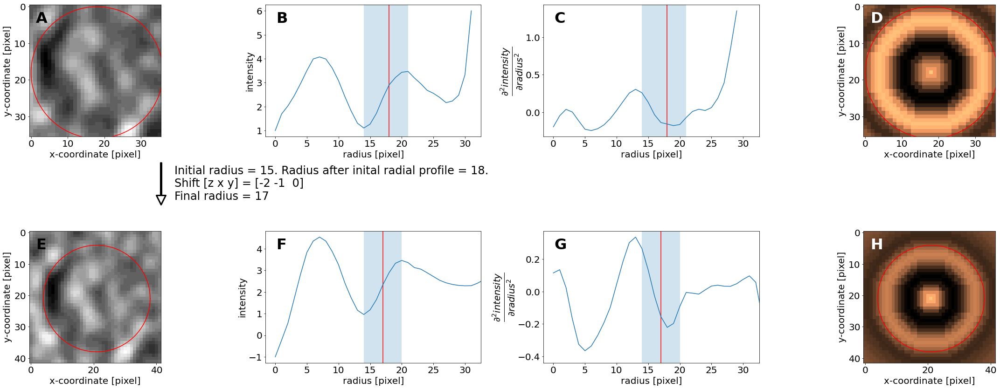

new image box shape is (16, 16, 16)
new centroid is [146 506 409]
new_optimal_radius is 4
missed 105
new image box shape is (48, 48, 48)
new centroid is [126 495 566]
new_optimal_radius is 20
alternative calc: 20
i is 106


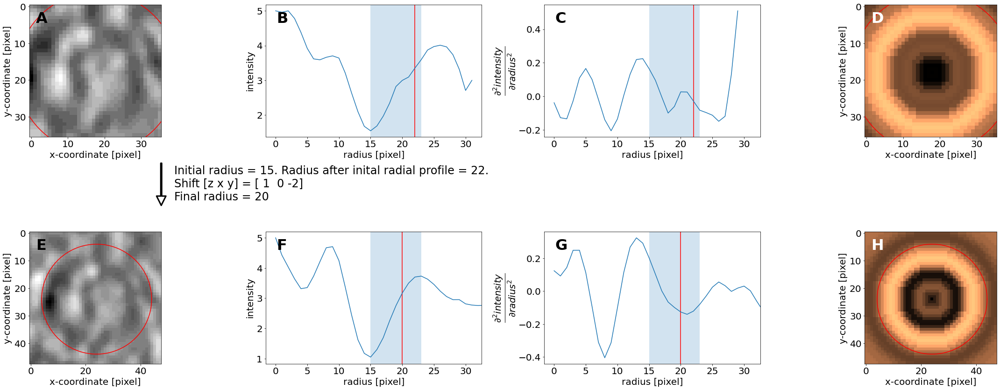

new image box shape is (46, 46, 46)
new centroid is [127 326 496]
new_optimal_radius is 19
alternative calc: 21
i is 107


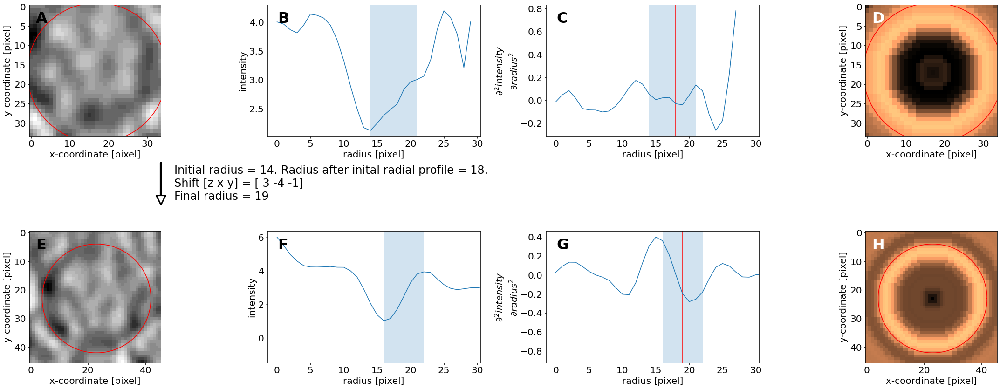

new image box shape is (42, 42, 42)
new centroid is [125 420 612]
new_optimal_radius is 17
alternative calc: 17
i is 108


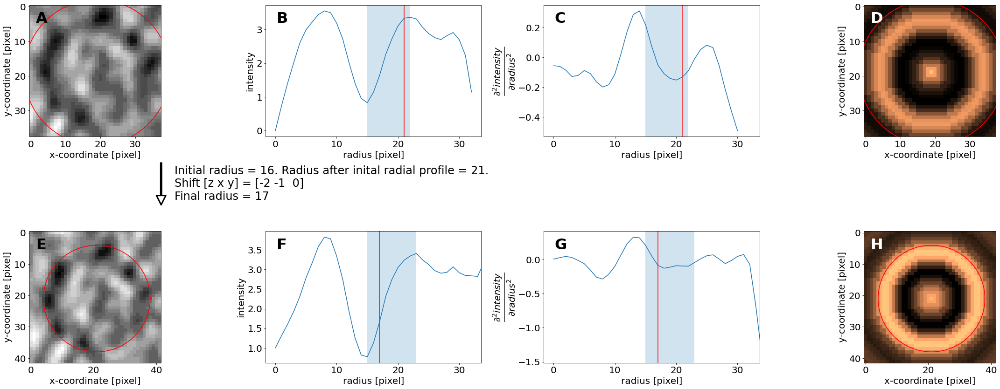

new image box shape is (46, 46, 46)
new centroid is [128 283 496]
new_optimal_radius is 19
alternative calc: 19
i is 109


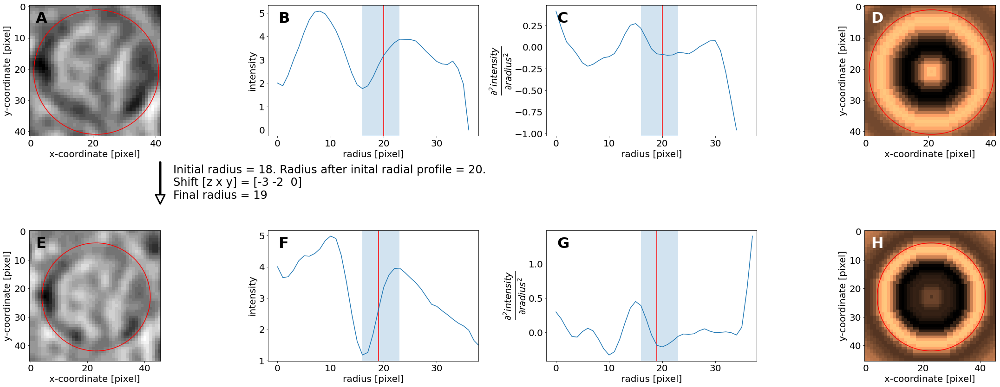

new image box shape is (44, 44, 44)
new centroid is [137 595 522]
new_optimal_radius is 18
alternative calc: 18
i is 110


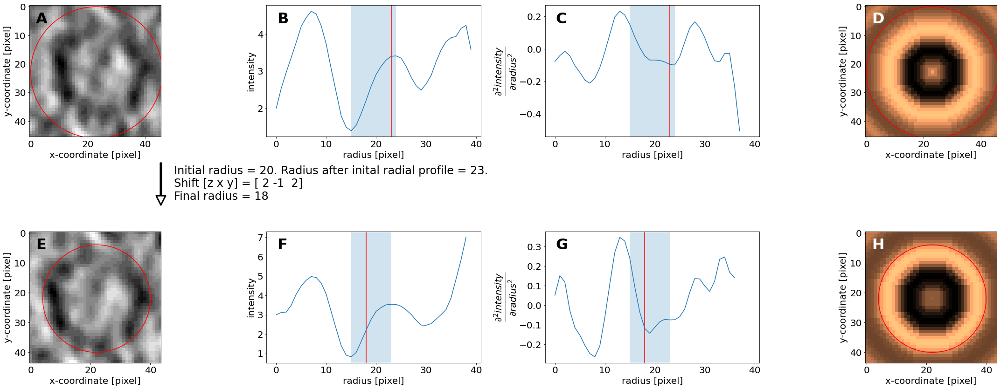

new image box shape is (48, 48, 48)
new centroid is [134 656 619]
new_optimal_radius is 20
alternative calc: 20
i is 111


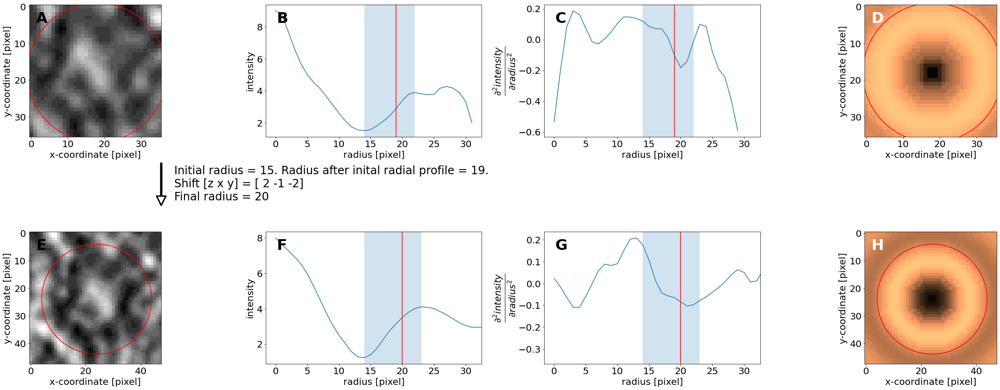

new image box shape is (50, 50, 50)
new centroid is [135  78 607]
new_optimal_radius is 21
alternative calc: 19
i is 112


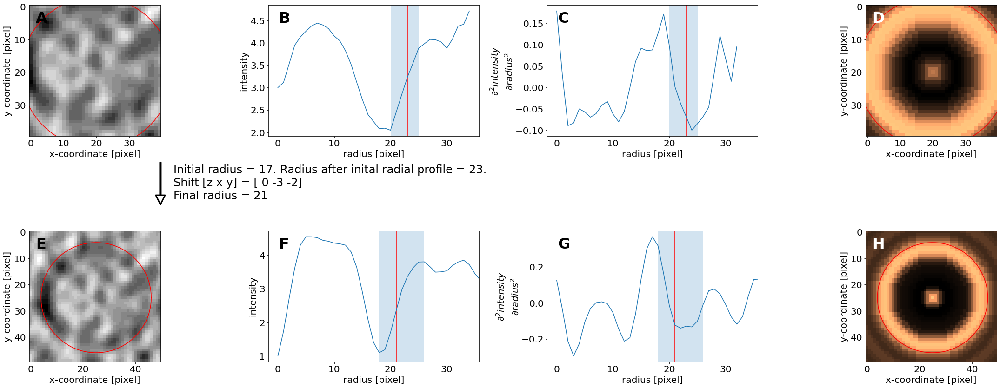

new image box shape is (48, 48, 48)
new centroid is [135 559 572]
new_optimal_radius is 20
alternative calc: 19
i is 113


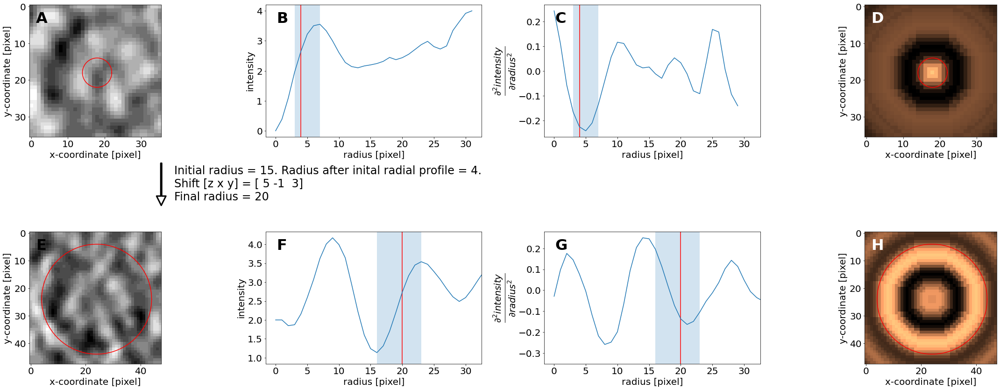

new image box shape is (52, 52, 52)
new centroid is [138 634 533]
new_optimal_radius is 22
alternative calc: 18
i is 114


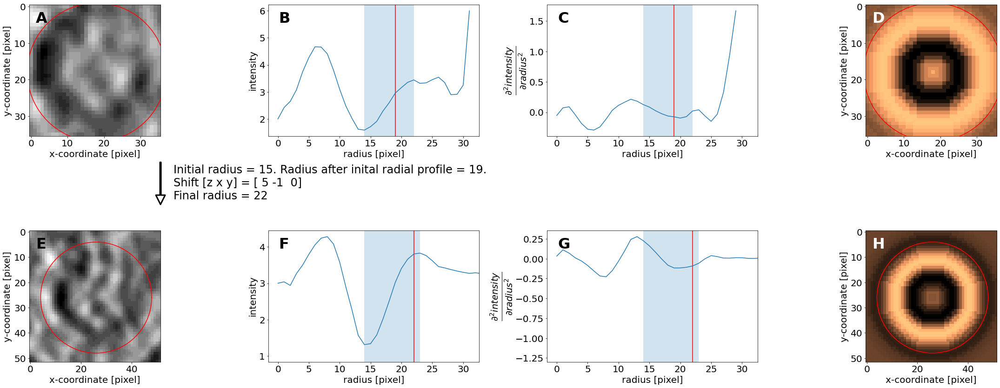

new image box shape is (48, 48, 48)
new centroid is [132 669 660]
new_optimal_radius is 20
alternative calc: 16
i is 115


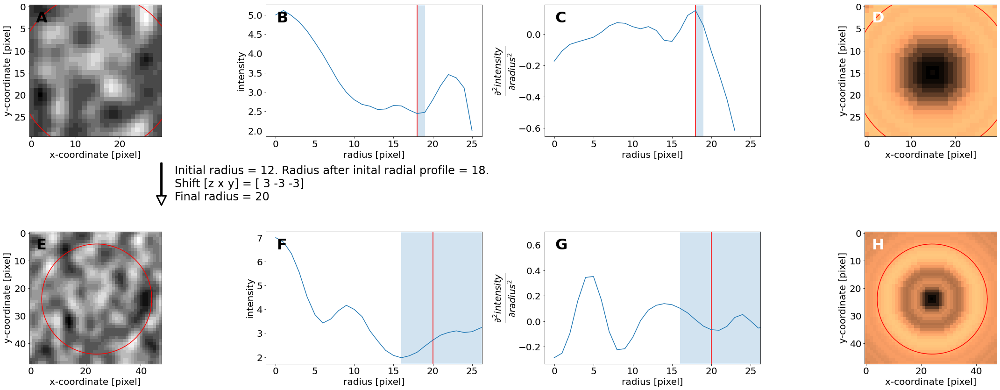

new image box shape is (36, 36, 36)
new centroid is [136 194 618]
new_optimal_radius is 14
alternative calc: 12
i is 116


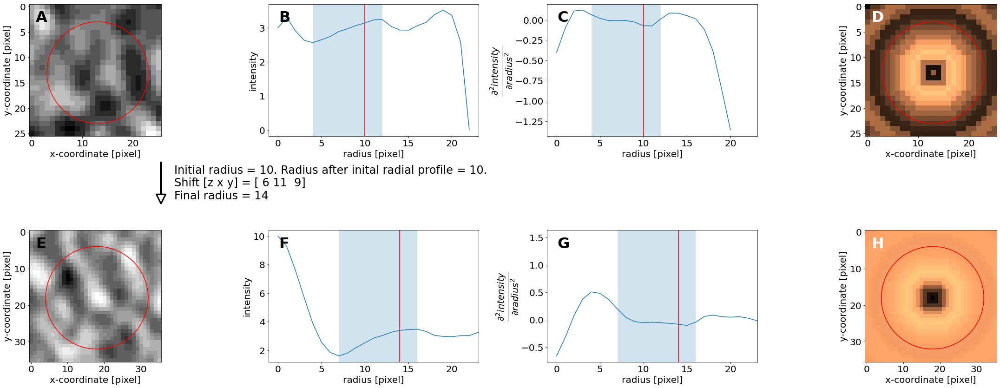

new image box shape is (40, 40, 40)
new centroid is [136 561 531]
new_optimal_radius is 16
alternative calc: 16
i is 117


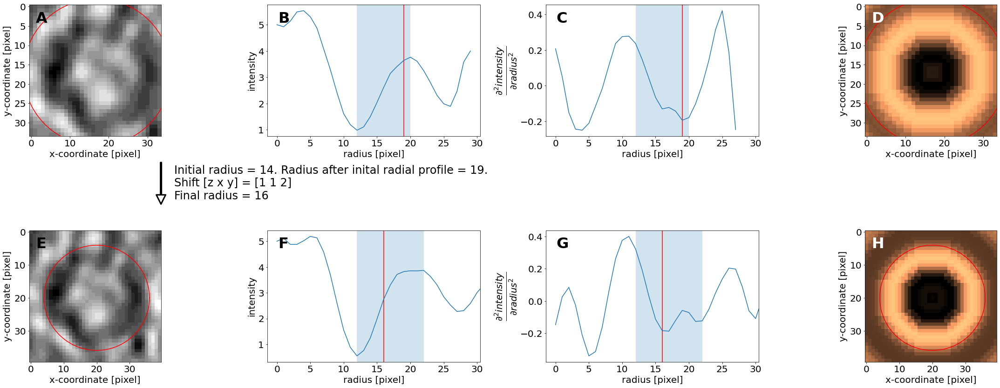

new image box shape is (46, 46, 46)
new centroid is [139 367 492]
new_optimal_radius is 19
alternative calc: 19
i is 118


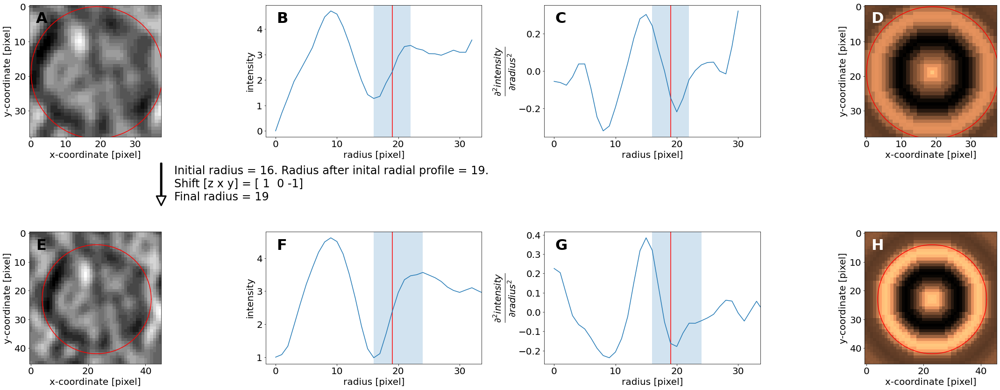

new image box shape is (52, 52, 52)
new centroid is [141 448 254]
new_optimal_radius is 22
alternative calc: 21
i is 119


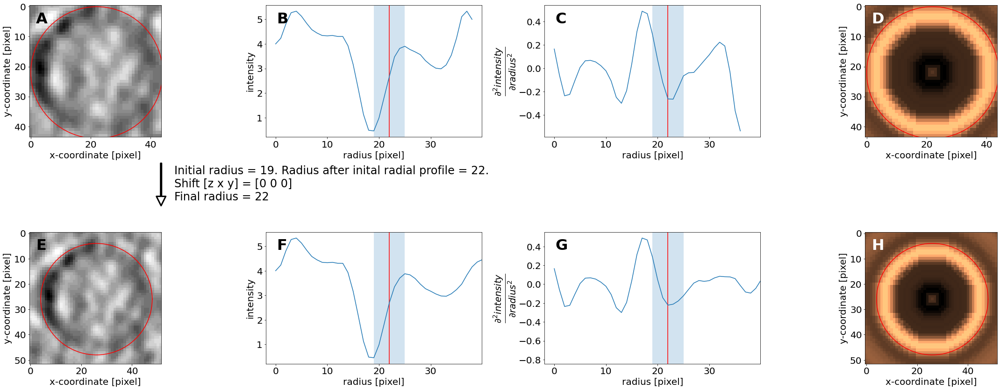

new image box shape is (46, 46, 46)
new centroid is [141 634 652]
new_optimal_radius is 19
alternative calc: 19
i is 120


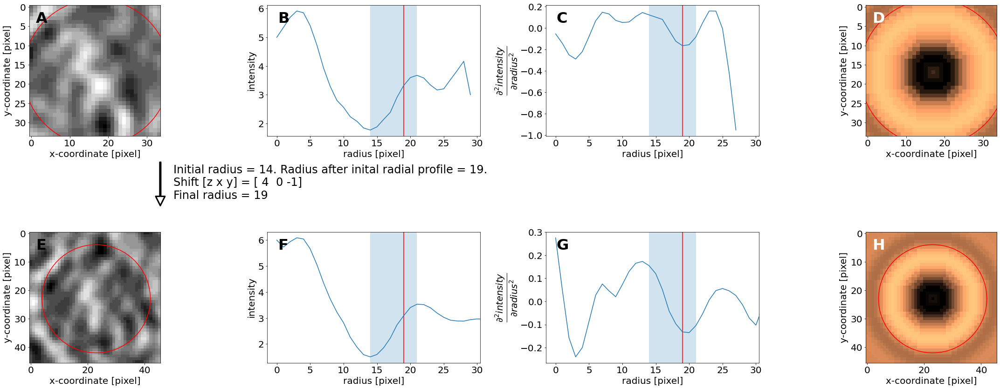

new image box shape is (48, 48, 48)
new centroid is [144 237 618]
new_optimal_radius is 20
alternative calc: 20
i is 121


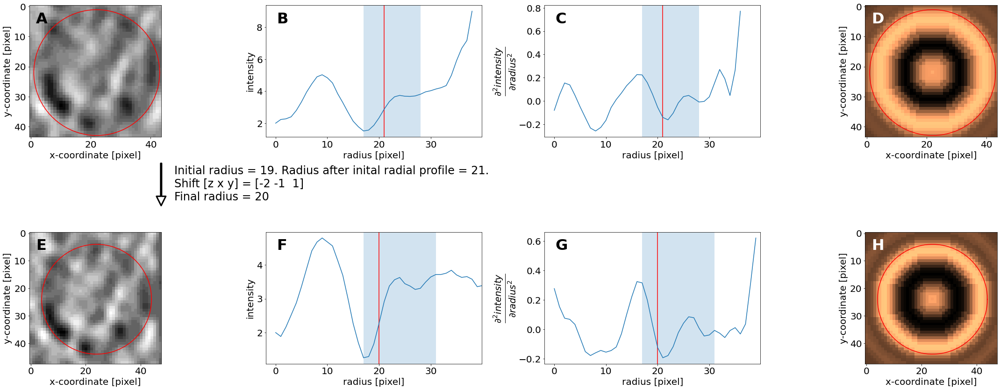

new image box shape is (44, 44, 44)
new centroid is [137 277 593]
new_optimal_radius is 18
alternative calc: 18
i is 122


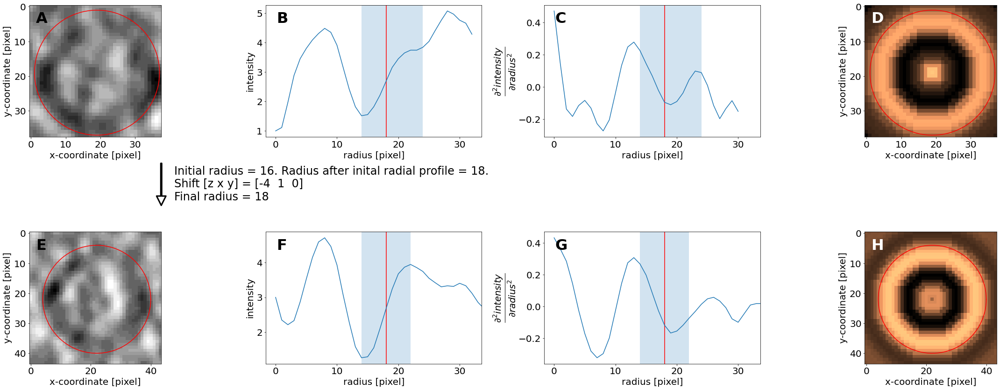

new image box shape is (44, 44, 44)
new centroid is [142 435 472]
new_optimal_radius is 18
alternative calc: 19
i is 123


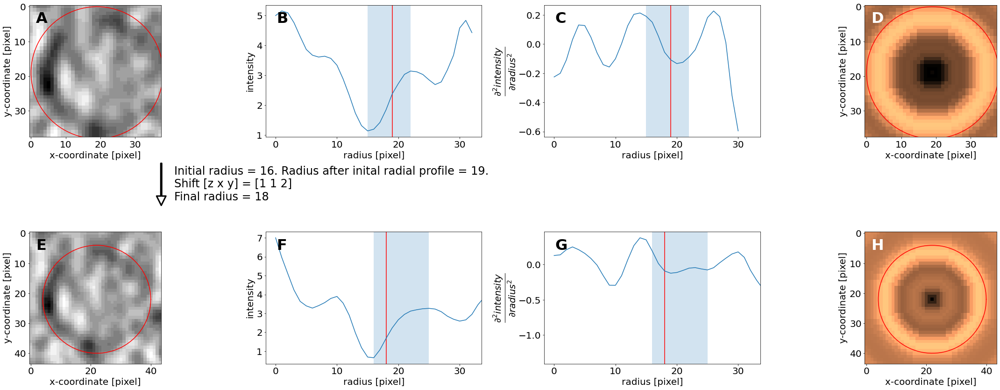

new image box shape is (46, 46, 46)
new centroid is [142 361 533]
new_optimal_radius is 19
alternative calc: 20
i is 124


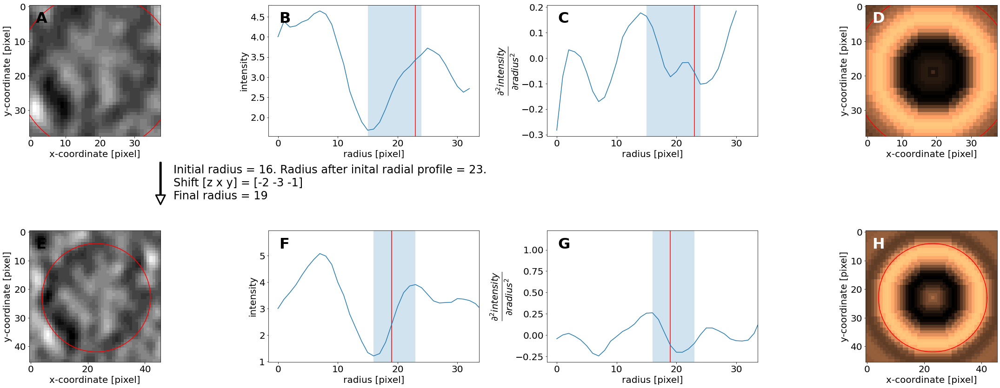

new image box shape is (42, 42, 42)
new centroid is [140 437 545]
new_optimal_radius is 17
alternative calc: 18
i is 125


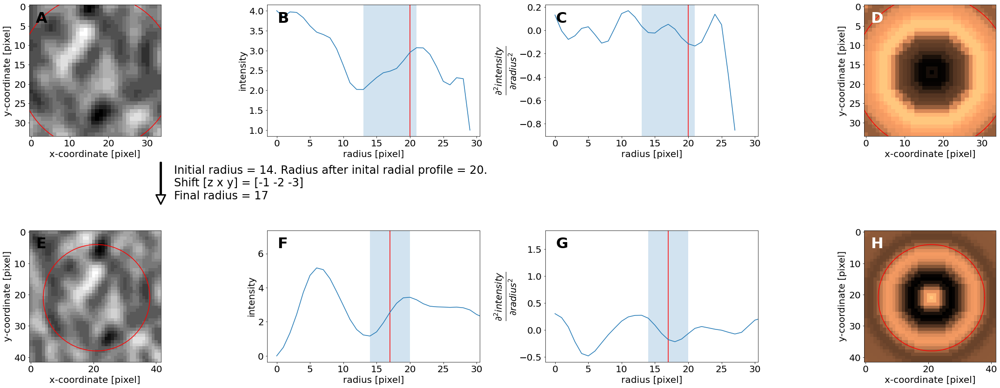

new image box shape is (46, 46, 46)
new centroid is [146 591 594]
new_optimal_radius is 19
alternative calc: 20
i is 126


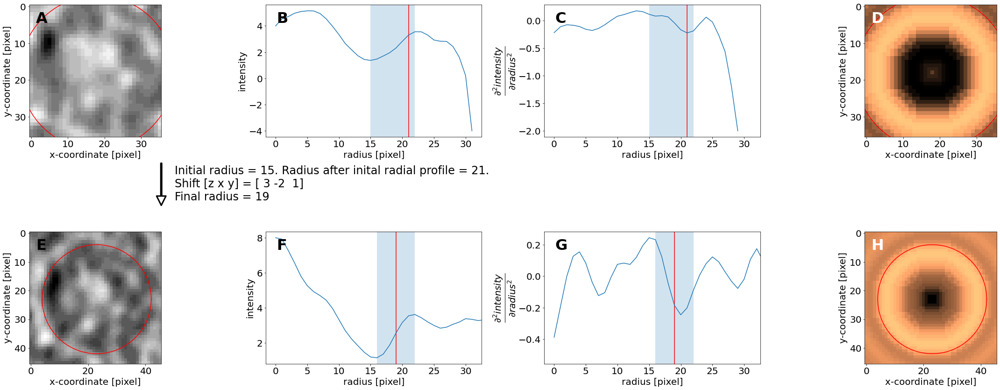

new image box shape is (34, 34, 34)
new centroid is [137 119 600]
new_optimal_radius is 13
alternative calc: 16
i is 127


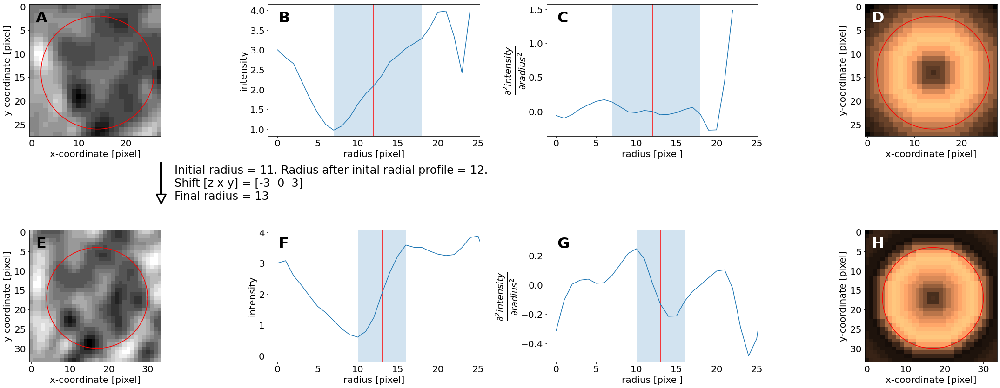

new image box shape is (44, 44, 44)
new centroid is [142 305 465]
new_optimal_radius is 18
alternative calc: 18
i is 128


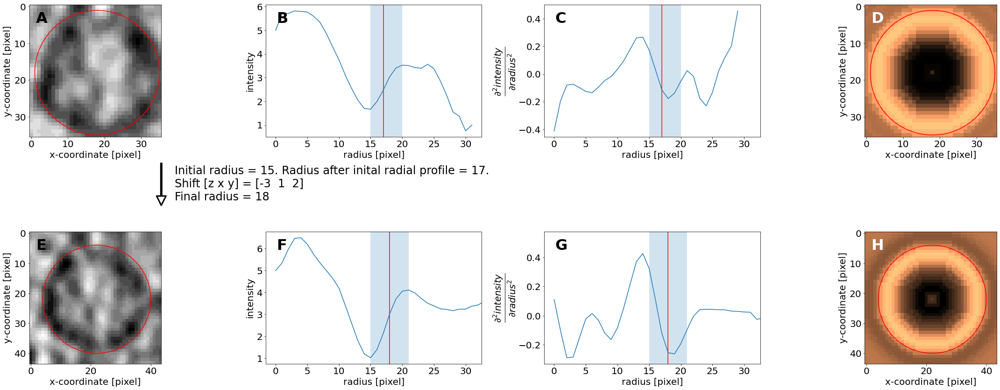

new image box shape is (42, 42, 42)
new centroid is [144 342 625]
new_optimal_radius is 17
alternative calc: 17
i is 129


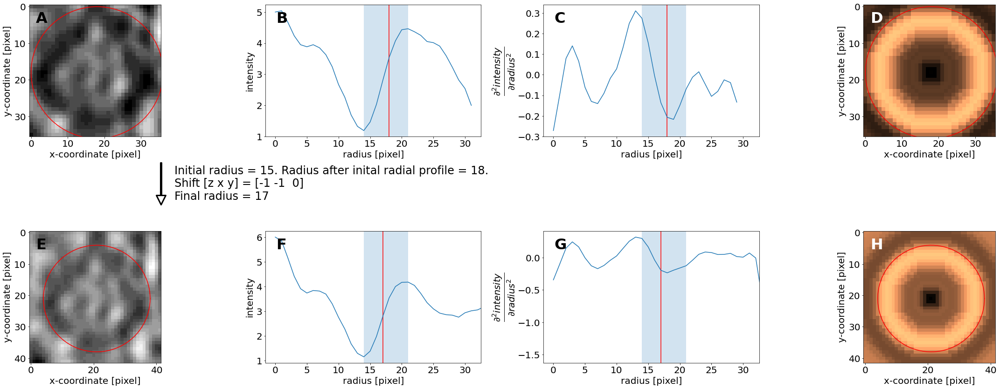

new image box shape is (44, 44, 44)
new centroid is [139 169 545]
new_optimal_radius is 18
alternative calc: 10
i is 130


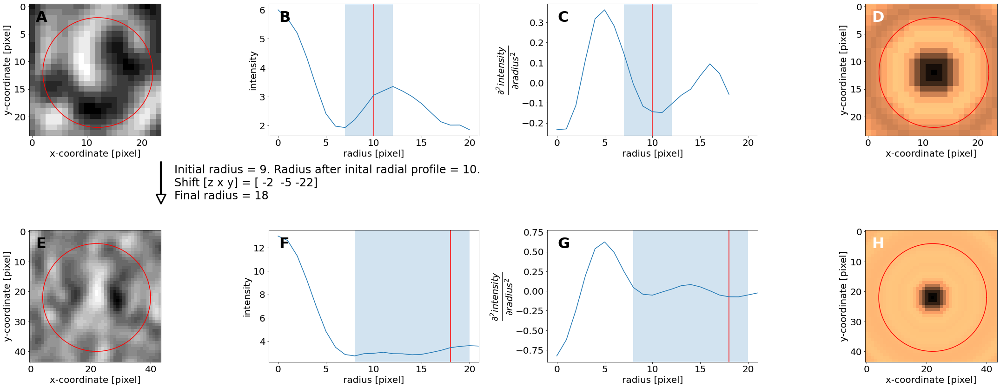

new image box shape is (44, 44, 44)
new centroid is [152 315 574]
new_optimal_radius is 18
alternative calc: 18
i is 131


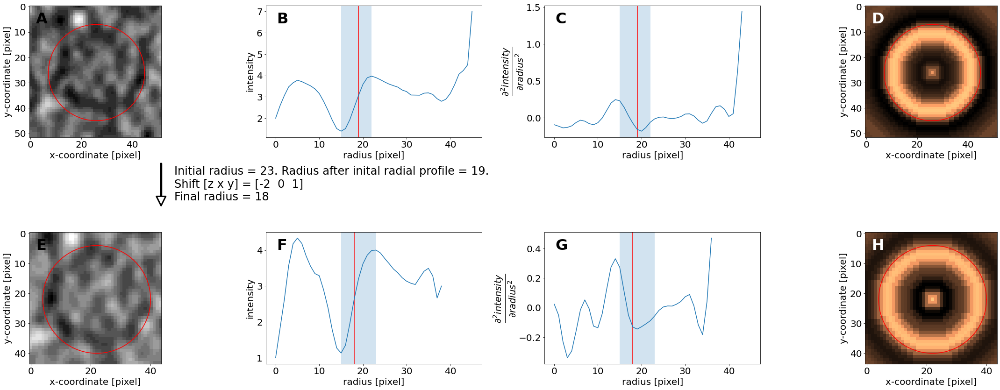

new image box shape is (36, 36, 36)
new centroid is [148 225 400]
new_optimal_radius is 14
alternative calc: 12
i is 132


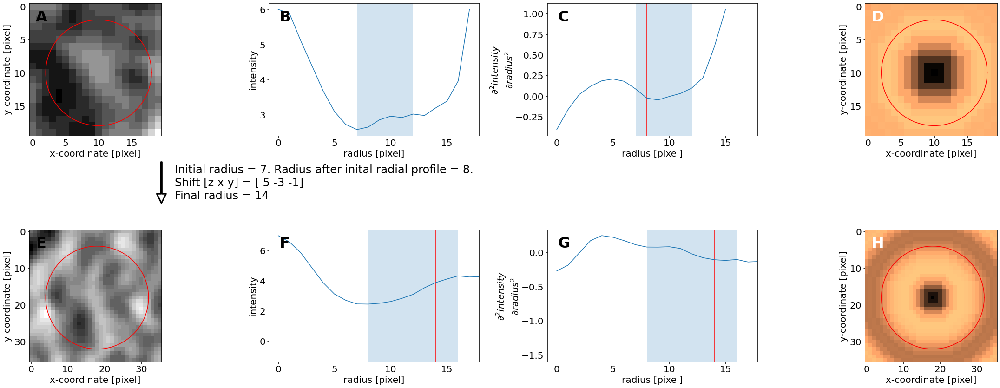

new image box shape is (44, 44, 44)
new centroid is [152 281 550]
new_optimal_radius is 18
alternative calc: 19
i is 133


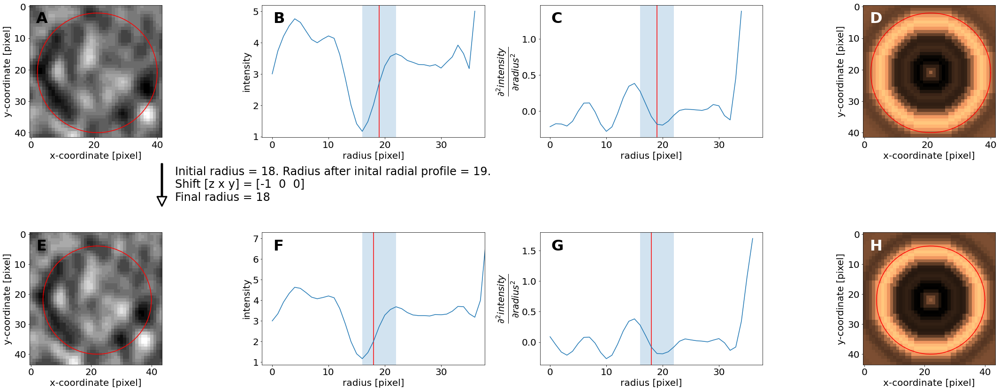

new image box shape is (36, 36, 36)
new centroid is [175 415 380]
new_optimal_radius is 14
alternative calc: 15
i is 134


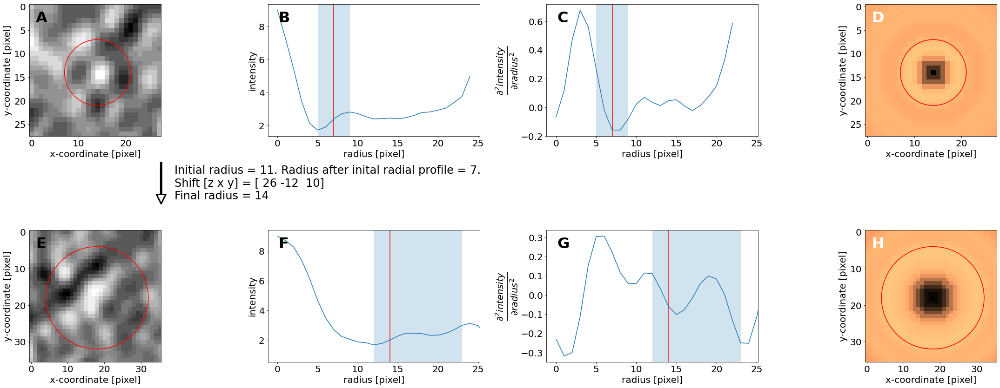

new image box shape is (42, 42, 42)
new centroid is [152 232 573]
new_optimal_radius is 17
alternative calc: 17
i is 135


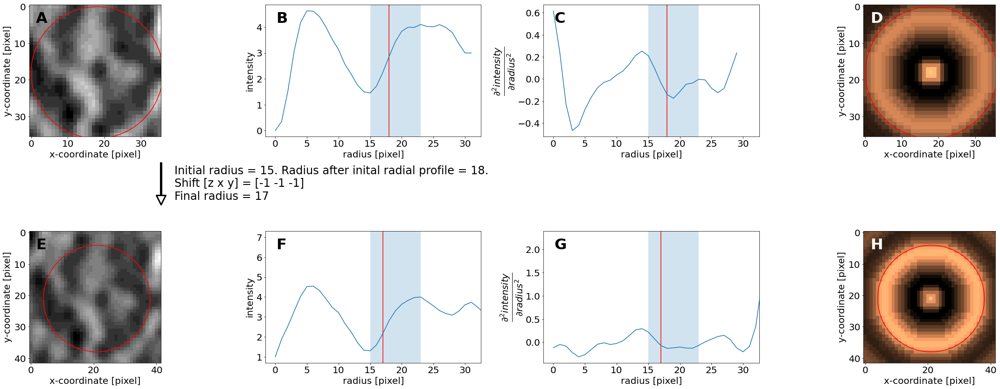

new image box shape is (12, 12, 12)
new centroid is [141 512 482]
new_optimal_radius is 2
missed 136
new image box shape is (42, 42, 42)
new centroid is [157 319 534]
new_optimal_radius is 17
alternative calc: 17
i is 137


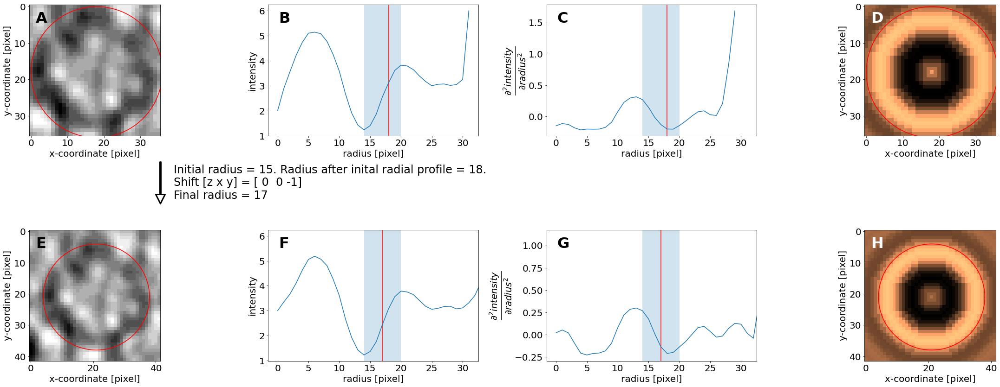

new image box shape is (34, 34, 34)
new centroid is [142 519 508]
new_optimal_radius is 13
alternative calc: 13
i is 138


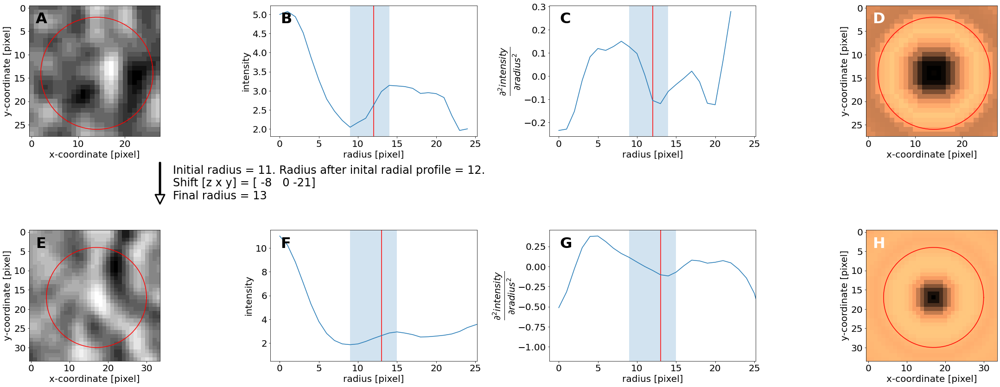

new image box shape is (46, 46, 46)
new centroid is [158 362 574]
new_optimal_radius is 19
alternative calc: 18
i is 139


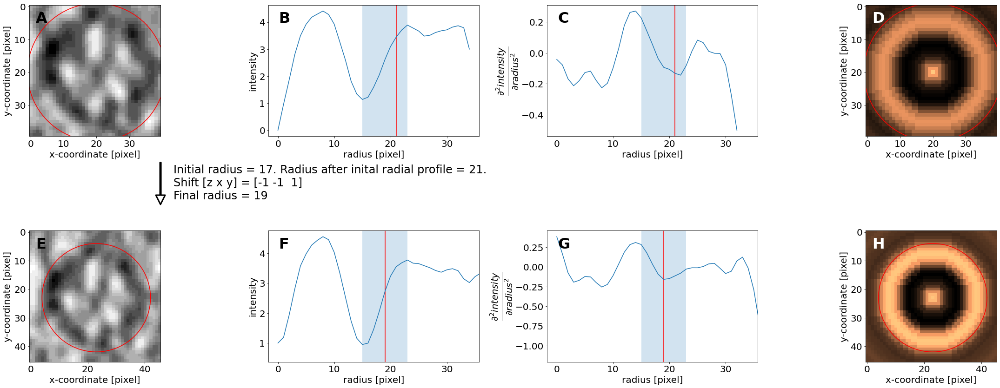

new image box shape is (44, 44, 44)
new centroid is [158 608 628]
new_optimal_radius is 18
alternative calc: 20
i is 140


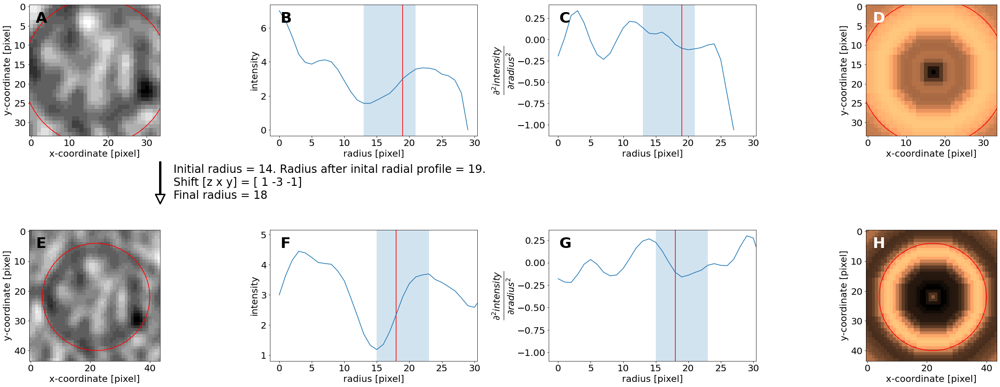

new image box shape is (38, 38, 38)
new centroid is [132 550 552]
new_optimal_radius is 15
alternative calc: 18
i is 141


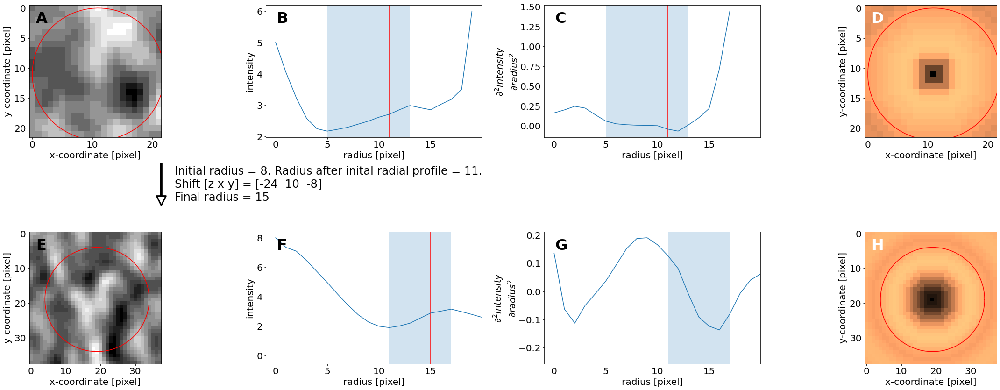

new image box shape is (48, 48, 48)
new centroid is [164 442 614]
new_optimal_radius is 20
alternative calc: 19
i is 142


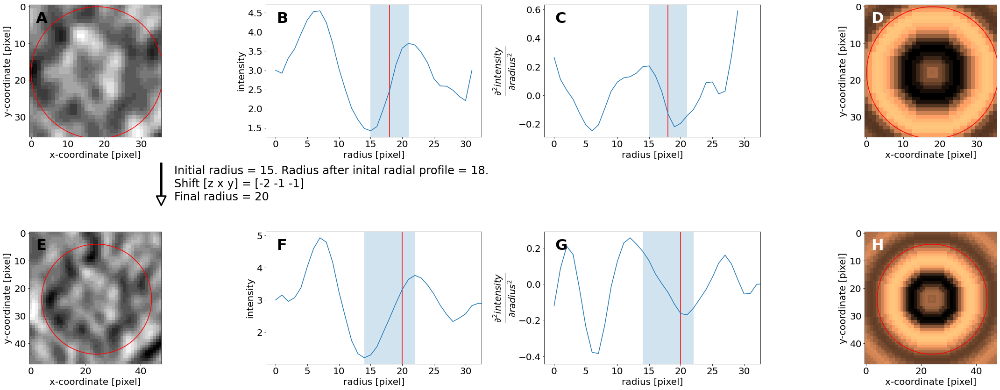

new image box shape is (14, 14, 14)
new centroid is [176 363 328]
new_optimal_radius is 3
alternative calc: 6
i is 143


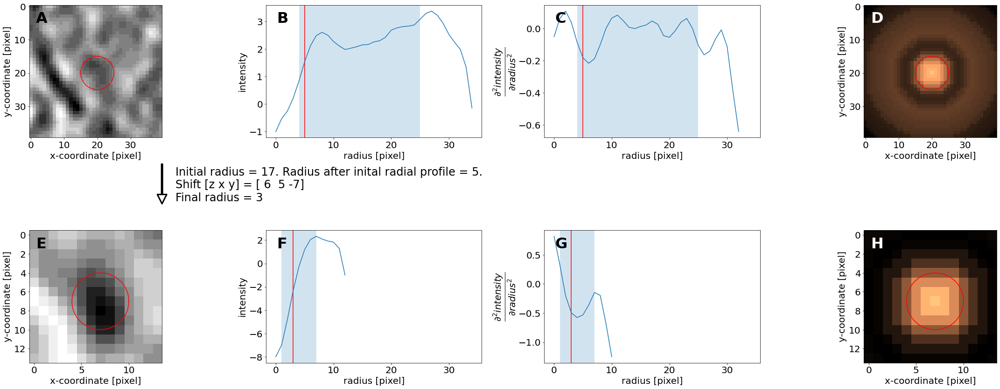

new image box shape is (50, 50, 50)
new centroid is [169 479 518]
new_optimal_radius is 21
alternative calc: 23
i is 144


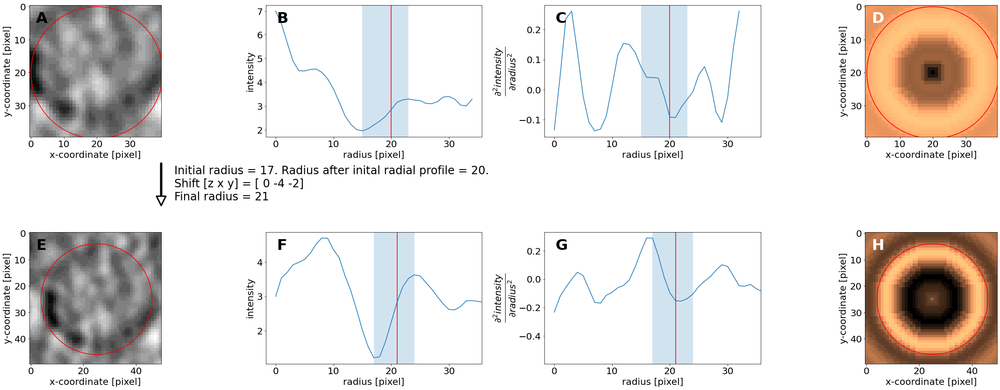

new image box shape is (40, 40, 40)
new centroid is [164 495 559]
new_optimal_radius is 16
alternative calc: 17
i is 145


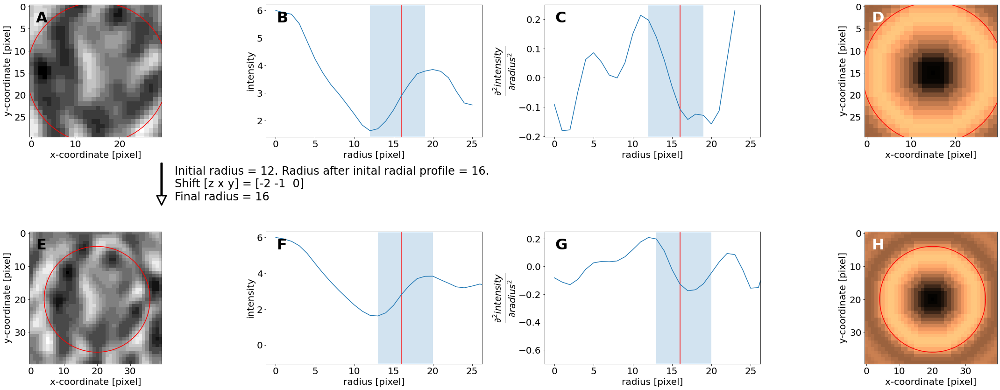

new image box shape is (46, 46, 46)
new centroid is [162 680 647]
new_optimal_radius is 19
alternative calc: 15
i is 146


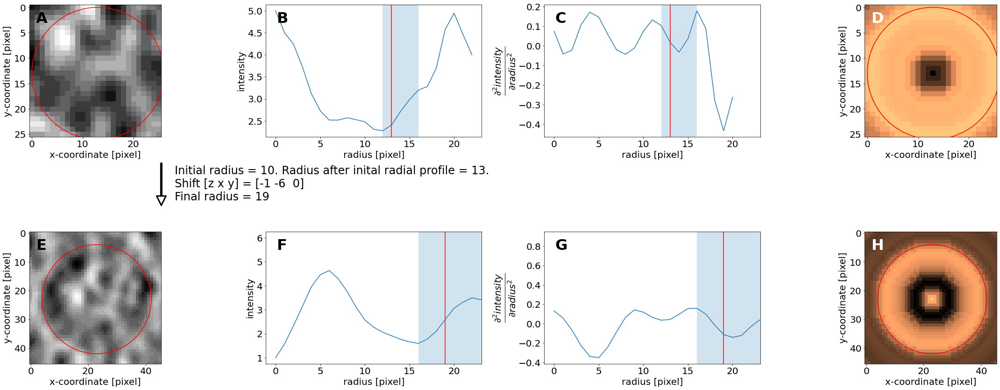

new image box shape is (38, 38, 38)
new centroid is [165 259 440]
new_optimal_radius is 15
alternative calc: 16
i is 147


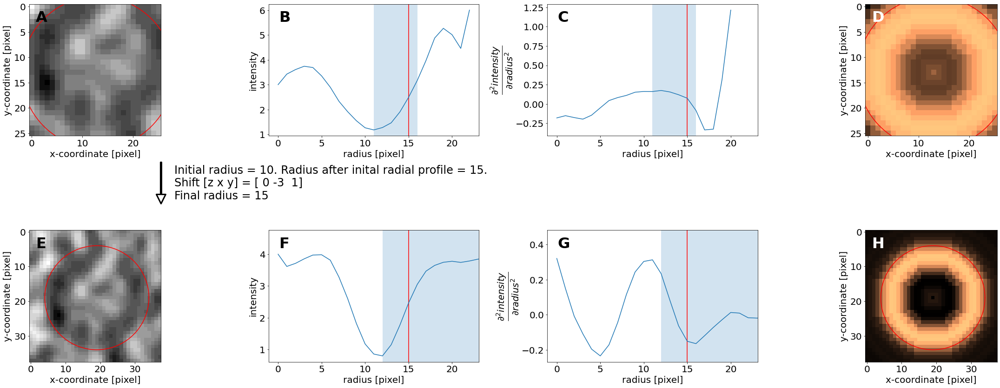

new image box shape is (44, 44, 44)
new centroid is [171 398 558]
new_optimal_radius is 18
alternative calc: 19
i is 148


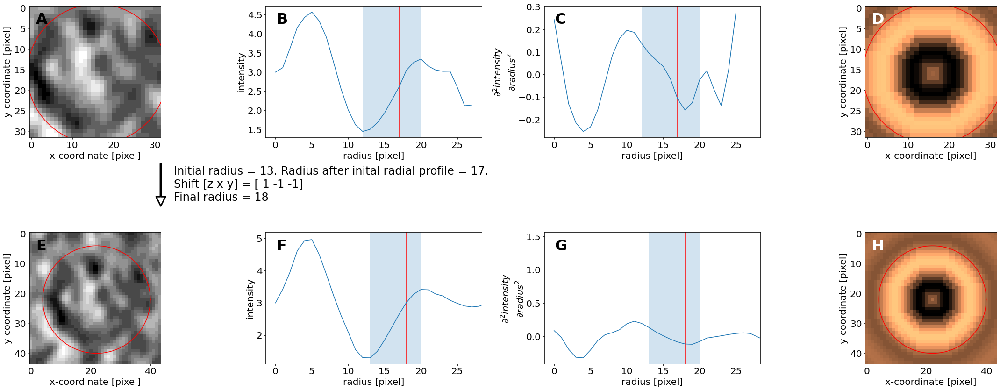

new image box shape is (44, 44, 44)
new centroid is [178 417 431]
new_optimal_radius is 18
alternative calc: 10
i is 149


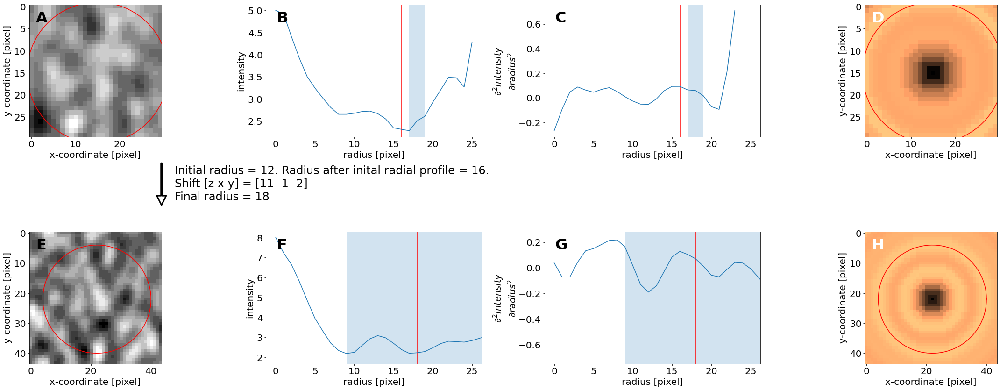

new image box shape is (44, 44, 44)
new centroid is [170 463 480]
new_optimal_radius is 18
alternative calc: 19
i is 150


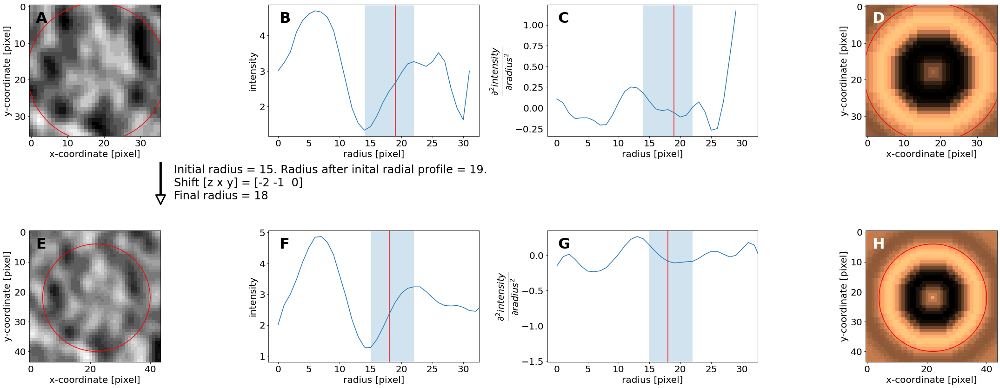

new image box shape is (32, 32, 32)
new centroid is [190 460 374]
new_optimal_radius is 12
alternative calc: 7
i is 151


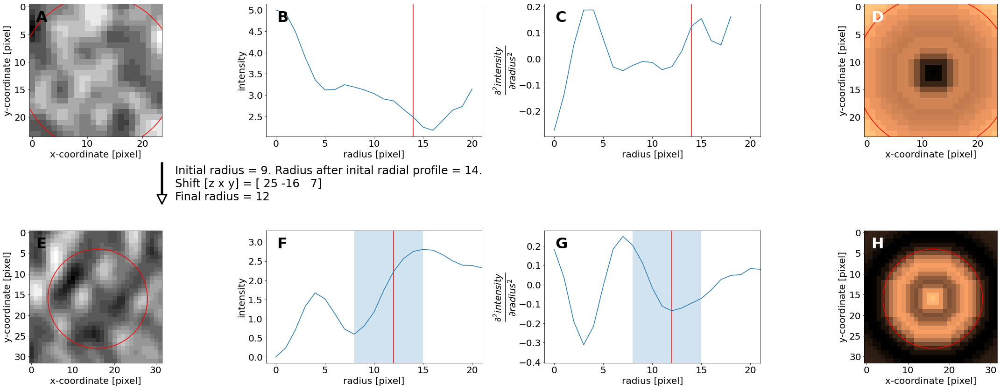

new image box shape is (44, 44, 44)
new centroid is [182 204 610]
new_optimal_radius is 18
alternative calc: 17
i is 152


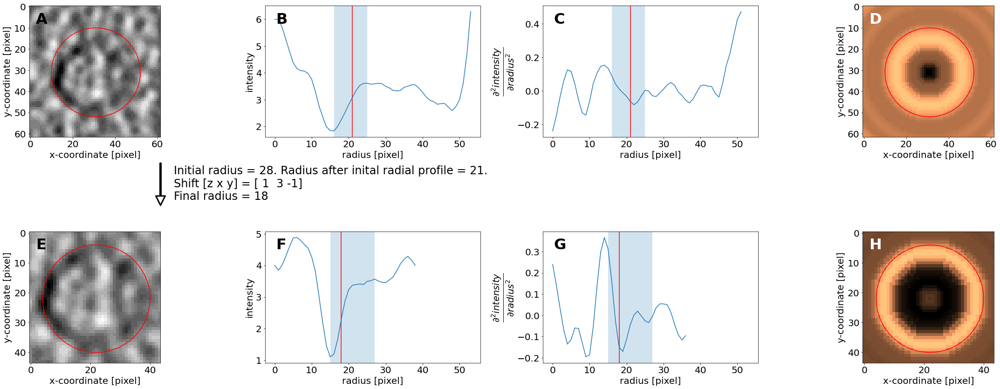

new image box shape is (40, 40, 40)
new centroid is [172 377 612]
new_optimal_radius is 16
alternative calc: 16
i is 153


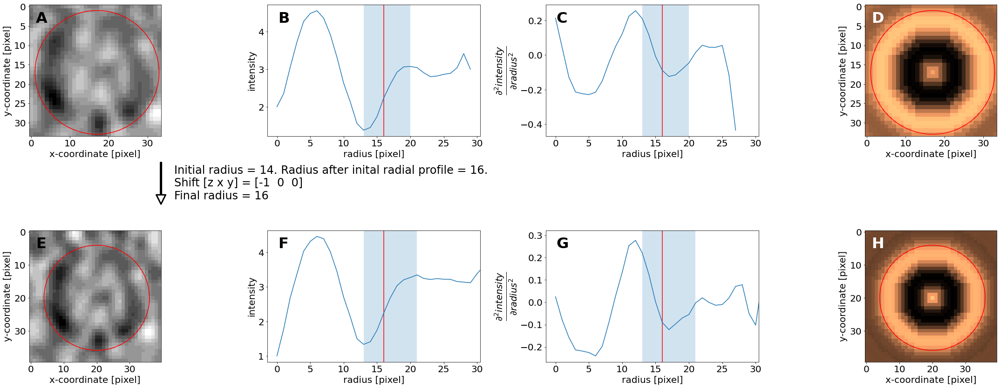

new image box shape is (48, 48, 48)
new centroid is [173 412 255]
new_optimal_radius is 20
alternative calc: 17
i is 154


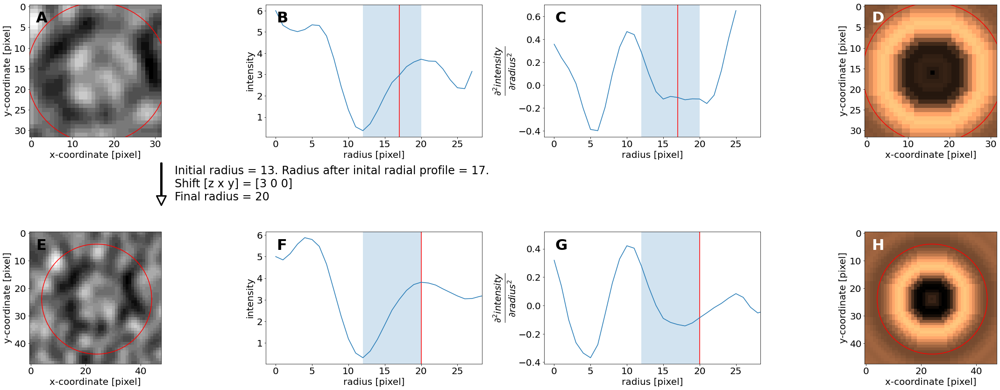

new image box shape is (44, 44, 44)
new centroid is [176 367 475]
new_optimal_radius is 18
alternative calc: 18
i is 155


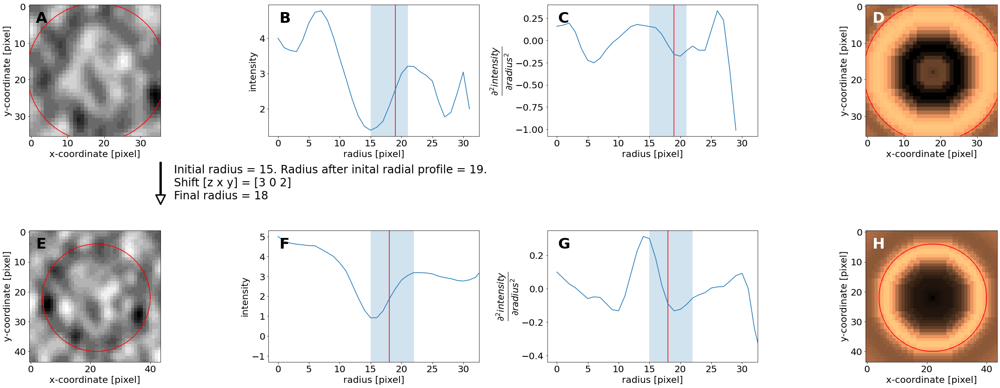

new image box shape is (44, 44, 44)
new centroid is [170 565 576]
new_optimal_radius is 18
alternative calc: 19
i is 156


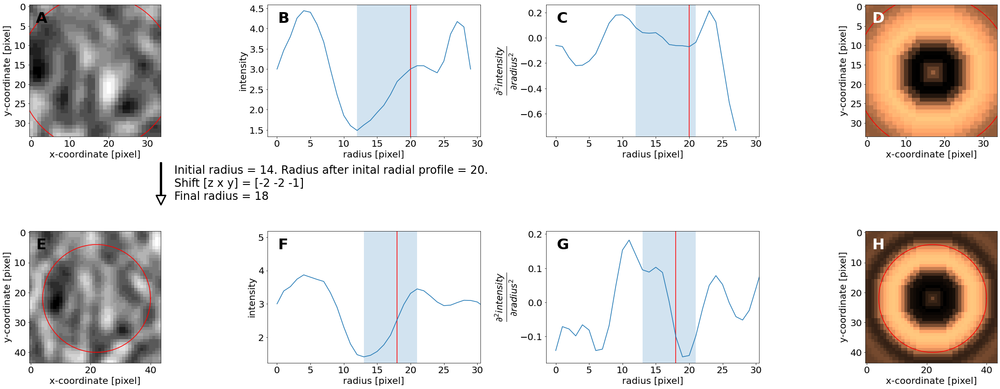

new image box shape is (40, 40, 40)
new centroid is [176 435 527]
new_optimal_radius is 16
alternative calc: 16
i is 157


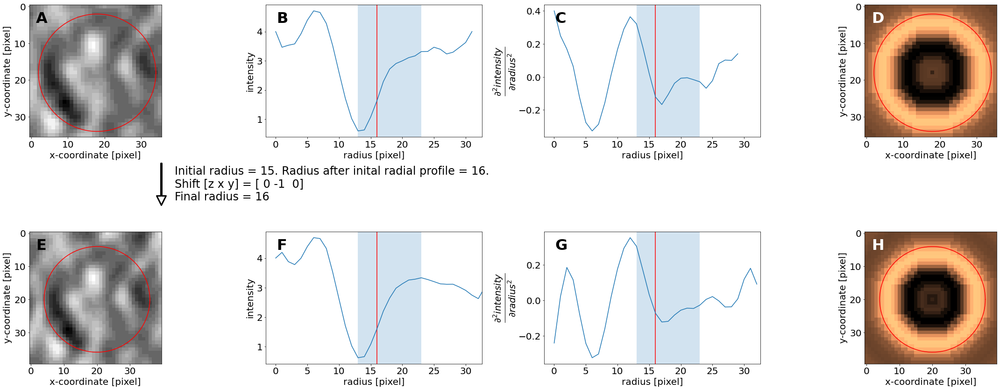

new image box shape is (44, 44, 44)
new centroid is [204 510 466]
new_optimal_radius is 22
alternative calc: 41
i is 158


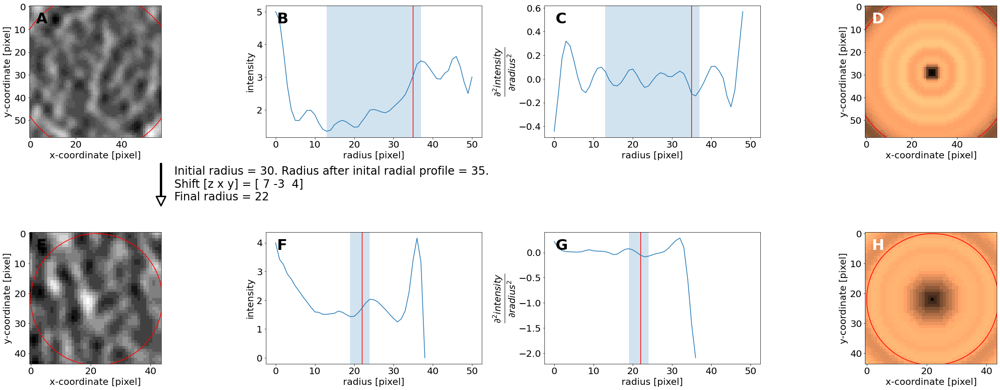

new image box shape is (46, 46, 46)
new centroid is [184 289 625]
new_optimal_radius is 19
alternative calc: 19
i is 159


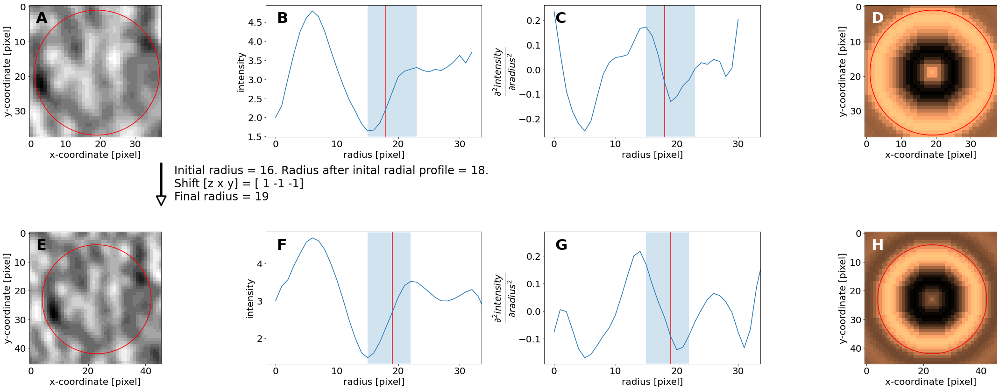

new image box shape is (46, 46, 46)
new centroid is [186 422 640]
new_optimal_radius is 19
alternative calc: 19
i is 160


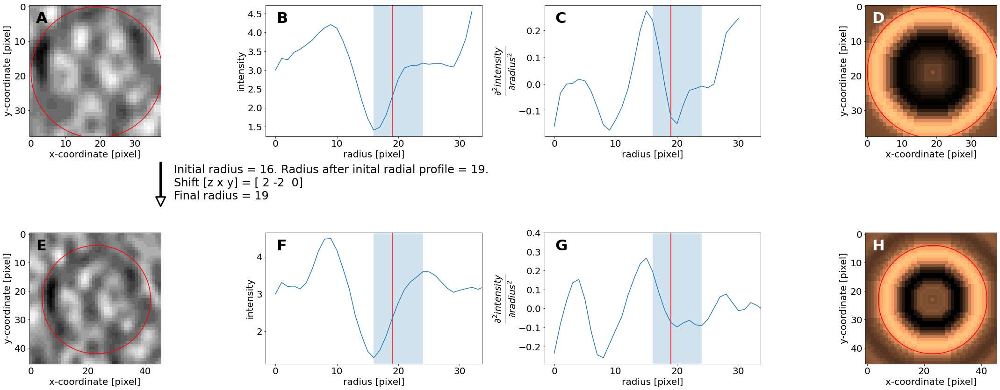

new image box shape is (16, 16, 16)
new centroid is [178 559 525]
new_optimal_radius is 4
alternative calc: 3
i is 161


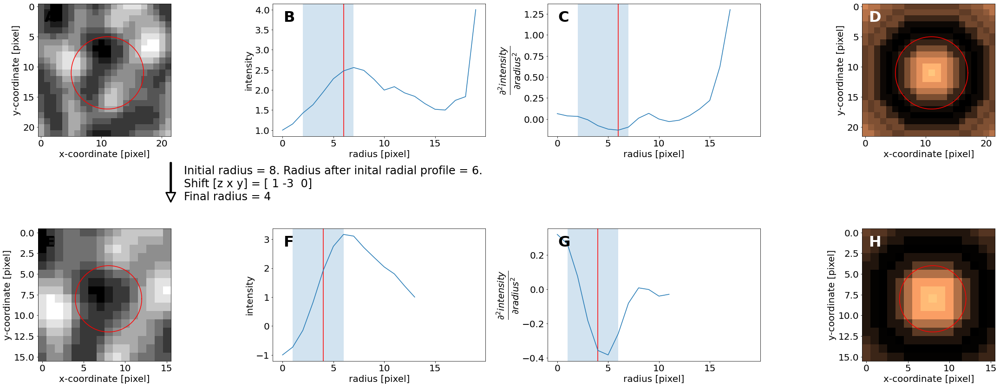

new image box shape is (46, 46, 46)
new centroid is [192 337 530]
new_optimal_radius is 19
alternative calc: 20
i is 162


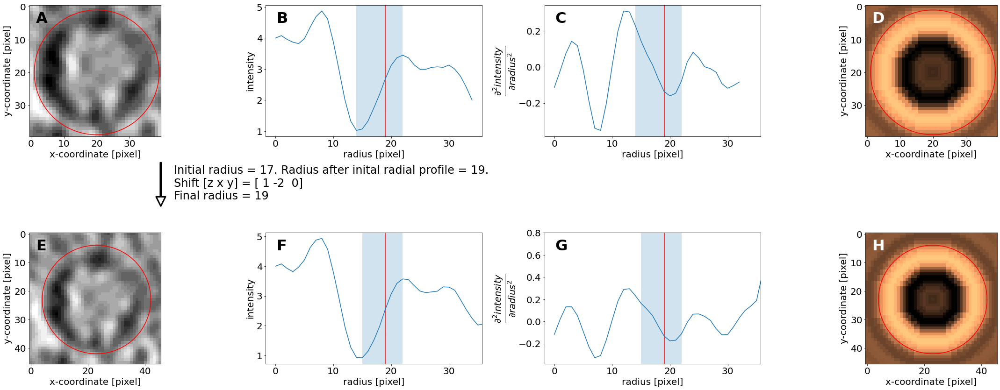

new image box shape is (18, 18, 18)
new centroid is [190 462 377]
new_optimal_radius is 5
alternative calc: 4
i is 163


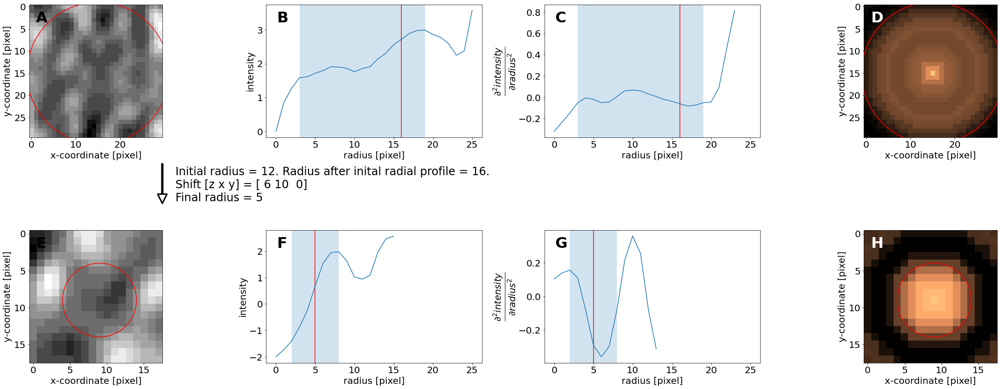

new image box shape is (40, 40, 40)
new centroid is [190 418 594]
new_optimal_radius is 16
alternative calc: 15
i is 164


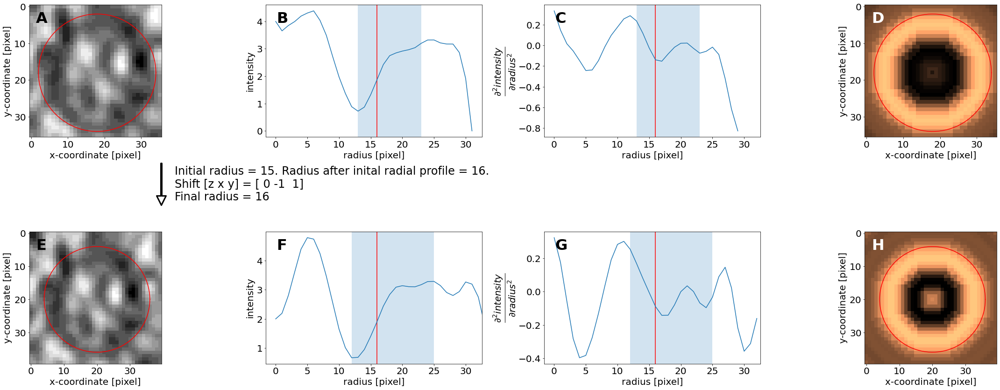

new image box shape is (26, 26, 26)
new centroid is [195 506 404]
new_optimal_radius is 9
alternative calc: 6
i is 165


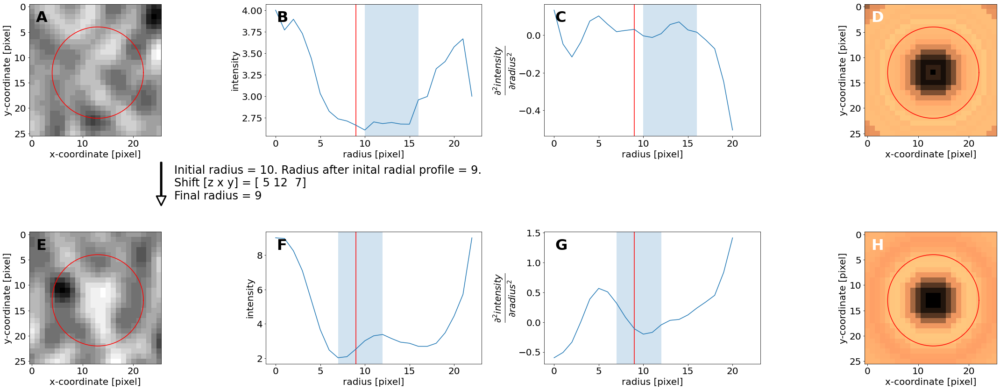

new image box shape is (46, 46, 46)
new centroid is [197 571 505]
new_optimal_radius is 19
alternative calc: 3
i is 166


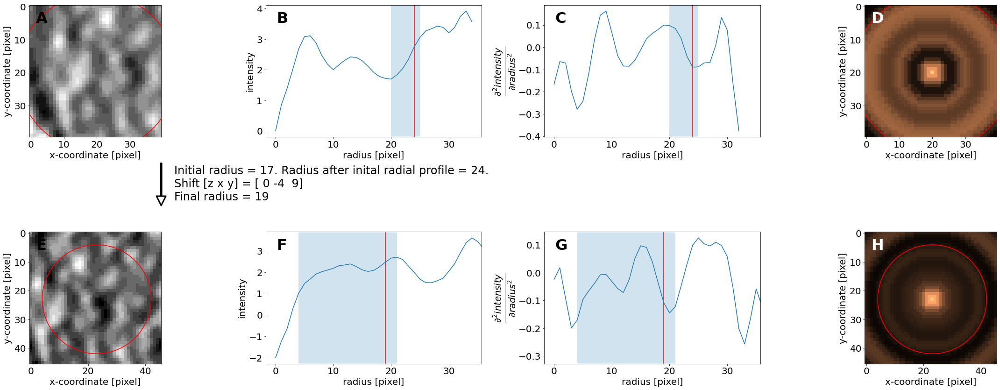

new image box shape is (46, 46, 46)
new centroid is [182 612 588]
new_optimal_radius is 19
alternative calc: 17
i is 167


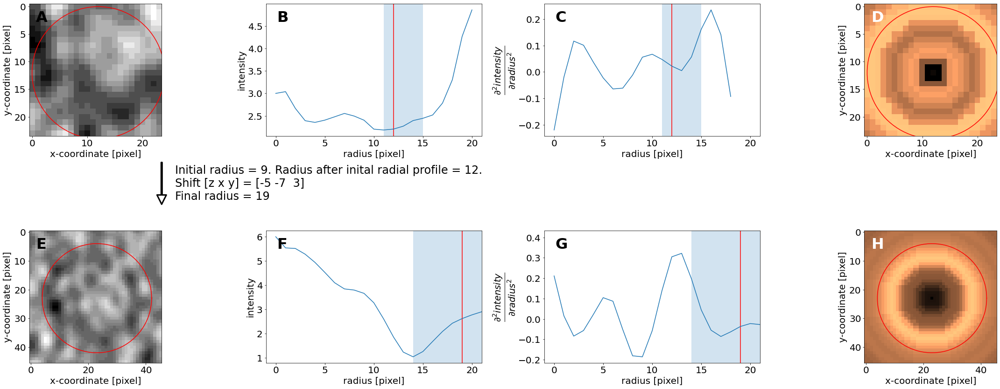

new image box shape is (46, 46, 46)
new centroid is [199 272 582]
new_optimal_radius is 19
alternative calc: 19
i is 168


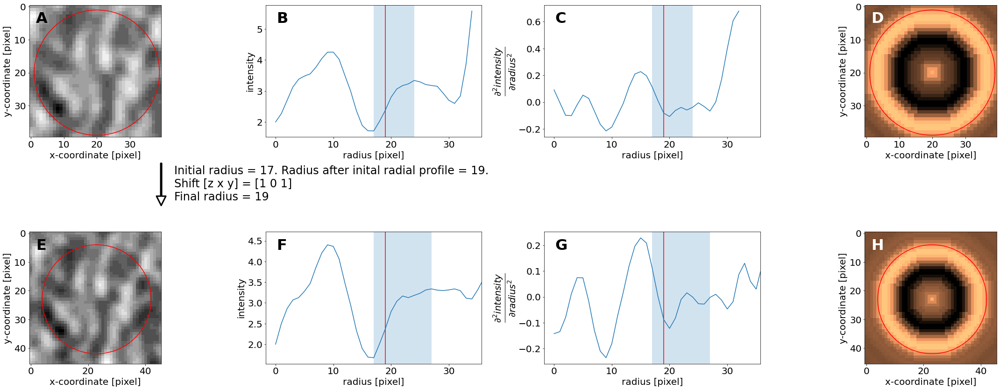

new image box shape is (42, 42, 42)
new centroid is [200 344 494]
new_optimal_radius is 17
alternative calc: 13
i is 169


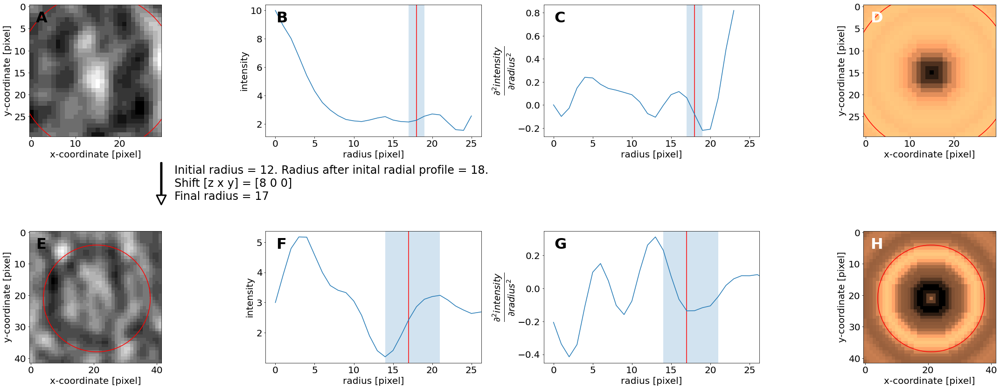

new image box shape is (46, 46, 46)
new centroid is [203 581 537]
new_optimal_radius is 21
alternative calc: 21
i is 170


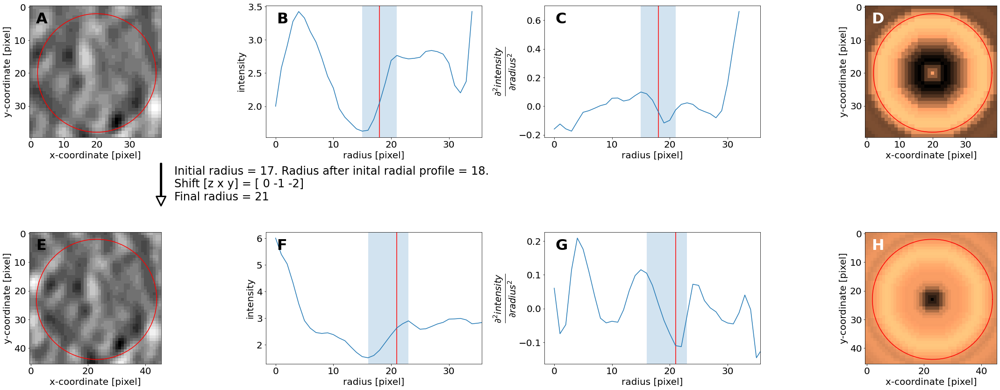

new image box shape is (18, 18, 18)
new centroid is [201 375 413]
new_optimal_radius is 5
alternative calc: 1
i is 171


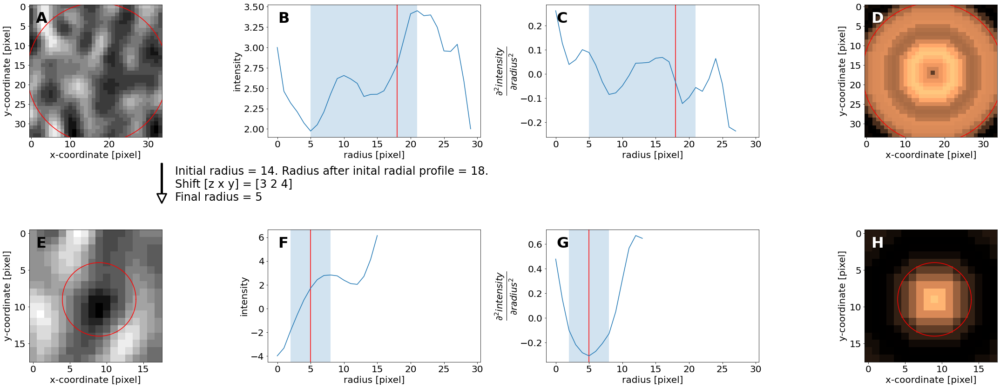

new image box shape is (44, 44, 44)
new centroid is [204 452 618]
new_optimal_radius is 21
alternative calc: 22
i is 172


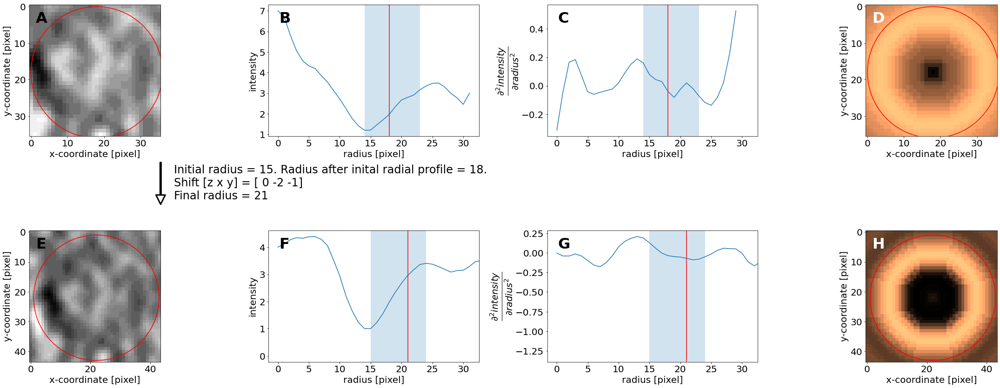

new image box shape is (36, 36, 36)
new centroid is [208 515 579]
new_optimal_radius is 19
alternative calc: 19
i is 173


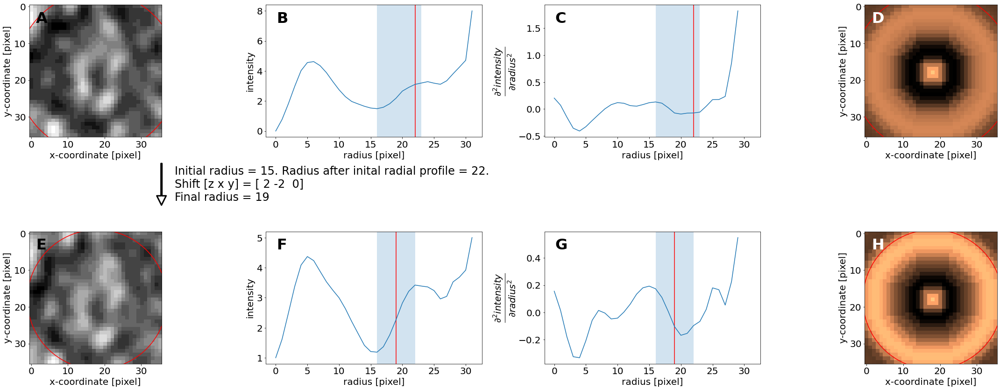

new image box shape is (30, 30, 30)
new centroid is [211 354 457]
new_optimal_radius is 18
alternative calc: 18
i is 174


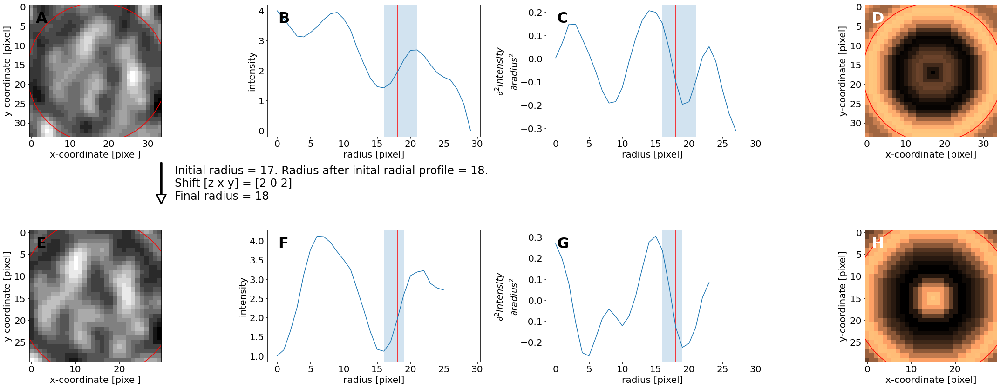

new image box shape is (34, 34, 34)
new centroid is [209 362 584]
new_optimal_radius is 19
alternative calc: 19
i is 175


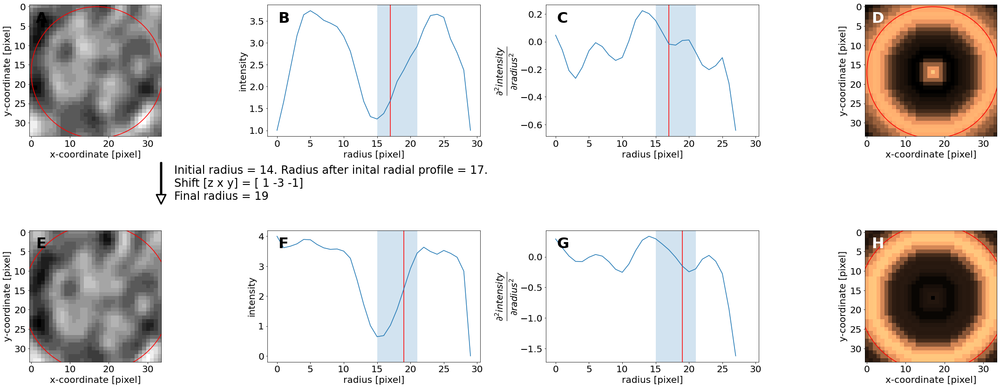

new image box shape is (28, 28, 28)
new centroid is [212 382 485]
new_optimal_radius is 17
alternative calc: 18
i is 176


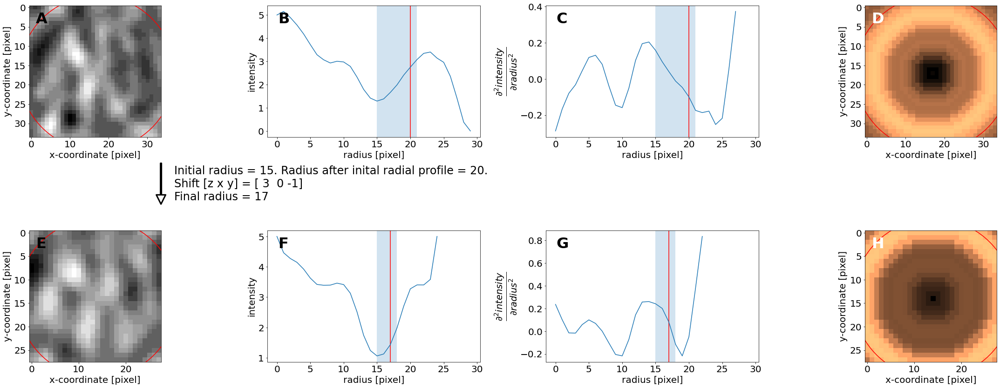

new image box shape is (16, 16, 16)
new centroid is [218 394 604]
new_optimal_radius is 8
missed 177
new image box shape is (22, 22, 22)
new centroid is [215 426 458]
new_optimal_radius is 13
alternative calc: 14
i is 178


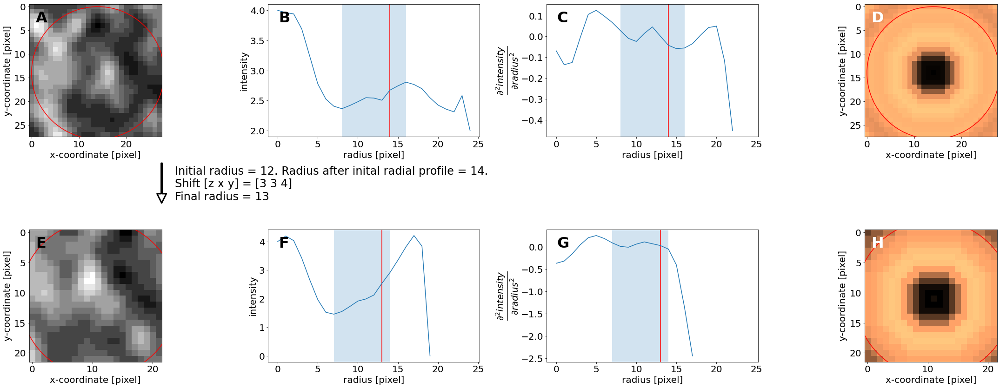

new image box shape is (26, 26, 26)
new centroid is [213 672 694]
new_optimal_radius is 14
alternative calc: 14
i is 179


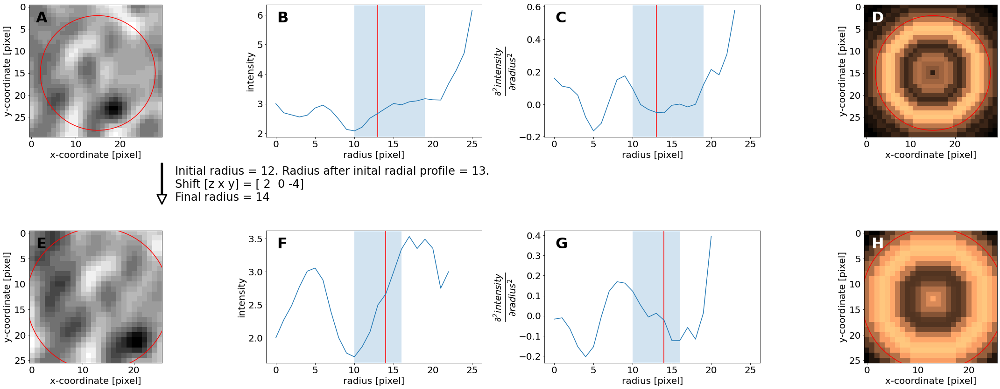

new image box shape is (40, 40, 40)
new centroid is [206 411 583]
new_optimal_radius is 16
alternative calc: 16
i is 180


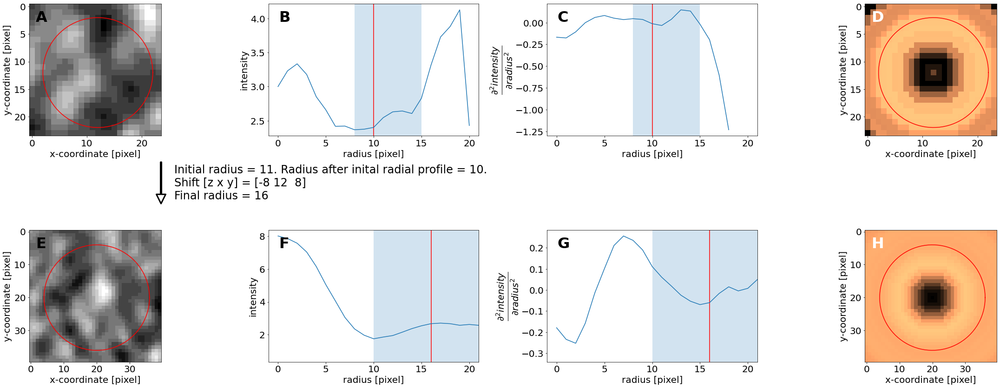

In [32]:
for i in range(centroids.shape[0]):
    try:
        make_figure(i)
    except ValueError:
        print(f"missed {i}")

In [ ]:
for i in (11,):
    make_figure(i, savefig=True)
